In [ ]:
pip install optuna

In [ ]:
pip install lime

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_score, roc_auc_score, recall_score,f1_score, precision_recall_curve, roc_curve, auc
import numpy as np
import xgboost as xgb
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import StandardScaler
from sklearn.utils.class_weight import compute_class_weight
import shap
import lime
import lime.lime_tabular
import matplotlib.pyplot as plt
import seaborn as sns
import optuna
from sklearn.base import BaseEstimator, ClassifierMixin
import numpy as np
from sklearn.model_selection import ShuffleSplit
from scipy import stats
from lime.lime_tabular import LimeTabularExplainer
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_predict

In [ ]:
!umount /content/gdrive
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


# Cardiac Arrest Dataset

In [ ]:
df_hip_cleaned = pd.read_csv("/content/gdrive/My Drive/OrthoAI/undersampled_CDARREST_HIP_21_22_23_N.csv")

In [ ]:
df_hip_cleaned.head()

,SEX,RACE_NEW,INOUT,Age,ASACLAS,CPT,ANESTHES,SMOKE,HXCOPD,HXCHF,...,OTHDVT,PULEMBOL,CDARREST,CDMI,REINTUB,FAILWEAN,OUPNEUMO,DIABETES,BMI,Year
0,0,6,1,1,2.0,3,2.0,1,0,0,...,0,0,0,0,0,0,0,0,28.83,2022
1,0,1,0,3,3.0,3,1.0,0,0,0,...,0,0,0,0,0,0,0,0,36.39,2022
2,1,1,0,2,3.0,3,3.0,0,0,1,...,0,0,0,0,0,0,0,0,35.53,2021
3,0,6,1,4,3.0,3,2.0,0,0,0,...,0,0,0,0,0,0,0,0,31.44,2021
4,0,1,1,3,2.0,3,1.0,0,0,0,...,0,0,0,0,0,0,0,0,24.37,2021


# CDMI Dataset

In [ ]:
df1_hip_cleaned = pd.read_csv("/content/gdrive/My Drive/OrthoAI/undersampled_CDMI_HIP_21_22_23_N.csv")

In [ ]:
df1_hip_cleaned.head()

,SEX,RACE_NEW,INOUT,Age,ASACLAS,CPT,ANESTHES,SMOKE,HXCOPD,HXCHF,...,OTHDVT,PULEMBOL,CDARREST,CDMI,REINTUB,FAILWEAN,OUPNEUMO,DIABETES,BMI,Year
0,0,1,1,4,3.0,3,3.0,0,0,0,...,0,0,0,0,0,0,0,0,26.92,2022
1,0,1,0,1,2.0,3,1.0,0,0,0,...,0,0,0,0,0,0,0,0,21.92,2021
2,1,1,1,3,3.0,3,3.0,0,0,0,...,0,0,0,0,0,0,0,0,26.61,2023
3,1,1,0,2,3.0,3,1.0,0,0,0,...,0,0,0,0,0,0,0,0,39.58,2023
4,0,6,0,3,2.0,3,1.0,0,0,0,...,0,0,0,0,0,0,0,0,29.29,2022


# Random Forest

## Cardiac Arrest

[I 2025-03-22 23:14:55,882] A new study created in memory with name: no-name-bccc5bbe-f78a-47c3-a479-69ebb9640315
[I 2025-03-22 23:14:57,075] Trial 0 finished with value: 0.9166532606728468 and parameters: {'n_estimators': 183, 'max_depth': 12, 'min_samples_split': 8, 'min_samples_leaf': 13, 'max_features': 'sqrt'}. Best is trial 0 with value: 0.9166532606728468.
[I 2025-03-22 23:14:58,443] Trial 1 finished with value: 0.9026624303726195 and parameters: {'n_estimators': 126, 'max_depth': 13, 'min_samples_split': 9, 'min_samples_leaf': 14, 'max_features': None}. Best is trial 0 with value: 0.9166532606728468.
[I 2025-03-22 23:15:00,629] Trial 2 finished with value: 0.9022049508335177 and parameters: {'n_estimators': 183, 'max_depth': 9, 'min_samples_split': 13, 'min_samples_leaf': 6, 'max_features': None}. Best is trial 0 with value: 0.9166532606728468.
[I 2025-03-22 23:15:01,816] Trial 3 finished with value: 0.9132146232580587 and parameters: {'n_estimators': 162, 'max_depth': 3, 'min_

Best hyperparameters:  {'n_estimators': 118, 'max_depth': 19, 'min_samples_split': 17, 'min_samples_leaf': 2, 'max_features': 'log2'}


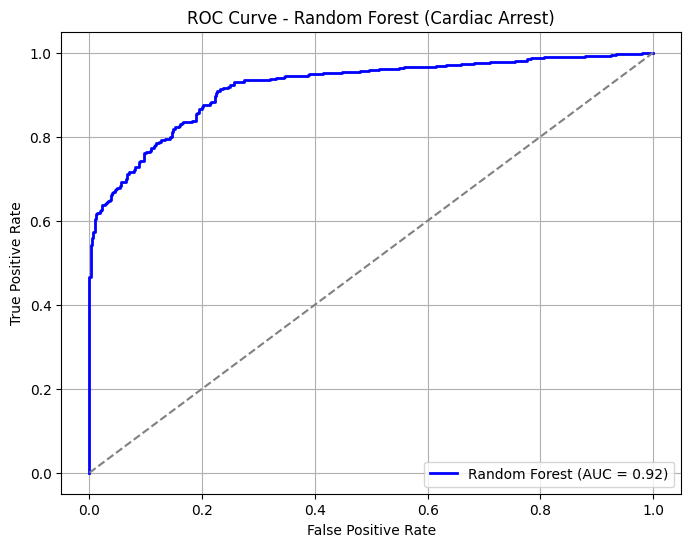

Random Forest Metrics for Cardiac Arrest: 
AUC Score: 0.9191
Accuracy: 0.8352
F1 Score: 0.8331
Recall: 0.8229
Precision: 0.8437


In [ ]:
# Define unique feature (X) and target (y) variables
X_RF_CA = df_hip_cleaned.drop(columns=['CDARREST', 'CDMI'])
y_RF_CA = df_hip_cleaned['CDARREST']

# Define the objective function for Optuna to optimize Random Forest hyperparameters
def objective(trial):
    n_estimators = trial.suggest_int('n_estimators', 50, 200)
    max_depth = trial.suggest_int('max_depth', 3, 20)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 20)
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None])

    rf_classifier_CA = RandomForestClassifier(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_features=max_features,
        class_weight='balanced',
        random_state=42
)

    kf_RF_CA = KFold(n_splits=5, shuffle=True, random_state=42)
    y_pred_prob_RF_CA = cross_val_predict(rf_classifier_CA, X_RF_CA, y_RF_CA, cv=kf_RF_CA, method="predict_proba")[:, 1]

    fpr_RF_CA, tpr_RF_CA, _ = roc_curve(y_RF_CA, y_pred_prob_RF_CA)
    roc_auc_RF_CA = auc(fpr_RF_CA, tpr_RF_CA)

    return roc_auc_RF_CA

# Create and optimize the study using Optuna
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)

# Print the best hyperparameters found
print('Best hyperparameters: ', study.best_params)

# Use the best hyperparameters for the final Random Forest model
best_params = study.best_params
rf_classifier_CA = RandomForestClassifier(**best_params, random_state=42)

# Perform K-Fold cross-validation with the optimized model
kf_RF_CA = KFold(n_splits=5, shuffle=True, random_state=42)
y_pred_prob_RF_CA = cross_val_predict(rf_classifier_CA, X_RF_CA, y_RF_CA, cv=kf_RF_CA, method="predict_proba")[:, 1]
y_pred_RF_CA = cross_val_predict(rf_classifier_CA, X_RF_CA, y_RF_CA, cv=kf_RF_CA, method="predict")

# Compute AUC (ROC curve)
fpr_RF_CA, tpr_RF_CA, _ = roc_curve(y_RF_CA, y_pred_prob_RF_CA)
roc_auc_RF_CA = auc(fpr_RF_CA, tpr_RF_CA)

# Compute additional metrics
accuracy_RF_CA = accuracy_score(y_RF_CA, y_pred_RF_CA)
f1_RF_CA = f1_score(y_RF_CA, y_pred_RF_CA)
recall_RF_CA = recall_score(y_RF_CA, y_pred_RF_CA)
precision_RF_CA = precision_score(y_RF_CA, y_pred_RF_CA)

# Plot ROC Curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_RF_CA, tpr_RF_CA, color='blue', lw=2, label=f'Random Forest (AUC = {roc_auc_RF_CA:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Random Forest (Cardiac Arrest)')
plt.legend(loc='lower right')
plt.grid()
plt.show()

# Print all metrics with unique variable names
print(f'Random Forest Metrics for Cardiac Arrest: ')
print(f'AUC Score: {roc_auc_RF_CA:.4f}')
print(f'Accuracy: {accuracy_RF_CA:.4f}')
print(f'F1 Score: {f1_RF_CA:.4f}')
print(f'Recall: {recall_RF_CA:.4f}')
print(f'Precision: {precision_RF_CA:.4f}')

In [ ]:
rf_classifier_CA.fit(X_RF_CA, y_RF_CA)

RandomForestClassifier(max_depth=19, max_features='log2', min_samples_leaf=2,
                       min_samples_split=17, n_estimators=118, random_state=42)

<ipython-input-63-8fad538703c5>:11: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values_RF_CA, X_RF_CA, feature_names=feature_names, plot_size=(2, 0.5), show=False)
/usr/local/lib/python3.11/dist-packages/shap/plots/_beeswarm.py:718: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  summary_legacy(
/usr/local/lib/python3.11/dist-packages/shap/plots/_beeswarm.py:738: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  summary_legacy(


<Figure size 1800x600 with 0 Axes>

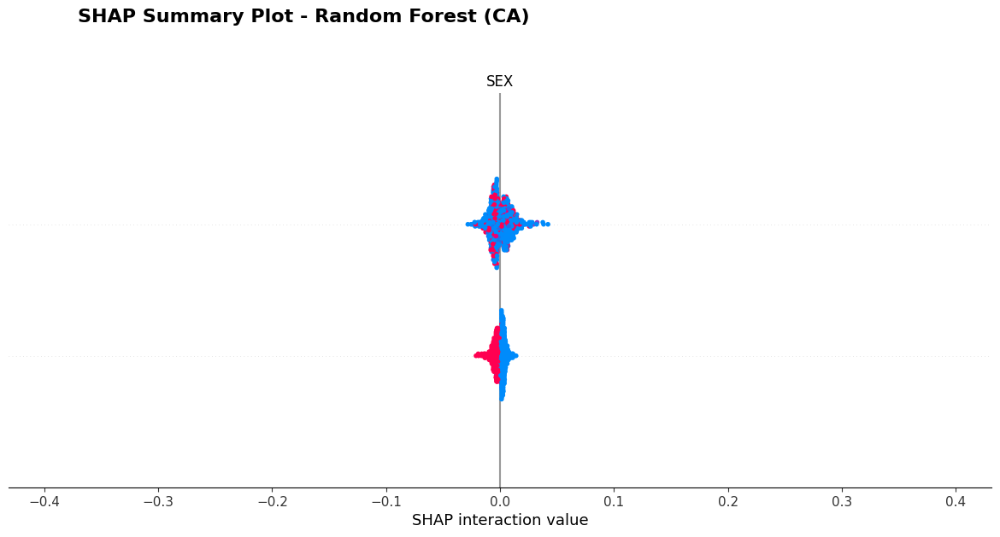

In [ ]:
explainer_RF_CA = shap.TreeExplainer(rf_classifier_CA)
shap_values_RF_CA = explainer_RF_CA.shap_values(X_RF_CA)

# Ensure feature names are correctly passed from the dataset
feature_names = X_RF_CA.columns

# Plot SHAP summary plot
plt.figure(figsize=(18, 6))
shap.summary_plot(shap_values_RF_CA, X_RF_CA, feature_names=feature_names, plot_size=(2, 0.5), show=False)

plt.suptitle("SHAP Summary Plot - Random Forest (CA)", fontsize=16, fontweight="bold", y=1.05)
plt.subplots_adjust(top=0.90, right=1.2, bottom=0.2, left=0.2)
plt.show()

/usr/local/lib/python3.11/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.11/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.11/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

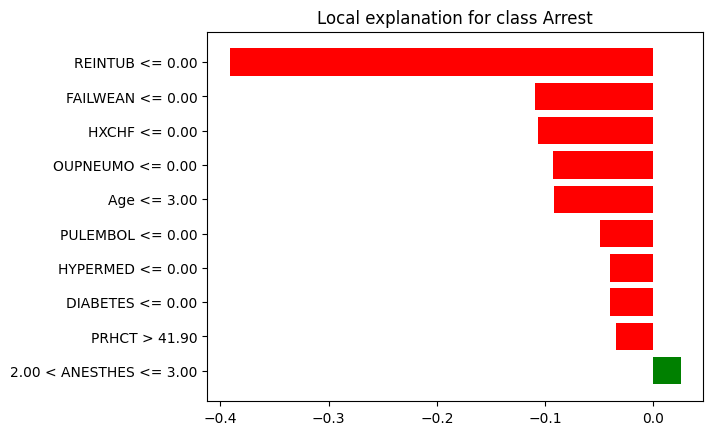

In [ ]:
# Initialize LIME Explainer for Cardiac Arrest (CA)
lime_explainer_RF_CA = LimeTabularExplainer(
    training_data=X_RF_CA.values,
    feature_names=X_RF_CA.columns.tolist(),
    class_names=['No Arrest', 'Arrest'],
    mode='classification'
)

# Randomly select an instance from the test data to explain
idx_RF_CA = np.random.randint(0, X_RF_CA.shape[0])
lime_exp_RF_CA = lime_explainer_RF_CA.explain_instance(
    X_RF_CA.iloc[idx_RF_CA],
    rf_classifier_CA.predict_proba
)


lime_exp_RF_CA.show_in_notebook()

fig = lime_exp_RF_CA.as_pyplot_figure()
plt.show()

## CDMI

[I 2025-03-22 23:15:47,827] A new study created in memory with name: no-name-c5600f87-9876-40fb-9504-6aadf4eca143
[I 2025-03-22 23:15:51,116] Trial 0 finished with value: 0.8266114198734258 and parameters: {'n_estimators': 164, 'max_depth': 4, 'min_samples_split': 11, 'min_samples_leaf': 14, 'max_features': None}. Best is trial 0 with value: 0.8266114198734258.
[I 2025-03-22 23:15:52,979] Trial 1 finished with value: 0.8552723459841441 and parameters: {'n_estimators': 168, 'max_depth': 16, 'min_samples_split': 5, 'min_samples_leaf': 8, 'max_features': 'sqrt'}. Best is trial 1 with value: 0.8552723459841441.
[I 2025-03-22 23:15:53,651] Trial 2 finished with value: 0.8538662108292232 and parameters: {'n_estimators': 59, 'max_depth': 12, 'min_samples_split': 18, 'min_samples_leaf': 9, 'max_features': 'sqrt'}. Best is trial 1 with value: 0.8552723459841441.
[I 2025-03-22 23:15:57,595] Trial 3 finished with value: 0.8525261603552126 and parameters: {'n_estimators': 115, 'max_depth': 12, 'mi

Best hyperparameters:  {'n_estimators': 126, 'max_depth': 14, 'min_samples_split': 16, 'min_samples_leaf': 1, 'max_features': 'log2'}


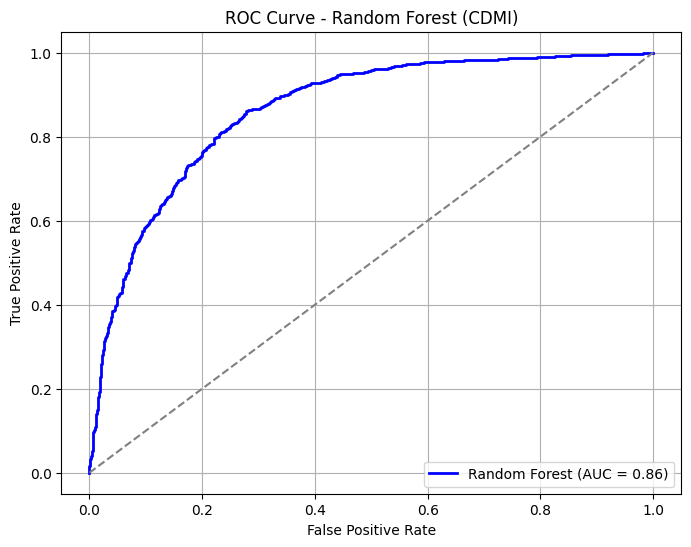

Random Forest Metrics for CDMI: 
AUC Score: 0.8647
Accuracy: 0.7862
F1 Score: 0.7959
Recall: 0.8338
Precision: 0.7613


In [ ]:
# Define unique feature (X) and target (y) variables for CDMI
X_RF_CDMI = df1_hip_cleaned.drop(columns=['CDARREST', 'CDMI'])
y_RF_CDMI = df1_hip_cleaned['CDMI']

# Define the objective function for Optuna to optimize Random Forest hyperparameters
def objective(trial):
    n_estimators = trial.suggest_int('n_estimators', 50, 200)
    max_depth = trial.suggest_int('max_depth', 3, 20)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 20)
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None])

    # Initialize Random Forest classifier with suggested hyperparameters
    rf_classifier_CDMI = RandomForestClassifier(
      n_estimators=n_estimators,
      max_depth=max_depth,
      min_samples_split=min_samples_split,
      min_samples_leaf=min_samples_leaf,
      max_features=max_features,
      class_weight='balanced',
      random_state=42
  )

    # Perform K-Fold cross-validation (K=5)
    kf_RF_CDMI = KFold(n_splits=5, shuffle=True, random_state=42)
    y_pred_prob_RF_CDMI = cross_val_predict(rf_classifier_CDMI, X_RF_CDMI, y_RF_CDMI, cv=kf_RF_CDMI, method="predict_proba")[:, 1]

    # Compute AUC (ROC curve)
    fpr_RF_CDMI, tpr_RF_CDMI, _ = roc_curve(y_RF_CDMI, y_pred_prob_RF_CDMI)
    roc_auc_RF_CDMI = auc(fpr_RF_CDMI, tpr_RF_CDMI)

    return roc_auc_RF_CDMI

# Create and optimize the study using Optuna
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)

# Print the best hyperparameters found
print('Best hyperparameters: ', study.best_params)

# Use the best hyperparameters for the final Random Forest model
best_params = study.best_params
rf_classifier_CDMI = RandomForestClassifier(**best_params, random_state=42)

# Perform K-Fold cross-validation with the optimized model
kf_RF_CDMI = KFold(n_splits=5, shuffle=True, random_state=42)
y_pred_prob_RF_CDMI = cross_val_predict(rf_classifier_CDMI, X_RF_CDMI, y_RF_CDMI, cv=kf_RF_CDMI, method="predict_proba")[:, 1]
y_pred_RF_CDMI = cross_val_predict(rf_classifier_CDMI, X_RF_CDMI, y_RF_CDMI, cv=kf_RF_CDMI, method="predict")

# Compute AUC (ROC curve)
fpr_RF_CDMI, tpr_RF_CDMI, _ = roc_curve(y_RF_CDMI, y_pred_prob_RF_CDMI)
roc_auc_RF_CDMI = auc(fpr_RF_CDMI, tpr_RF_CDMI)

# Compute additional metrics
accuracy_RF_CDMI = accuracy_score(y_RF_CDMI, y_pred_RF_CDMI)
f1_RF_CDMI = f1_score(y_RF_CDMI, y_pred_RF_CDMI)
recall_RF_CDMI = recall_score(y_RF_CDMI, y_pred_RF_CDMI)
precision_RF_CDMI = precision_score(y_RF_CDMI, y_pred_RF_CDMI)


# Plot ROC Curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_RF_CDMI, tpr_RF_CDMI, color='blue', lw=2, label=f'Random Forest (AUC = {roc_auc_RF_CDMI:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Random Forest (CDMI)')
plt.legend(loc='lower right')
plt.grid()
plt.show()

# Print all metrics with unique variable names
print(f'Random Forest Metrics for CDMI: ')
print(f'AUC Score: {roc_auc_RF_CDMI:.4f}')
print(f'Accuracy: {accuracy_RF_CDMI:.4f}')
print(f'F1 Score: {f1_RF_CDMI:.4f}')
print(f'Recall: {recall_RF_CDMI:.4f}')
print(f'Precision: {precision_RF_CDMI:.4f}')

In [ ]:
rf_classifier_CDMI.fit(X_RF_CDMI, y_RF_CDMI)

RandomForestClassifier(max_depth=14, max_features='log2', min_samples_split=16,
                       n_estimators=126, random_state=42)

<ipython-input-67-a01b2975fabc>:11: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values_RF_CDMI, X_RF_CDMI, feature_names=feature_names, plot_size=(2, 0.5), show=False)
/usr/local/lib/python3.11/dist-packages/shap/plots/_beeswarm.py:718: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  summary_legacy(
/usr/local/lib/python3.11/dist-packages/shap/plots/_beeswarm.py:738: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  summary_legacy(


<Figure size 1800x600 with 0 Axes>

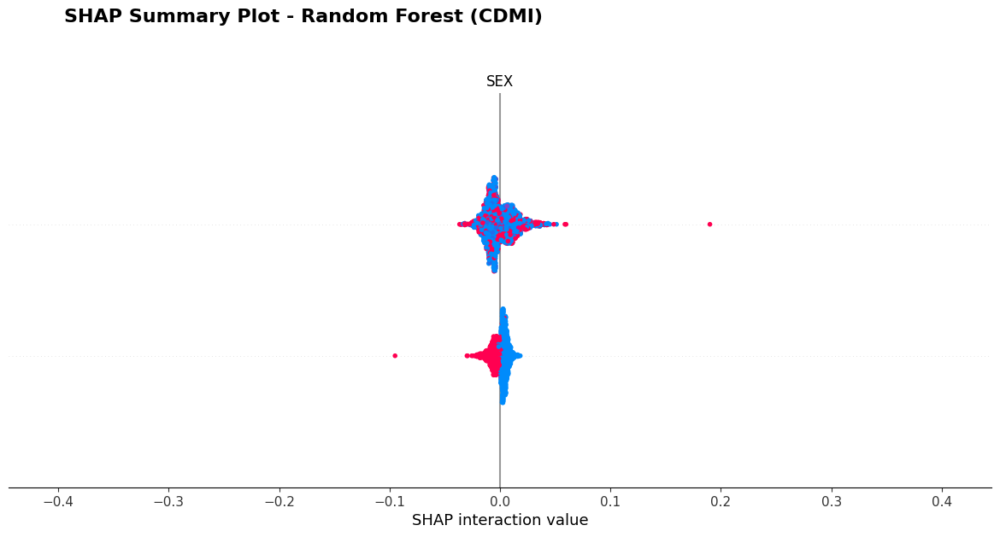

In [ ]:
explainer_RF_CDMI = shap.TreeExplainer(rf_classifier_CDMI)
shap_values_RF_CDMI = explainer_RF_CDMI.shap_values(X_RF_CDMI)


feature_names = X_RF_CDMI.columns

# Plot SHAP summary plot
plt.figure(figsize=(18, 6))
shap.summary_plot(shap_values_RF_CDMI, X_RF_CDMI, feature_names=feature_names, plot_size=(2, 0.5), show=False)

# Add title above the plot for better positioning
plt.suptitle("SHAP Summary Plot - Random Forest (CDMI)", fontsize=16, fontweight="bold", y=1.05)

# Adjust layout and margins to prevent overlap
plt.subplots_adjust(top=0.90, right=1.2, bottom=0.2, left=0.2)

# Show the plot
plt.show()

/usr/local/lib/python3.11/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.11/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.11/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

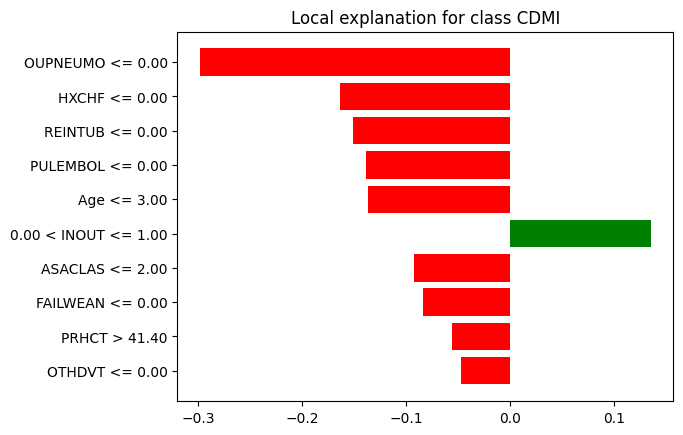

In [ ]:
# Initialize LIME Explainer for CDMI
lime_explainer_RF_CDMI = LimeTabularExplainer(
    training_data=X_RF_CDMI.values,
    feature_names=X_RF_CDMI.columns.tolist(),
    class_names=['No CDMI', 'CDMI'],
    mode='classification'
)

# Randomly select an instance from the test data to explain
idx_RF_CDMI = np.random.randint(0, X_RF_CDMI.shape[0])
lime_exp_RF_CDMI = lime_explainer_RF_CDMI.explain_instance(
    X_RF_CDMI.iloc[idx_RF_CDMI],
    rf_classifier_CDMI.predict_proba
)


lime_exp_RF_CDMI.show_in_notebook()

fig = lime_exp_RF_CDMI.as_pyplot_figure()
plt.show()

## Combined

In [ ]:
from sklearn.model_selection import cross_val_score, StratifiedKFold

[I 2025-03-22 23:17:33,806] A new study created in memory with name: no-name-0ce50e5d-8eef-4426-96e2-be0b17e254b8
[I 2025-03-22 23:17:34,236] Trial 0 finished with value: 0.9130939693136801 and parameters: {'n_estimators': 63, 'max_depth': 14, 'min_samples_split': 2, 'min_samples_leaf': 20, 'max_features': 'log2'}. Best is trial 0 with value: 0.9130939693136801.
[I 2025-03-22 23:17:35,499] Trial 1 finished with value: 0.901933479458666 and parameters: {'n_estimators': 87, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': None}. Best is trial 0 with value: 0.9130939693136801.
[I 2025-03-22 23:17:37,037] Trial 2 finished with value: 0.9158790645297512 and parameters: {'n_estimators': 159, 'max_depth': 20, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 'sqrt'}. Best is trial 2 with value: 0.9158790645297512.
[I 2025-03-22 23:17:38,279] Trial 3 finished with value: 0.9146323071045065 and parameters: {'n_estimators': 154, 'max_depth': 5, 'min_s

Best RF Hyperparameters: {'n_estimators': 136, 'max_depth': 11, 'min_samples_split': 16, 'min_samples_leaf': 1, 'max_features': 'log2'}
Combined Model Metrics:
Accuracy: 0.8661
F1 Score: 0.8694
Recall: 0.8915
Precision: 0.8484
AUC Score: 0.9461


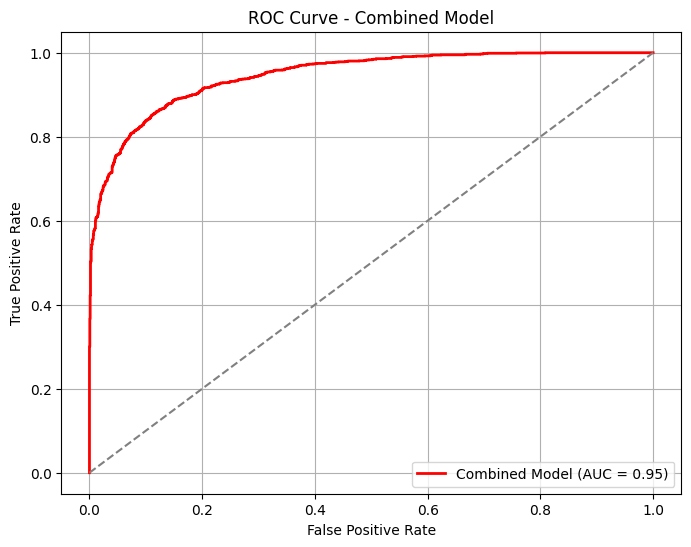

In [ ]:
# Load Data & Drop Targets
X_RF_CA_resampled = df_hip_cleaned.drop(columns=['CDARREST', 'CDMI'])
y_RF_CA_resampled = df_hip_cleaned['CDARREST']

X_RF_CDMI_resampled = df1_hip_cleaned.drop(columns=['CDMI', 'CDARREST'])
y_RF_CDMI_resampled = df1_hip_cleaned['CDMI']

common_columns = X_RF_CA_resampled.columns.intersection(X_RF_CDMI_resampled.columns)

# Combine features & targets
X_RF_Combined = np.concatenate((X_RF_CA_resampled[common_columns], X_RF_CDMI_resampled[common_columns]), axis=0)
y_RF_Combined = np.concatenate((y_RF_CA_resampled, y_RF_CDMI_resampled), axis=0)

# Convert to DataFrame
X_RF_Combined_df = pd.DataFrame(X_RF_Combined, columns=common_columns)

# Optimize Random Forest with Optuna
def objective(trial):
    n_estimators = trial.suggest_int('n_estimators', 50, 200)
    max_depth = trial.suggest_int('max_depth', 3, 20)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 20)
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None])

    rf_classifier_CA = RandomForestClassifier(
        n_estimators=n_estimators, max_depth=max_depth,
        min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf,
        max_features=max_features, class_weight='balanced', random_state=42
    )

    kf_RF_CA = KFold(n_splits=5, shuffle=True, random_state=42)
    y_pred_prob_RF_CA = cross_val_predict(rf_classifier_CA, X_RF_CA_resampled, y_RF_CA_resampled, cv=kf_RF_CA, method="predict_proba")[:, 1]

    fpr_RF_CA, tpr_RF_CA, _ = roc_curve(y_RF_CA_resampled, y_pred_prob_RF_CA)
    return auc(fpr_RF_CA, tpr_RF_CA)

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)

best_params = study.best_params
print('Best RF Hyperparameters:', best_params)

rf_classifier_CA = RandomForestClassifier(**best_params, random_state=42)
rf_classifier_CDMI = RandomForestClassifier(**best_params, random_state=42)

# Train Voting Classifier
voting_classifier_RF_Combined = VotingClassifier(
    estimators=[('rf_CA', rf_classifier_CA), ('rf_CDMI', rf_classifier_CDMI)],
    voting='soft'
)

voting_classifier_RF_Combined.fit(X_RF_Combined, y_RF_Combined)

# Evaluate Model
y_pred_combined_labels = voting_classifier_RF_Combined.predict(X_RF_Combined)
y_pred_combined_prob = voting_classifier_RF_Combined.predict_proba(X_RF_Combined)[:, 1]

accuracy_combined = accuracy_score(y_RF_Combined, y_pred_combined_labels)
f1_combined = f1_score(y_RF_Combined, y_pred_combined_labels)
recall_combined = recall_score(y_RF_Combined, y_pred_combined_labels)
precision_combined = precision_score(y_RF_Combined, y_pred_combined_labels)

fpr_combined, tpr_combined, _ = roc_curve(y_RF_Combined, y_pred_combined_prob)
roc_auc_combined = auc(fpr_combined, tpr_combined)

print(f'Combined Model Metrics:')
print(f'Accuracy: {accuracy_combined:.4f}')
print(f'F1 Score: {f1_combined:.4f}')
print(f'Recall: {recall_combined:.4f}')
print(f'Precision: {precision_combined:.4f}')
print(f'AUC Score: {roc_auc_combined:.4f}')

plt.figure(figsize=(8, 6))
plt.plot(fpr_combined, tpr_combined, color='red', lw=2, label=f'Combined Model (AUC = {roc_auc_combined:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Combined Model')
plt.legend(loc='lower right')
plt.grid()
plt.show()

<ipython-input-71-5d57f126a85a>:53: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(


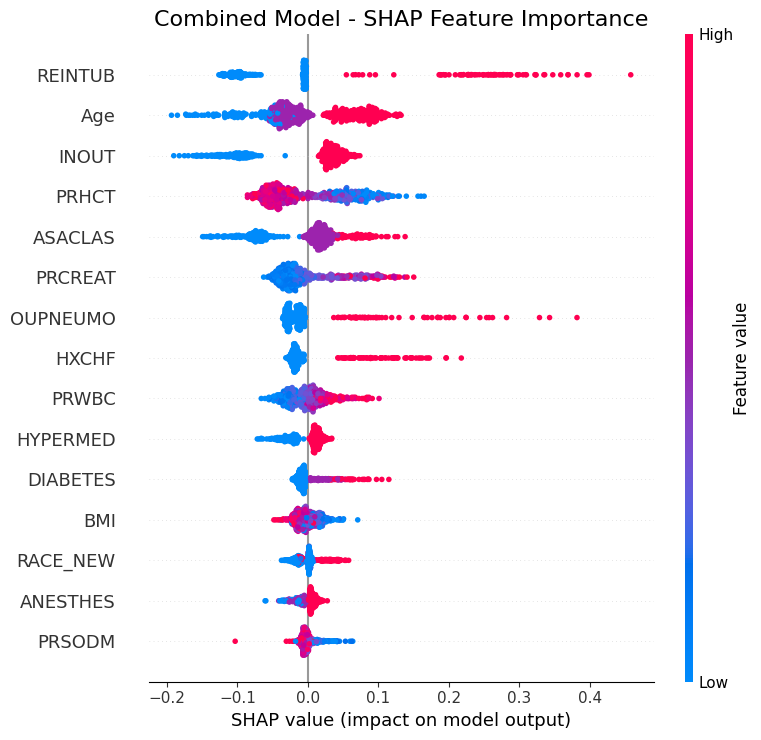

<ipython-input-71-5d57f126a85a>:68: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(


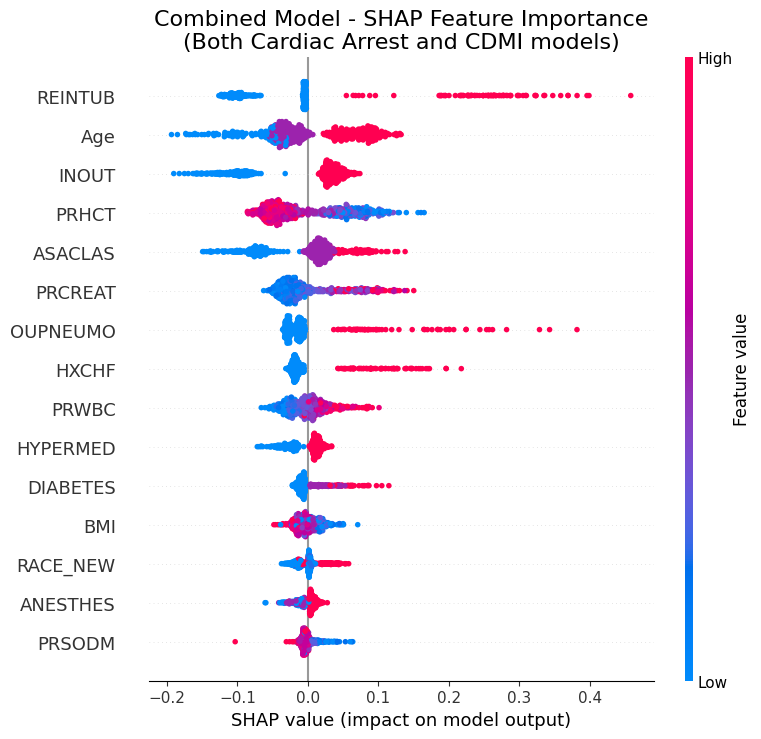

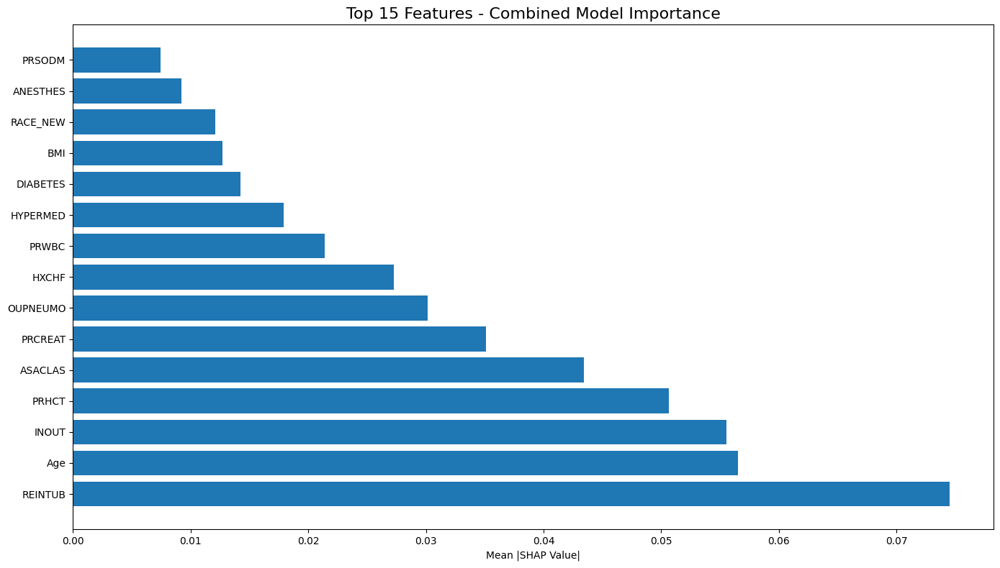

In [ ]:
# First, ensure your models are trained
rf_classifier_CA.fit(X_RF_CA_resampled, y_RF_CA_resampled)
rf_classifier_CDMI.fit(X_RF_CDMI_resampled, y_RF_CDMI_resampled)

sample_size_CA = min(300, len(X_RF_CA_resampled))
sample_size_CDMI = min(300, len(X_RF_CDMI_resampled))

# Randomly sample from each dataset
np.random.seed(42)
CA_indices = np.random.choice(len(X_RF_CA_resampled), sample_size_CA, replace=False)
CDMI_indices = np.random.choice(len(X_RF_CDMI_resampled), sample_size_CDMI, replace=False)

# Create sampled datasets
X_CA_sample = X_RF_CA_resampled.iloc[CA_indices][common_columns]
X_CDMI_sample = X_RF_CDMI_resampled.iloc[CDMI_indices][common_columns]

# Get SHAP values for samples
explainer_CA = shap.TreeExplainer(rf_classifier_CA)
explainer_CDMI = shap.TreeExplainer(rf_classifier_CDMI)

# Get SHAP values
shap_values_CA = explainer_CA.shap_values(X_CA_sample)
shap_values_CDMI = explainer_CDMI.shap_values(X_CDMI_sample)

# Handle different SHAP value formats
if isinstance(shap_values_CA, list) and len(shap_values_CA) > 1:
    shap_values_CA = shap_values_CA[1]
    shap_values_CDMI = shap_values_CDMI[1]
elif isinstance(shap_values_CA, np.ndarray) and len(shap_values_CA.shape) == 3:
    shap_values_CA = shap_values_CA[:, :, 1]
    shap_values_CDMI = shap_values_CDMI[:, :, 1]

X_combined = pd.concat([X_CA_sample, X_CDMI_sample], axis=0)
shap_values_combined = np.vstack([shap_values_CA, shap_values_CDMI])

source_labels = np.concatenate([
    np.full(len(X_CA_sample), "Cardiac Arrest"),
    np.full(len(X_CDMI_sample), "CDMI")
])

X_combined_with_source = X_combined.copy()
X_combined_with_source['Source'] = source_labels

plt.figure(figsize=(14, 10))
shap.summary_plot(
    shap_values_combined,
    X_combined,
    plot_type="dot",
    max_display=15,  # Show top 15 features
    title="Combined SHAP Values Beeswarm Plot",
    show=False
)
plt.title("Combined Model - SHAP Feature Importance", fontsize=16)
plt.tight_layout()
plt.show()

plt.figure(figsize=(14, 10))

shap.summary_plot(
    shap_values_combined,
    X_combined.values,
    feature_names=X_combined.columns,
    plot_type="dot",
    max_display=15,
    show=False
)
plt.title("Combined Model - SHAP Feature Importance\n(Both Cardiac Arrest and CDMI models)", fontsize=16)
plt.tight_layout()
plt.show()


plt.figure(figsize=(14, 8))
combined_importance = np.mean(np.abs(shap_values_combined), axis=0)
idx = np.argsort(combined_importance)
idx = idx[-15:]

plt.barh(X_combined.columns[idx], combined_importance[idx])
plt.title("Top 15 Features - Combined Model Importance", fontsize=16)
plt.xlabel("Mean |SHAP Value|")
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

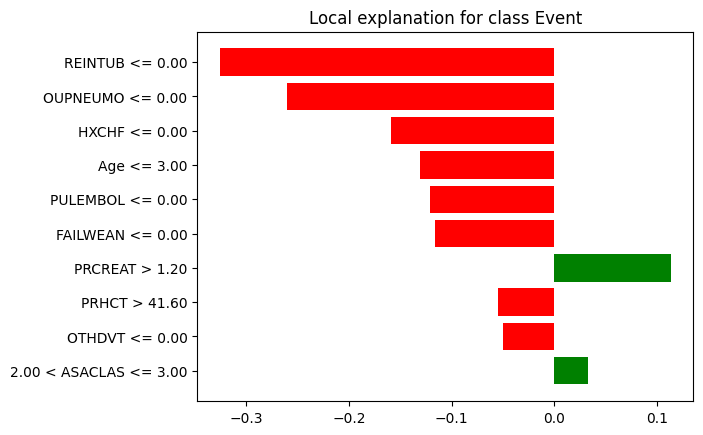

In [ ]:
# LIME Explanation
explainer_LIME = LimeTabularExplainer(
    training_data=X_RF_Combined_df.values,
    training_labels=y_RF_Combined,
    mode="classification",
    feature_names=X_RF_Combined_df.columns,
    class_names=["No Event", "Event"],
    discretize_continuous=True
)

instance_to_explain_RF = X_RF_Combined_df.iloc[10]

def predict_combined(X):
    return voting_classifier_RF_Combined.predict_proba(X)

explanation_RF = explainer_LIME.explain_instance(
    instance_to_explain_RF.values, predict_combined, num_features=10
)

explanation_RF.show_in_notebook(show_table=True, show_all=False)
explanation_RF.as_pyplot_figure()
plt.show()

# XGBoost

## Cardiac Arrest

In [ ]:
from sklearn.model_selection import StratifiedKFold

In [ ]:
# Define feature matrix and target variable for XGBoost (Cardiac Arrest)
X_XG_CA = df_hip_cleaned.drop(columns=['CDARREST', 'CDMI'])
y_XG_CA = df_hip_cleaned['CDARREST']

[I 2025-03-22 23:18:44,850] A new study created in memory with name: no-name-b6b526f9-7ee5-493b-af35-b2db505b0508
<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_by

Training fold 1
Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:18:45,793] Trial 0 finished with value: 0.897825470970276 and parameters: {'max_depth': 10, 'learning_rate': 0.001858868556624477, 'n_estimators': 190, 'subsample': 0.5178728133034693, 'colsample_bytree': 0.9315835589525432}. Best is trial 0 with value: 0.897825470970276.
<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uni

Training fold 1
Training fold 2
Training fold 3


[I 2025-03-22 23:18:46,223] Trial 1 finished with value: 0.9045103732693682 and parameters: {'max_depth': 6, 'learning_rate': 0.009696765223876138, 'n_estimators': 115, 'subsample': 0.9273548553866422, 'colsample_bytree': 0.55885854314386}. Best is trial 1 with value: 0.9045103732693682.


Training fold 4
Training fold 5
Training fold 1


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:18:46,696] Trial 2 finished with value: 0.9029036737785633 and parameters: {'max_depth': 7, 'learning_rate': 0.0007867225630093559, 'n_estimators': 113, 'subsample': 0.8182381576797995, 'colsample_bytree': 0.5507558727524025}. Best is trial 1 with value: 0.9045103732693682.


Training fold 5
Training fold 1
Training fold 2


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree
[I 2025-03-22 23:18:47,004] T

Training fold 3
Training fold 4
Training fold 5
Training fold 1


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:18:47,433] Trial 4 finished with value: 0.8936817741867611 and parameters: {'max_depth': 10, 'learning_rate': 0.0005306029627066162, 'n_estimators': 61, 'subsample': 0.6804187842030607, 'colsample_bytree': 0.8962392882116004}. Best is trial 3 with value: 0.9073639691958085.


Training fold 5
Training fold 1


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:18:49,433] Trial 5 finished with value: 0.9011844744631008 and parameters: {'max_depth': 10, 'learning_rate': 0.002464463059860544, 'n_estimators': 127, 'subsample': 0.8078204575152872, 'colsample_bytree': 0.642876121175765}. Best is trial 3 with value: 0.9073639691958085.
<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_un

Training fold 1
Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:18:49,690] Trial 6 finished with value: 0.9036749007560774 and parameters: {'max_depth': 3, 'learning_rate': 0.0029606459934749642, 'n_estimators': 61, 'subsample': 0.6759168214861286, 'colsample_bytree': 0.8343373150425062}. Best is trial 3 with value: 0.9073639691958085.
<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_un

Training fold 1
Training fold 2
Training fold 3


[I 2025-03-22 23:18:50,029] Trial 7 finished with value: 0.9021320259787625 and parameters: {'max_depth': 3, 'learning_rate': 1.2705495406782186e-05, 'n_estimators': 146, 'subsample': 0.8916621980732773, 'colsample_bytree': 0.7479653532417931}. Best is trial 3 with value: 0.9073639691958085.


Training fold 4
Training fold 5
Training fold 1


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:18:50,746] Trial 8 finished with value: 0.8911083056291995 and parameters: {'max_depth': 7, 'learning_rate': 0.0006667459895215518, 'n_estimators': 182, 'subsample': 0.7631908314088302, 'colsample_bytree': 0.9343188973813157}. Best is trial 3 with value: 0.9073639691958085.
<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_u

Training fold 1
Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:18:51,399] Trial 9 finished with value: 0.9029704442480607 and parameters: {'max_depth': 9, 'learning_rate': 0.0009195129881564168, 'n_estimators': 160, 'subsample': 0.7578178151460478, 'colsample_bytree': 0.6447601925638429}. Best is trial 3 with value: 0.9073639691958085.


Training fold 5
Training fold 1


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:18:51,780] Trial 10 finished with value: 0.887800923003549 and parameters: {'max_depth': 5, 'learning_rate': 0.07464305414338962, 'n_estimators': 89, 'subsample': 0.9966309363019623, 'colsample_bytree': 0.7438805266364247}. Best is trial 3 with value: 0.9073639691958085.


Training fold 5
Training fold 1
Training fold 2


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:18:52,139] Trial 11 finished with value: 0.9045535776908078 and parameters: {'max_depth': 5, 'learning_rate': 0.020545394244530273, 'n_estimators': 101, 'subsample': 0.9901344101758325, 'colsample_bytree': 0.5133879144553114}. Best is trial 3 with value: 0.9073639691958085.
<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_u

Training fold 1
Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:18:52,456] Trial 12 finished with value: 0.9049460646102485 and parameters: {'max_depth': 4, 'learning_rate': 0.026402810979857062, 'n_estimators': 89, 'subsample': 0.976517245743326, 'colsample_bytree': 0.5085872139682857}. Best is trial 3 with value: 0.9073639691958085.


Training fold 5
Training fold 1
Training fold 2
Training fold 3


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree
[I 2025-03-22 23:18:52,781] T

Training fold 4
Training fold 5
Training fold 1


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:18:53,188] Trial 14 finished with value: 0.9058902495476161 and parameters: {'max_depth': 4, 'learning_rate': 0.00010486812165614135, 'n_estimators': 141, 'subsample': 0.8729277898264732, 'colsample_bytree': 0.639787951193578}. Best is trial 3 with value: 0.9073639691958085.


Training fold 5
Training fold 1
Training fold 2
Training fold 3


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree
[I 2025-03-22 23:18:53,462] T

Training fold 4
Training fold 5
Training fold 1


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:18:54,013] Trial 16 finished with value: 0.905243024870597 and parameters: {'max_depth': 5, 'learning_rate': 0.00011552389346537208, 'n_estimators': 162, 'subsample': 0.9254426365076911, 'colsample_bytree': 0.6899679541123971}. Best is trial 3 with value: 0.9073639691958085.
<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_

Training fold 1
Training fold 2
Training fold 3


[I 2025-03-22 23:18:54,370] Trial 17 finished with value: 0.9079395138099848 and parameters: {'max_depth': 4, 'learning_rate': 1.689435372801539e-05, 'n_estimators': 126, 'subsample': 0.6818997280475063, 'colsample_bytree': 0.5711871923306411}. Best is trial 17 with value: 0.9079395138099848.


Training fold 4
Training fold 5
Training fold 1


<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training fold 4
Training fold 5


[I 2025-03-22 23:18:55,000] Trial 18 finished with value: 0.8914300944044664 and parameters: {'max_depth': 8, 'learning_rate': 1.0501440294494762e-05, 'n_estimators': 133, 'subsample': 0.6314247364705327, 'colsample_bytree': 0.997511161146446}. Best is trial 17 with value: 0.9079395138099848.
<ipython-input-76-93c00c968cea>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-76-93c00c968cea>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-76-93c00c968cea>:11: FutureWarning: suggest

Training fold 1
Training fold 2
Training fold 3


[I 2025-03-22 23:18:55,515] Trial 19 finished with value: 0.9067873023888678 and parameters: {'max_depth': 6, 'learning_rate': 4.474079352388897e-05, 'n_estimators': 159, 'subsample': 0.5926256157484004, 'colsample_bytree': 0.5723814349838557}. Best is trial 17 with value: 0.9079395138099848.


Training fold 4
Training fold 5
Best hyperparameters: {'max_depth': 4, 'learning_rate': 1.689435372801539e-05, 'n_estimators': 126, 'subsample': 0.6818997280475063, 'colsample_bytree': 0.5711871923306411}
Training fold 1
Training fold 2
Training fold 3
Training fold 4
Training fold 5

Average accuracy from 5-fold cross-validation: 0.7312
Average precision: 0.8156
Average recall: 0.7184
Average F1 score: 0.7139
Average AUC-ROC: 0.9079


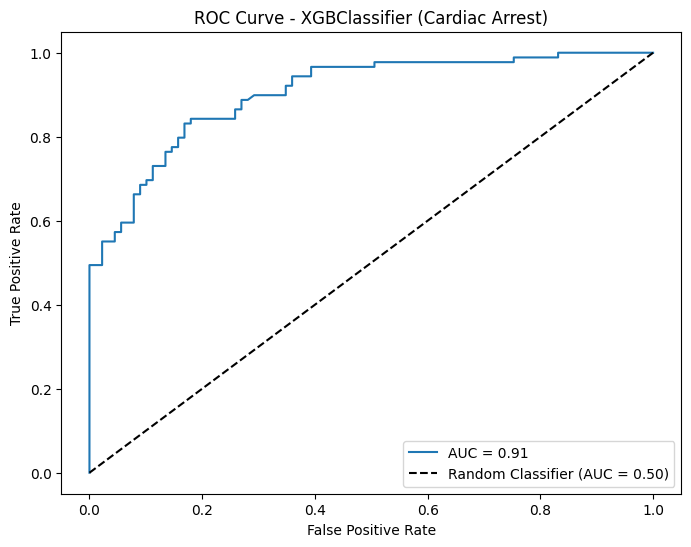

In [ ]:
# Define objective function for Optuna
def objective_XG_CA(trial):
    param = {
        'objective': 'binary:logistic',
        'eval_metric': 'logloss',
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),
        'n_estimators': trial.suggest_int('n_estimators', 50, 200),
        'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),
        'verbosity': 0
    }

    # Initialize StratifiedKFold with 5 splits
    kf_XG_CA = StratifiedKFold(n_splits=5, shuffle=False)

    # Store metrics for each fold
    fold_accuracies_XG_CA = []
    fold_precisions_XG_CA = []
    fold_recalls_XG_CA = []
    fold_f1_scores_XG_CA = []
    fold_roc_auc_XG_CA = []

    # Loop over each split
    for fold_idx, (train_index, test_index) in enumerate(kf_XG_CA.split(X_XG_CA, y_XG_CA)):
        print(f"Training fold {fold_idx + 1}")

        X_train_XG_CA, X_test_XG_CA = X_XG_CA.iloc[train_index], X_XG_CA.iloc[test_index]
        y_train_XG_CA, y_test_XG_CA = y_XG_CA.iloc[train_index], y_XG_CA.iloc[test_index]

        xgb_classifier_XG_CA = xgb.XGBClassifier(**param)

        xgb_classifier_XG_CA.fit(X_train_XG_CA, y_train_XG_CA)

        y_pred_XG_CA = xgb_classifier_XG_CA.predict(X_test_XG_CA)
        y_pred_prob_XG_CA = xgb_classifier_XG_CA.predict_proba(X_test_XG_CA)[:, 1]

        accuracy_XG_CA = accuracy_score(y_test_XG_CA, y_pred_XG_CA)
        precision_XG_CA = precision_score(y_test_XG_CA, y_pred_XG_CA)
        recall_XG_CA = recall_score(y_test_XG_CA, y_pred_XG_CA)
        f1_XG_CA = f1_score(y_test_XG_CA, y_pred_XG_CA)
        roc_auc_XG_CA = roc_auc_score(y_test_XG_CA, y_pred_prob_XG_CA)

        fold_accuracies_XG_CA.append(accuracy_XG_CA)
        fold_precisions_XG_CA.append(precision_XG_CA)
        fold_recalls_XG_CA.append(recall_XG_CA)
        fold_f1_scores_XG_CA.append(f1_XG_CA)
        fold_roc_auc_XG_CA.append(roc_auc_XG_CA)

    avg_accuracy_XG_CA = np.mean(fold_accuracies_XG_CA)
    avg_precision_XG_CA = np.mean(fold_precisions_XG_CA)
    avg_recall_XG_CA = np.mean(fold_recalls_XG_CA)
    avg_f1_XG_CA = np.mean(fold_f1_scores_XG_CA)
    avg_roc_auc_XG_CA = np.mean(fold_roc_auc_XG_CA)

    return avg_roc_auc_XG_CA

# Run Optuna optimization to find the best hyperparameters
study_XG_CA = optuna.create_study(direction='maximize')
study_XG_CA.optimize(objective_XG_CA, n_trials=20)

# Print the best hyperparameters
print("Best hyperparameters:", study_XG_CA.best_params)

# Now using the best hyperparameters found by Optuna to train the model
best_params_XG_CA = study_XG_CA.best_params

# Initialize StratifiedKFold with 5 splits
kf_XG_CA = StratifiedKFold(n_splits=5, shuffle=False)

# Store metrics for each fold
fold_accuracies_XG_CA = []
fold_precisions_XG_CA = []
fold_recalls_XG_CA = []
fold_f1_scores_XG_CA = []
fold_roc_auc_XG_CA = []

# Loop over each split
for fold_idx, (train_index, test_index) in enumerate(kf_XG_CA.split(X_XG_CA, y_XG_CA)):
    print(f"Training fold {fold_idx + 1}")

    X_train_XG_CA, X_test_XG_CA = X_XG_CA.iloc[train_index], X_XG_CA.iloc[test_index]
    y_train_XG_CA, y_test_XG_CA = y_XG_CA.iloc[train_index], y_XG_CA.iloc[test_index]

    xgb_classifier_XG_CA = xgb.XGBClassifier(**best_params_XG_CA)

    xgb_classifier_XG_CA.fit(X_train_XG_CA, y_train_XG_CA)

    y_pred_XG_CA = xgb_classifier_XG_CA.predict(X_test_XG_CA)
    y_pred_prob_XG_CA = xgb_classifier_XG_CA.predict_proba(X_test_XG_CA)[:, 1]

    accuracy_XG_CA = accuracy_score(y_test_XG_CA, y_pred_XG_CA)
    precision_XG_CA = precision_score(y_test_XG_CA, y_pred_XG_CA)
    recall_XG_CA = recall_score(y_test_XG_CA, y_pred_XG_CA)
    f1_XG_CA = f1_score(y_test_XG_CA, y_pred_XG_CA)
    roc_auc_XG_CA = roc_auc_score(y_test_XG_CA, y_pred_prob_XG_CA)

    fold_accuracies_XG_CA.append(accuracy_XG_CA)
    fold_precisions_XG_CA.append(precision_XG_CA)
    fold_recalls_XG_CA.append(recall_XG_CA)
    fold_f1_scores_XG_CA.append(f1_XG_CA)
    fold_roc_auc_XG_CA.append(roc_auc_XG_CA)

avg_accuracy_XG_CA = np.mean(fold_accuracies_XG_CA)
avg_precision_XG_CA = np.mean(fold_precisions_XG_CA)
avg_recall_XG_CA = np.mean(fold_recalls_XG_CA)
avg_f1_XG_CA = np.mean(fold_f1_scores_XG_CA)
avg_roc_auc_XG_CA = np.mean(fold_roc_auc_XG_CA)

print(f"\nAverage accuracy from 5-fold cross-validation: {avg_accuracy_XG_CA:.4f}")
print(f"Average precision: {avg_precision_XG_CA:.4f}")
print(f"Average recall: {avg_recall_XG_CA:.4f}")
print(f"Average F1 score: {avg_f1_XG_CA:.4f}")
print(f"Average AUC-ROC: {avg_roc_auc_XG_CA:.4f}")

# Plot AUC-ROC curve
fpr_XG_CA, tpr_XG_CA, _ = roc_curve(y_test_XG_CA, y_pred_prob_XG_CA)
plt.figure(figsize=(8, 6))
plt.plot(fpr_XG_CA, tpr_XG_CA, label=f'AUC = {avg_roc_auc_XG_CA:.2f}')
plt.plot([0, 1], [0, 1], 'k--', label='Random Classifier (AUC = 0.50)')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - XGBClassifier (Cardiac Arrest)')
plt.legend(loc='lower right')
plt.show()

<ipython-input-77-95916c998816>:16: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values_XG_CA, X_test_XG_CA, feature_names=feature_names, plot_size=(18, 6), show=False)


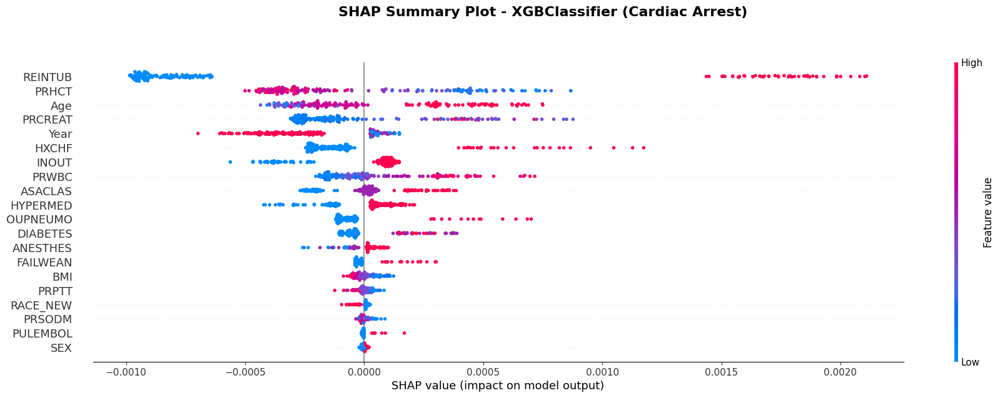

In [ ]:

plt.style.use('petroff10')
plt.rcParams.update({"font.size": 12})

# SHAP for XGBoost - Cardiac Arrest
explainer_XG_CA = shap.Explainer(xgb_classifier_XG_CA, X_train_XG_CA)
shap_values_XG_CA = explainer_XG_CA(X_test_XG_CA)

feature_names = X_test_XG_CA.columns

plt.figure(figsize=(18, 6))

# SHAP summary plot
shap.summary_plot(shap_values_XG_CA, X_test_XG_CA, feature_names=feature_names, plot_size=(18, 6), show=False)

plt.suptitle("SHAP Summary Plot - XGBClassifier (Cardiac Arrest)",
             fontsize=16, fontweight="bold", y=1.05)

plt.subplots_adjust(top=0.90, right=1.0, bottom=0.1, left=0.1)

plt.show()

Sample of prediction probabilities on test set:
[0.4997037  0.49977598 0.4993461  0.50038326 0.5004882  0.49928516
 0.49970084 0.5006763  0.4996442  0.5000459 ]


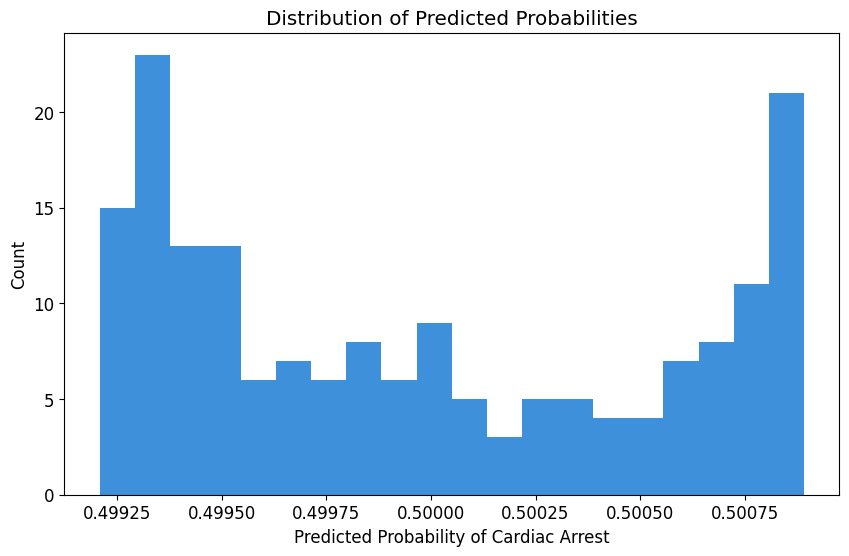

Found 0 clear positive predictions
Found 0 clear negative predictions

No clear predictions found. Explaining a random example:
Instance 145:
Actual class: No Cardiac Arrest
Predicted probability: 0.4993


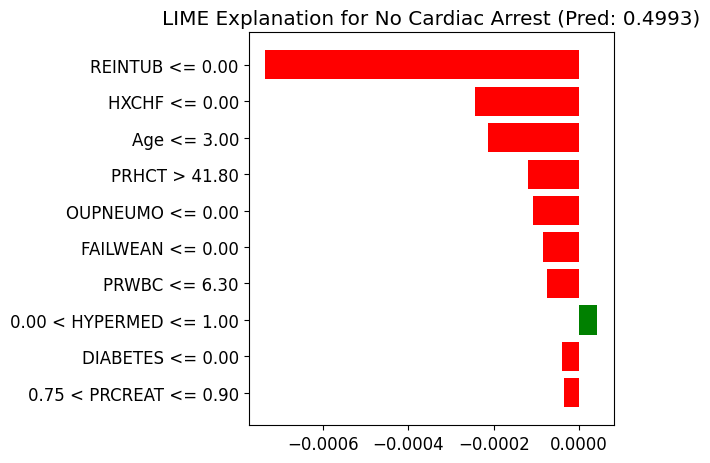

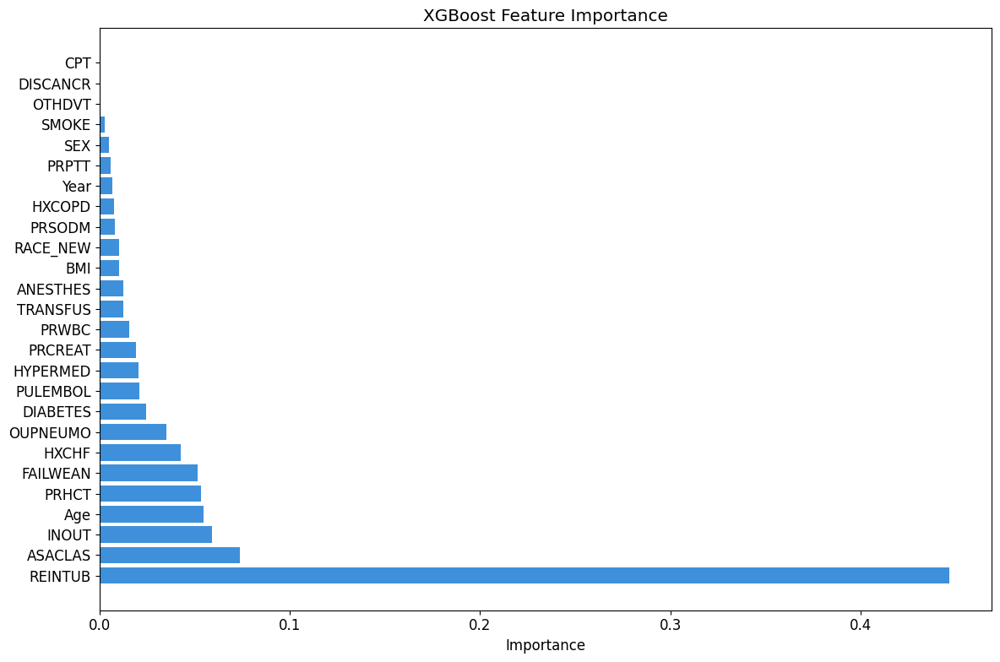

In [ ]:
# Train final model on all data with best hyperparameters
final_model_XG_CA = xgb.XGBClassifier(**best_params_XG_CA)
final_model_XG_CA.fit(X_XG_CA, y_XG_CA)

# Create a test set for LIME explanation (you can use a portion of your data)
from sklearn.model_selection import train_test_split

X_train_lime, X_test_lime, y_train_lime, y_test_lime = train_test_split(
    X_XG_CA, y_XG_CA, test_size=0.2, random_state=42, stratify=y_XG_CA
)

# Initialize the LIME explainer with the training data
from lime.lime_tabular import LimeTabularExplainer

lime_explainer_XG_CA = LimeTabularExplainer(
    training_data=X_train_lime.values,
    feature_names=X_train_lime.columns.tolist(),
    class_names=['No Cardiac Arrest', 'Cardiac Arrest'],
    mode='classification',
    discretize_continuous=True
)

# Check predictions on test set to verify model is working correctly
test_probs = final_model_XG_CA.predict_proba(X_test_lime)[:, 1]
print("Sample of prediction probabilities on test set:")
print(test_probs[:10])

# Create a distribution plot to verify predictions aren't all ~0.5
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
plt.hist(test_probs, bins=20)
plt.title('Distribution of Predicted Probabilities')
plt.xlabel('Predicted Probability of Cardiac Arrest')
plt.ylabel('Count')
plt.show()

# Find samples with clear predictions (not around 0.5)
clear_pos_idx = np.where(test_probs > 0.7)[0]
clear_neg_idx = np.where(test_probs < 0.3)[0]

print(f"Found {len(clear_pos_idx)} clear positive predictions")
print(f"Found {len(clear_neg_idx)} clear negative predictions")

# Function to create and display LIME explanations
def explain_with_lime(model, instance_idx, X_test, y_test, explainer, class_names, num_features=10):

    instance = X_test.iloc[instance_idx].values

    actual_class = y_test.iloc[instance_idx]
    pred_prob = model.predict_proba(instance.reshape(1, -1))[0, 1]

    print(f"Instance {instance_idx}:")
    print(f"Actual class: {class_names[actual_class]}")
    print(f"Predicted probability: {pred_prob:.4f}")

    explanation = explainer.explain_instance(
        instance,
        model.predict_proba,
        num_features=num_features
    )

    fig = explanation.as_pyplot_figure()
    plt.title(f"LIME Explanation for {class_names[actual_class]} (Pred: {pred_prob:.4f})")
    plt.tight_layout()
    plt.show()

    return explanation

if len(clear_pos_idx) > 0:
    pos_idx = clear_pos_idx[0]
    print("\nExplaining a positive prediction (Cardiac Arrest):")
    pos_exp = explain_with_lime(
        final_model_XG_CA,
        pos_idx,
        X_test_lime,
        y_test_lime,
        lime_explainer_XG_CA,
        ['No Cardiac Arrest', 'Cardiac Arrest']
    )

if len(clear_neg_idx) > 0:
    neg_idx = clear_neg_idx[0]
    print("\nExplaining a negative prediction (No Cardiac Arrest):")
    neg_exp = explain_with_lime(
        final_model_XG_CA,
        neg_idx,
        X_test_lime,
        y_test_lime,
        lime_explainer_XG_CA,
        ['No Cardiac Arrest', 'Cardiac Arrest']
    )

if len(clear_pos_idx) == 0 and len(clear_neg_idx) == 0:
    rand_idx = np.random.randint(0, len(X_test_lime))
    print("\nNo clear predictions found. Explaining a random example:")
    rand_exp = explain_with_lime(
        final_model_XG_CA,
        rand_idx,
        X_test_lime,
        y_test_lime,
        lime_explainer_XG_CA,
        ['No Cardiac Arrest', 'Cardiac Arrest']
    )

feature_importance = final_model_XG_CA.feature_importances_
sorted_idx = np.argsort(feature_importance)[::-1]
sorted_features = [X_XG_CA.columns[i] for i in sorted_idx]
sorted_importance = feature_importance[sorted_idx]

plt.figure(figsize=(12, 8))
plt.barh(range(len(sorted_idx)), sorted_importance, align='center')
plt.yticks(range(len(sorted_idx)), sorted_features)
plt.title('XGBoost Feature Importance')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

## CDMI

In [ ]:
# Define feature matrix and target variable for XGBoost (CDMI)
X_XG_CDMI = df1_hip_cleaned.drop(columns=['CDARREST', 'CDMI'])
y_XG_CDMI = df1_hip_cleaned['CDMI']  # Target variable

[I 2025-03-22 23:22:18,518] A new study created in memory with name: no-name-f88629e5-0f13-4d2e-872a-13a691af9205
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_by

Training fold 1
Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:22:21,339] Trial 0 finished with value: 0.8366858800786485 and parameters: {'max_depth': 3, 'learning_rate': 0.0010205829678277471, 'n_estimators': 192, 'subsample': 0.9227948947242708, 'colsample_bytree': 0.6053299805557869}. Best is trial 0 with value: 0.8366858800786485.
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_u

Training fold 1
Training fold 2
Training fold 3


[I 2025-03-22 23:22:21,799] Trial 1 finished with value: 0.835879094677378 and parameters: {'max_depth': 4, 'learning_rate': 0.0027727954118769685, 'n_estimators': 113, 'subsample': 0.6540764267194132, 'colsample_bytree': 0.5645171142968699}. Best is trial 0 with value: 0.8366858800786485.


Training fold 4
Training fold 5


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 1
Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:22:22,903] Trial 2 finished with value: 0.8092664881664493 and parameters: {'max_depth': 10, 'learning_rate': 0.08074083159870384, 'n_estimators': 149, 'subsample': 0.7604565715206788, 'colsample_bytree': 0.8021143222294405}. Best is trial 0 with value: 0.8366858800786485.
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_un

Training fold 1
Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:22:24,915] Trial 3 finished with value: 0.8361371469846484 and parameters: {'max_depth': 6, 'learning_rate': 1.3907898535798032e-05, 'n_estimators': 149, 'subsample': 0.9024048360616441, 'colsample_bytree': 0.62559543046343}. Best is trial 0 with value: 0.8366858800786485.
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_un

Training fold 1
Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:22:25,936] Trial 4 finished with value: 0.8243712149586268 and parameters: {'max_depth': 6, 'learning_rate': 0.0001199007718418517, 'n_estimators': 157, 'subsample': 0.8916569792458543, 'colsample_bytree': 0.9967571979346493}. Best is trial 0 with value: 0.8366858800786485.
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_u

Training fold 1
Training fold 2
Training fold 3


[I 2025-03-22 23:22:26,377] Trial 5 finished with value: 0.8291441199544132 and parameters: {'max_depth': 5, 'learning_rate': 0.04089186355128072, 'n_estimators': 85, 'subsample': 0.5256259241718073, 'colsample_bytree': 0.5802962758408754}. Best is trial 0 with value: 0.8366858800786485.


Training fold 4
Training fold 5
Training fold 1


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:22:26,732] Trial 6 finished with value: 0.8332166579841063 and parameters: {'max_depth': 4, 'learning_rate': 0.003475086150785896, 'n_estimators': 64, 'subsample': 0.545745272574593, 'colsample_bytree': 0.7357818096636493}. Best is trial 0 with value: 0.8366858800786485.


Training fold 5
Training fold 1


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:22:27,444] Trial 7 finished with value: 0.8316860871061538 and parameters: {'max_depth': 9, 'learning_rate': 0.0002856085741521354, 'n_estimators': 76, 'subsample': 0.981500084472451, 'colsample_bytree': 0.5831903372964816}. Best is trial 0 with value: 0.8366858800786485.
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uni

Training fold 1
Training fold 2
Training fold 3


[I 2025-03-22 23:22:27,817] Trial 8 finished with value: 0.8361495292761296 and parameters: {'max_depth': 3, 'learning_rate': 0.009091909389918591, 'n_estimators': 100, 'subsample': 0.9836055078096467, 'colsample_bytree': 0.6232701140039156}. Best is trial 0 with value: 0.8366858800786485.


Training fold 4
Training fold 5
Training fold 1


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:22:28,312] Trial 9 finished with value: 0.8349421889466836 and parameters: {'max_depth': 4, 'learning_rate': 7.263847466399167e-05, 'n_estimators': 124, 'subsample': 0.5848032262790632, 'colsample_bytree': 0.7685908160810249}. Best is trial 0 with value: 0.8366858800786485.


Training fold 5
Training fold 1


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:22:29,473] Trial 10 finished with value: 0.8301357580898557 and parameters: {'max_depth': 8, 'learning_rate': 0.0006309876778571233, 'n_estimators': 199, 'subsample': 0.7958902782972666, 'colsample_bytree': 0.5048470656306507}. Best is trial 0 with value: 0.8366858800786485.
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_

Training fold 1
Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:22:30,045] Trial 11 finished with value: 0.8301458811838447 and parameters: {'max_depth': 3, 'learning_rate': 0.011192029588959448, 'n_estimators': 195, 'subsample': 0.992666746112265, 'colsample_bytree': 0.6877438437518669}. Best is trial 0 with value: 0.8366858800786485.


Training fold 5
Training fold 1


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:22:30,431] Trial 12 finished with value: 0.8352102147843457 and parameters: {'max_depth': 3, 'learning_rate': 0.009245391704413736, 'n_estimators': 99, 'subsample': 0.8748885201645166, 'colsample_bytree': 0.6724697722222429}. Best is trial 0 with value: 0.8366858800786485.


Training fold 5
Training fold 1


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:22:31,519] Trial 13 finished with value: 0.8270828187164831 and parameters: {'max_depth': 7, 'learning_rate': 0.0017959164035060563, 'n_estimators': 179, 'subsample': 0.8309951906869577, 'colsample_bytree': 0.869872882083084}. Best is trial 0 with value: 0.8366858800786485.
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_u

Training fold 1
Training fold 2
Training fold 3


[I 2025-03-22 23:22:31,918] Trial 14 finished with value: 0.834138135049001 and parameters: {'max_depth': 3, 'learning_rate': 0.017278412100703838, 'n_estimators': 102, 'subsample': 0.9400493603099331, 'colsample_bytree': 0.5081523475467143}. Best is trial 0 with value: 0.8366858800786485.


Training fold 4
Training fold 5
Training fold 1


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:22:32,502] Trial 15 finished with value: 0.835136613751066 and parameters: {'max_depth': 5, 'learning_rate': 0.0006062341447598997, 'n_estimators': 136, 'subsample': 0.6989901003414466, 'colsample_bytree': 0.674181921140327}. Best is trial 0 with value: 0.8366858800786485.
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_un

Training fold 1
Training fold 2
Training fold 3


[I 2025-03-22 23:22:32,858] Trial 16 finished with value: 0.8335132504688033 and parameters: {'max_depth': 5, 'learning_rate': 0.005406353427885649, 'n_estimators': 51, 'subsample': 0.8411973933881652, 'colsample_bytree': 0.6218414810611738}. Best is trial 0 with value: 0.8366858800786485.


Training fold 4
Training fold 5
Training fold 1


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:22:33,377] Trial 17 finished with value: 0.8293244306782961 and parameters: {'max_depth': 3, 'learning_rate': 0.025003403725985064, 'n_estimators': 165, 'subsample': 0.9417116993055445, 'colsample_bytree': 0.8193193317559025}. Best is trial 0 with value: 0.8366858800786485.


Training fold 5
Training fold 1


<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),  # Column sample by tree


Training fold 2
Training fold 3
Training fold 4
Training fold 5


[I 2025-03-22 23:22:34,184] Trial 18 finished with value: 0.8327719975383406 and parameters: {'max_depth': 7, 'learning_rate': 0.001711627178373662, 'n_estimators': 124, 'subsample': 0.9957147004423694, 'colsample_bytree': 0.7123091271581434}. Best is trial 0 with value: 0.8366858800786485.
<ipython-input-87-a0307f4318b6>:8: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),  # Log scale for learning_rate
<ipython-input-87-a0307f4318b6>:10: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),  # Subsample ratio
<ipython-input-87-a0307f4318b6>:11: FutureWarning: suggest_u

Training fold 1
Training fold 2
Training fold 3
Training fold 4


[I 2025-03-22 23:22:34,785] Trial 19 finished with value: 0.8369149721504711 and parameters: {'max_depth': 4, 'learning_rate': 0.00024999199227396734, 'n_estimators': 177, 'subsample': 0.9430496015706255, 'colsample_bytree': 0.6296184686506986}. Best is trial 19 with value: 0.8369149721504711.


Training fold 5
Best hyperparameters: {'max_depth': 4, 'learning_rate': 0.00024999199227396734, 'n_estimators': 177, 'subsample': 0.9430496015706255, 'colsample_bytree': 0.6296184686506986}
Training fold 1
Training fold 2
Training fold 3
Training fold 4
Training fold 5

Average accuracy from 5-fold cross-validation: 0.7485
Average precision: 0.7356
Average recall: 0.7694
Average F1 score: 0.7470
Average AUC-ROC: 0.8369


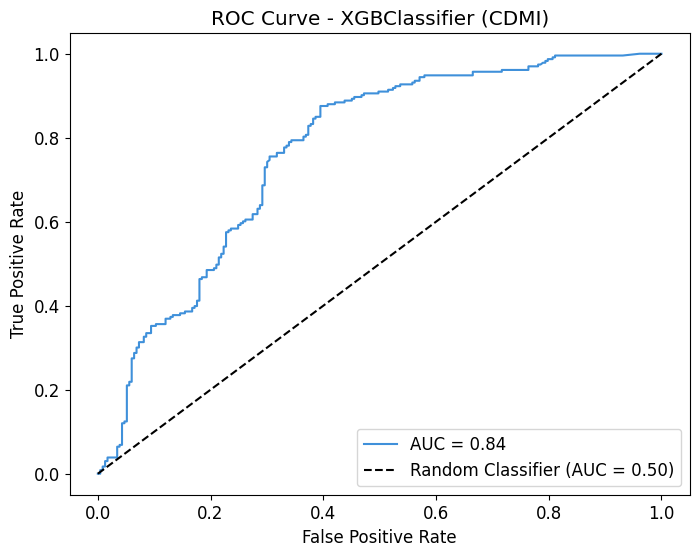

In [ ]:
# Define objective function for Optuna
def objective_XG_CDMI(trial):
    param = {
        'objective': 'binary:logistic',
        'eval_metric': 'logloss',
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1e-1),
        'n_estimators': trial.suggest_int('n_estimators', 50, 200),
        'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.5, 1.0),
        'verbosity': 0
    }

    # Initialize StratifiedKFold with 5 splits
    kf_XG_CDMI = StratifiedKFold(n_splits=5, shuffle=False)

    # Store metrics for each fold
    fold_accuracies_XG_CDMI = []
    fold_precisions_XG_CDMI = []
    fold_recalls_XG_CDMI = []
    fold_f1_scores_XG_CDMI = []
    fold_roc_auc_XG_CDMI = []

    # Loop over each split
    for fold_idx, (train_index, test_index) in enumerate(kf_XG_CDMI.split(X_XG_CDMI, y_XG_CDMI)):
        print(f"Training fold {fold_idx + 1}")

        X_train_XG_CDMI, X_test_XG_CDMI = X_XG_CDMI.iloc[train_index], X_XG_CDMI.iloc[test_index]
        y_train_XG_CDMI, y_test_XG_CDMI = y_XG_CDMI.iloc[train_index], y_XG_CDMI.iloc[test_index]

        xgb_classifier_XG_CDMI = xgb.XGBClassifier(**param)

        xgb_classifier_XG_CDMI.fit(X_train_XG_CDMI, y_train_XG_CDMI)

        y_pred_XG_CDMI = xgb_classifier_XG_CDMI.predict(X_test_XG_CDMI)
        y_pred_prob_XG_CDMI = xgb_classifier_XG_CDMI.predict_proba(X_test_XG_CDMI)[:, 1]

        accuracy_XG_CDMI = accuracy_score(y_test_XG_CDMI, y_pred_XG_CDMI)
        precision_XG_CDMI = precision_score(y_test_XG_CDMI, y_pred_XG_CDMI)
        recall_XG_CDMI = recall_score(y_test_XG_CDMI, y_pred_XG_CDMI)
        f1_XG_CDMI = f1_score(y_test_XG_CDMI, y_pred_XG_CDMI)
        roc_auc_XG_CDMI = roc_auc_score(y_test_XG_CDMI, y_pred_prob_XG_CDMI)

        fold_accuracies_XG_CDMI.append(accuracy_XG_CDMI)
        fold_precisions_XG_CDMI.append(precision_XG_CDMI)
        fold_recalls_XG_CDMI.append(recall_XG_CDMI)
        fold_f1_scores_XG_CDMI.append(f1_XG_CDMI)
        fold_roc_auc_XG_CDMI.append(roc_auc_XG_CDMI)

    avg_accuracy_XG_CDMI = np.mean(fold_accuracies_XG_CDMI)
    avg_precision_XG_CDMI = np.mean(fold_precisions_XG_CDMI)
    avg_recall_XG_CDMI = np.mean(fold_recalls_XG_CDMI)
    avg_f1_XG_CDMI = np.mean(fold_f1_scores_XG_CDMI)
    avg_roc_auc_XG_CDMI = np.mean(fold_roc_auc_XG_CDMI)

    return avg_roc_auc_XG_CDMI

# Run Optuna optimization to find the best hyperparameters
study_XG_CDMI = optuna.create_study(direction='maximize')
study_XG_CDMI.optimize(objective_XG_CDMI, n_trials=20)

# Print the best hyperparameters
print("Best hyperparameters:", study_XG_CDMI.best_params)

# Now using the best hyperparameters found by Optuna to train the model
best_params_XG_CDMI = study_XG_CDMI.best_params

# Initialize StratifiedKFold with 5 splits
kf_XG_CDMI = StratifiedKFold(n_splits=5, shuffle=False)

# Store metrics for each fold
fold_accuracies_XG_CDMI = []
fold_precisions_XG_CDMI = []
fold_recalls_XG_CDMI = []
fold_f1_scores_XG_CDMI = []
fold_roc_auc_XG_CDMI = []

# Loop over each split
for fold_idx, (train_index, test_index) in enumerate(kf_XG_CDMI.split(X_XG_CDMI, y_XG_CDMI)):
    print(f"Training fold {fold_idx + 1}")

    X_train_XG_CDMI, X_test_XG_CDMI = X_XG_CDMI.iloc[train_index], X_XG_CDMI.iloc[test_index]
    y_train_XG_CDMI, y_test_XG_CDMI = y_XG_CDMI.iloc[train_index], y_XG_CDMI.iloc[test_index]

    xgb_classifier_XG_CDMI = xgb.XGBClassifier(**best_params_XG_CDMI)

    xgb_classifier_XG_CDMI.fit(X_train_XG_CDMI, y_train_XG_CDMI)

    y_pred_XG_CDMI = xgb_classifier_XG_CDMI.predict(X_test_XG_CDMI)
    y_pred_prob_XG_CDMI = xgb_classifier_XG_CDMI.predict_proba(X_test_XG_CDMI)[:, 1]

    accuracy_XG_CDMI = accuracy_score(y_test_XG_CDMI, y_pred_XG_CDMI)
    precision_XG_CDMI = precision_score(y_test_XG_CDMI, y_pred_XG_CDMI)
    recall_XG_CDMI = recall_score(y_test_XG_CDMI, y_pred_XG_CDMI)
    f1_XG_CDMI = f1_score(y_test_XG_CDMI, y_pred_XG_CDMI)
    roc_auc_XG_CDMI = roc_auc_score(y_test_XG_CDMI, y_pred_prob_XG_CDMI)

    fold_accuracies_XG_CDMI.append(accuracy_XG_CDMI)
    fold_precisions_XG_CDMI.append(precision_XG_CDMI)
    fold_recalls_XG_CDMI.append(recall_XG_CDMI)
    fold_f1_scores_XG_CDMI.append(f1_XG_CDMI)
    fold_roc_auc_XG_CDMI.append(roc_auc_XG_CDMI)

avg_accuracy_XG_CDMI = np.mean(fold_accuracies_XG_CDMI)
avg_precision_XG_CDMI = np.mean(fold_precisions_XG_CDMI)
avg_recall_XG_CDMI = np.mean(fold_recalls_XG_CDMI)
avg_f1_XG_CDMI = np.mean(fold_f1_scores_XG_CDMI)
avg_roc_auc_XG_CDMI = np.mean(fold_roc_auc_XG_CDMI)

print(f"\nAverage accuracy from 5-fold cross-validation: {avg_accuracy_XG_CDMI:.4f}")
print(f"Average precision: {avg_precision_XG_CDMI:.4f}")
print(f"Average recall: {avg_recall_XG_CDMI:.4f}")
print(f"Average F1 score: {avg_f1_XG_CDMI:.4f}")
print(f"Average AUC-ROC: {avg_roc_auc_XG_CDMI:.4f}")

# Plot AUC-ROC curve
fpr_XG_CDMI, tpr_XG_CDMI, _ = roc_curve(y_test_XG_CDMI, y_pred_prob_XG_CDMI)
plt.figure(figsize=(8, 6))
plt.plot(fpr_XG_CDMI, tpr_XG_CDMI, label=f'AUC = {avg_roc_auc_XG_CDMI:.2f}')
plt.plot([0, 1], [0, 1], 'k--', label='Random Classifier (AUC = 0.50)')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - XGBClassifier (CDMI)')
plt.legend(loc='lower right')
plt.show()

<ipython-input-88-9653bfdbeddc>:16: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values_XG_CDMI, X_test_XG_CDMI, feature_names=feature_names, plot_size=(18, 6), show=False)


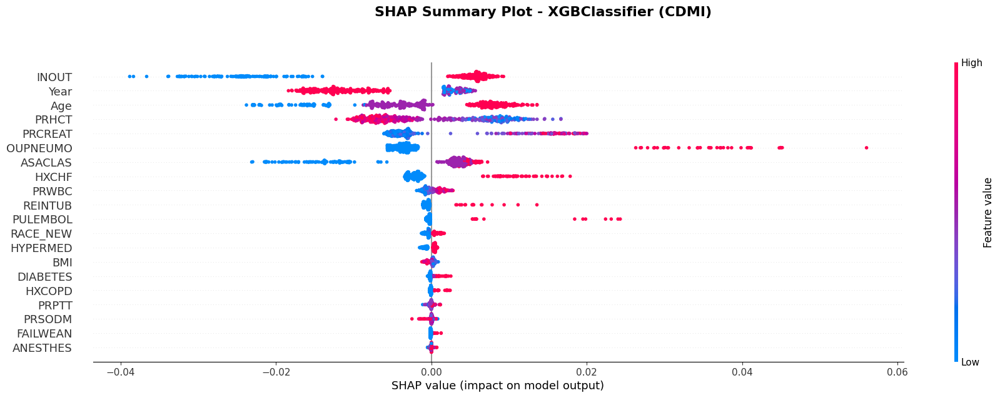

In [ ]:
plt.style.use('petroff10')
plt.rcParams.update({"font.size": 12})

# SHAP for XGBoost - CDMI
explainer_XG_CDMI = shap.Explainer(xgb_classifier_XG_CDMI, X_train_XG_CDMI)
shap_values_XG_CDMI = explainer_XG_CDMI(X_test_XG_CDMI)

feature_names = X_test_XG_CDMI.columns

plt.figure(figsize=(18, 6))

shap.summary_plot(shap_values_XG_CDMI, X_test_XG_CDMI, feature_names=feature_names, plot_size=(18, 6), show=False)

plt.suptitle("SHAP Summary Plot - XGBClassifier (CDMI)",
             fontsize=16, fontweight="bold", y=1.05)

plt.subplots_adjust(top=0.90, right=1.0, bottom=0.1, left=0.1)

plt.show()

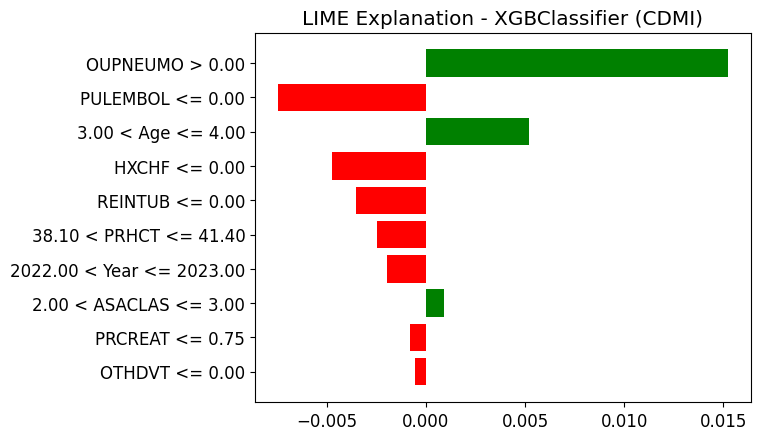

In [ ]:
# Initialize the LIME explainer for the XGBClassifier (use the training data for explanation)
lime_explainer_XG_CDMI = LimeTabularExplainer(
    training_data=X_train_XG_CDMI.values,
    feature_names=X_train_XG_CDMI.columns.tolist(),
    class_names=['No CDMI', 'CDMI'],
    mode='classification',
    discretize_continuous=True
)

# Select an instance from the test data to explain
idx_XG_CDMI = np.random.randint(0, X_test_XG_CDMI.shape[0])
instance_to_explain_CDMI = X_test_XG_CDMI.iloc[idx_XG_CDMI]

# Explain the instance using LIME
lime_exp_XG_CDMI = lime_explainer_XG_CDMI.explain_instance(
    instance_to_explain_CDMI.values,
    xgb_classifier_XG_CDMI.predict_proba
)

# Show the explanation in the notebook
lime_exp_XG_CDMI.show_in_notebook()

# Alternatively, plot the explanation as a figure
fig = lime_exp_XG_CDMI.as_pyplot_figure()
plt.title("LIME Explanation - XGBClassifier (CDMI)")
plt.show()

## Combined

In [ ]:
from sklearn.utils import resample

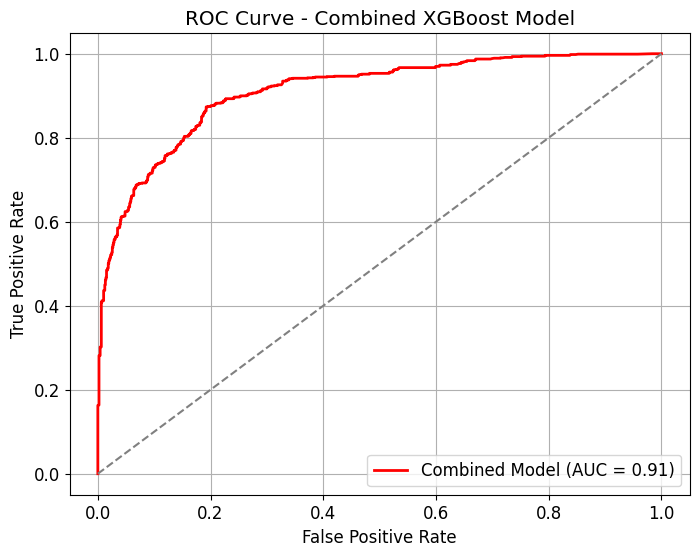

Combined Model Metrics: 
Accuracy: 0.5135
F1 Score: 0.6786
Recall: 1.0000
Precision: 0.5135
AUC Score: 0.9101


In [ ]:
xg_classifier_CA = xgb.XGBClassifier(**best_params_XG_CA)
xg_classifier_CDMI = xgb.XGBClassifier(**best_params_XG_CDMI)

original_feature_names_XG = X_XG_CA_resampled.columns.tolist()

X_XG_Combined_df = pd.DataFrame(X_XG_Combined, columns=original_feature_names_XG)

voting_classifier_XG_Combined = VotingClassifier(estimators=[
    ('xg_CA', xg_classifier_CA),
    ('xg_CDMI', xg_classifier_CDMI)
], voting='soft')

voting_classifier_XG_Combined.fit(X_XG_Combined, y_XG_Combined, )

# Make predictions using the combined model
y_pred_combined_labels_XG_Combined = voting_classifier_XG_Combined.predict(X_XG_Combined)

# Compute metrics for the combined model
accuracy_combined_XG_Combined = accuracy_score(y_XG_Combined, y_pred_combined_labels_XG_Combined)
f1_combined_XG_Combined = f1_score(y_XG_Combined, y_pred_combined_labels_XG_Combined)
recall_combined_XG_Combined = recall_score(y_XG_Combined, y_pred_combined_labels_XG_Combined)
precision_combined_XG_Combined = precision_score(y_XG_Combined, y_pred_combined_labels_XG_Combined)

# Compute the ROC curve and AUC for the combined model
y_pred_combined_prob_XG_Combined = voting_classifier_XG_Combined.predict_proba(X_XG_Combined)[:, 1]
fpr_combined_XG_Combined, tpr_combined_XG_Combined, _ = roc_curve(y_XG_Combined, y_pred_combined_prob_XG_Combined)
roc_auc_combined_XG_Combined = auc(fpr_combined_XG_Combined, tpr_combined_XG_Combined)

# Plot ROC Curve for the combined model
plt.figure(figsize=(8, 6))
plt.plot(fpr_combined_XG_Combined, tpr_combined_XG_Combined, color='red', lw=2, label=f'Combined Model (AUC = {roc_auc_combined_XG_Combined:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Combined XGBoost Model')
plt.legend(loc='lower right')
plt.grid()
plt.show()

# Print metrics for the combined model
print(f'Combined Model Metrics: ')
print(f'Accuracy: {accuracy_combined_XG_Combined:.4f}')
print(f'F1 Score: {f1_combined_XG_Combined:.4f}')
print(f'Recall: {recall_combined_XG_Combined:.4f}')
print(f'Precision: {precision_combined_XG_Combined:.4f}')
print(f'AUC Score: {roc_auc_combined_XG_Combined:.4f}')

In [ ]:
xg_classifier_CA.fit(X_XG_CA_resampled, y_XG_CA_resampled)
xg_classifier_CDMI.fit(X_XG_CDMI_resampled, y_XG_CDMI_resampled)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.5725050590383154, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=4.830920703799861e-05,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=120, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

<ipython-input-96-63504979480c>:17: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values_combined, X_combined, feature_names=feature_names_combined, title="Combined SHAP Summary Plot")


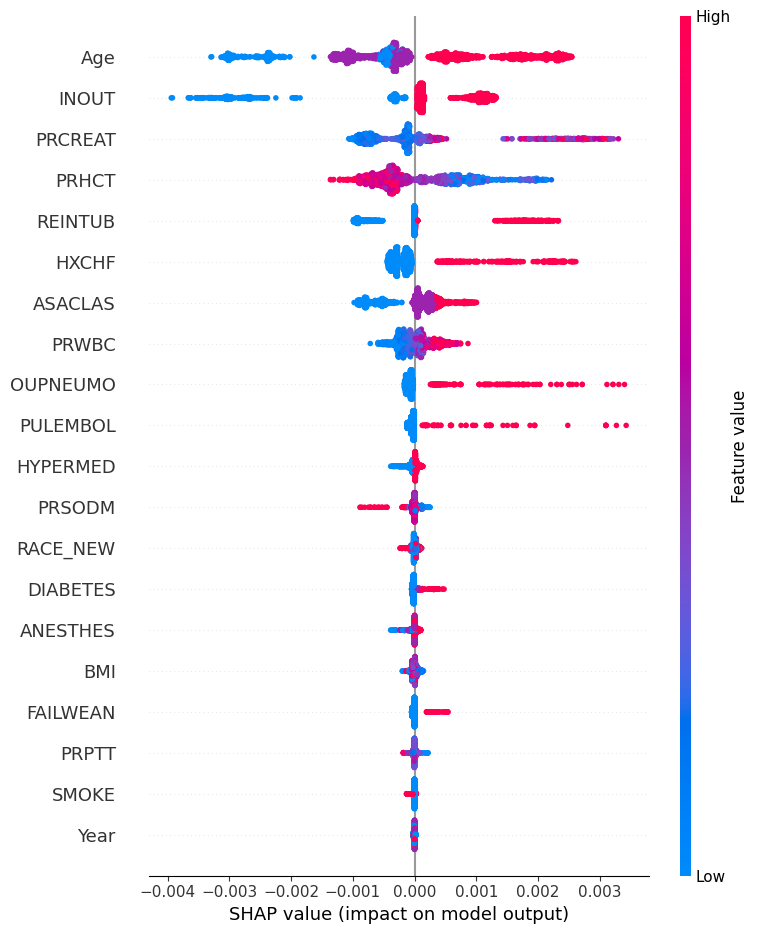

In [ ]:
# 1. Create SHAP explainers for both models (xg_CA and xg_CDMI)
explainer_xg_CA = shap.TreeExplainer(xg_classifier_CA)
explainer_xg_CDMI = shap.TreeExplainer(xg_classifier_CDMI)

# 2. Get SHAP values for both models
shap_values_xg_CA = explainer_xg_CA.shap_values(X_XG_CA_resampled)
shap_values_xg_CDMI = explainer_xg_CDMI.shap_values(X_XG_CDMI_resampled)

# 3. Concatenate SHAP values from both models
shap_values_combined = np.concatenate([shap_values_xg_CA, shap_values_xg_CDMI], axis=0)

# 4. Concatenate the feature sets from both models (make sure feature names are consistent)
X_combined = pd.concat([X_XG_CA_resampled, X_XG_CDMI_resampled], axis=0)
feature_names_combined = X_combined.columns.tolist()

# 5. Generate a SHAP summary plot for the combined model
shap.summary_plot(shap_values_combined, X_combined, feature_names=feature_names_combined, title="Combined SHAP Summary Plot")

# Logistic Regression

## Cardiac Arrest

[I 2025-03-22 23:29:54,367] A new study created in memory with name: no-name-6d7ae043-0cef-4f53-bf58-3c28bd22ec60
<ipython-input-97-1247010079fa>:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  C = trial.suggest_loguniform('C', 1e-4, 10)  # Regularization strength
[I 2025-03-22 23:29:54,407] Trial 0 finished with value: 0.9210124984219163 and parameters: {'C': 0.007077964618573665, 'solver': 'newton-cg'}. Best is trial 0 with value: 0.9210124984219163.
<ipython-input-97-1247010079fa>:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  C = trial.suggest_loguniform('C', 1e-4, 10)  # Regularization strength
[I 2025-03-22 23:29:54,439] Trial 1 finished with value: 0.9135827

Best hyperparameters for Logistic Regression: {'C': 0.02277178252876841, 'solver': 'liblinear'}


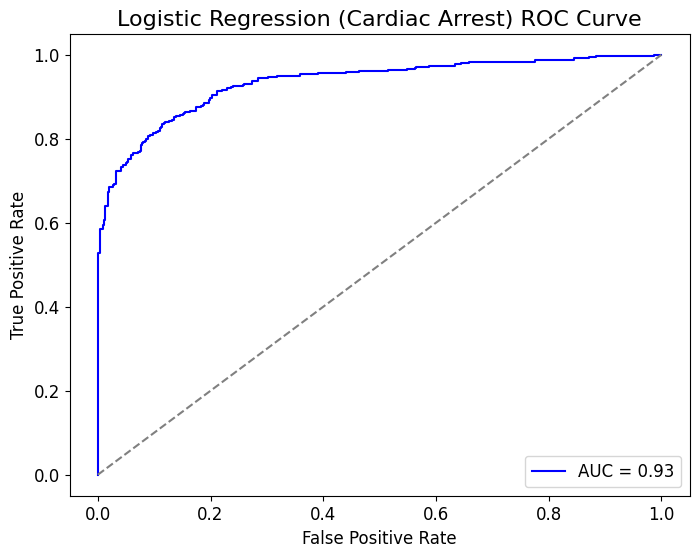

              precision    recall  f1-score   support

           0       0.83      0.91      0.86       446
           1       0.90      0.81      0.85       446

    accuracy                           0.86       892
   macro avg       0.86      0.86      0.86       892
weighted avg       0.86      0.86      0.86       892

AUC-ROC: 0.9331727965573408
Overall Accuracy (Logistic Regression (Cardiac Arrest)): 0.8576
F1 Score (Logistic Regression (Cardiac Arrest)): 0.8504
Recall Score (Logistic Regression (Cardiac Arrest)): 0.8094
Precision Score (Logistic Regression (Cardiac Arrest)): 0.8094


In [ ]:
# Prepare data
X_LR_CA = df_hip_cleaned.drop(columns=['CDARREST', 'CDMI'])
y_LR_CA = df_hip_cleaned['CDARREST']

# Standardize features
scaler_LR_CA = StandardScaler()
X_scaled_LR_CA = scaler_LR_CA.fit_transform(X_LR_CA)

# Define Stratified K-Fold Cross Validation (5 folds) for Logistic Regression (Cardiac Arrest)
kf_LR_CA = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Define Optuna objective function for Logistic Regression (Cardiac Arrest)
def lr_ca_objective(trial):
    C = trial.suggest_loguniform('C', 1e-4, 10)  # Regularization strength
    solver = trial.suggest_categorical('solver', ['liblinear', 'lbfgs', 'newton-cg'])
    auc_scores = []

    for train_index, test_index in kf_LR_CA.split(X_scaled_LR_CA, y_LR_CA):
        X_train_LR_CA, X_test_LR_CA = X_scaled_LR_CA[train_index], X_scaled_LR_CA[test_index]
        y_train_LR_CA, y_test_LR_CA = y_LR_CA[train_index], y_LR_CA[test_index]

        model = LogisticRegression(C=C, solver=solver, max_iter=1000, random_state=42)
        model.fit(X_train_LR_CA, y_train_LR_CA)

        y_prob_LR_CA = model.predict_proba(X_test_LR_CA)[:, 1]
        auc_score = roc_auc_score(y_test_LR_CA, y_prob_LR_CA)
        auc_scores.append(auc_score)

    return np.mean(auc_scores)

# Run Optuna optimization
study_LR_CA = optuna.create_study(direction="maximize")
study_LR_CA.optimize(lr_ca_objective, n_trials=50)

# Train final Logistic Regression model with best hyperparameters
best_params_LR_CA = study_LR_CA.best_params
print("Best hyperparameters for Logistic Regression:", best_params_LR_CA)

log_reg_LR_CA = LogisticRegression(**best_params_LR_CA, max_iter=1000, random_state=42)

# Train on entire dataset
log_reg_LR_CA.fit(X_scaled_LR_CA, y_LR_CA)

# Make predictions
y_pred_LR_CA = log_reg_LR_CA.predict(X_scaled_LR_CA)
y_prob_LR_CA = log_reg_LR_CA.predict_proba(X_scaled_LR_CA)[:, 1]


# 2. ROC Curve
LR_CA_fpr, LR_CA_tpr, _ = roc_curve(y_LR_CA, y_prob_LR_CA)
roc_auc_LR_CA = roc_auc_score(y_LR_CA, y_prob_LR_CA)

plt.figure(figsize=(8, 6))
plt.plot(LR_CA_fpr, LR_CA_tpr, color='blue', label=f'AUC = {roc_auc_LR_CA:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.title('Logistic Regression (Cardiac Arrest) ROC Curve', fontsize=16)
plt.xlabel('False Positive Rate', fontsize=12)
plt.ylabel('True Positive Rate', fontsize=12)
plt.legend(loc="lower right")
plt.show()


# 4. Print Classification Report and AUC Score
print(classification_report(y_LR_CA, y_pred_LR_CA))
print("AUC-ROC:", roc_auc_LR_CA)
accuracy_LR_CA = accuracy_score(y_LR_CA, y_pred_LR_CA)
print(f"Overall Accuracy (Logistic Regression (Cardiac Arrest)): {accuracy_LR_CA:.4f}")
f1_LR_CA = f1_score(y_LR_CA, y_pred_LR_CA)
print(f"F1 Score (Logistic Regression (Cardiac Arrest)): {f1_LR_CA:.4f}")
recall_LR_CA = recall_score(y_LR_CA, y_pred_LR_CA)
print(f"Recall Score (Logistic Regression (Cardiac Arrest)): {recall_LR_CA:.4f}")
precision_LR_CA = recall_score(y_LR_CA, y_pred_LR_CA)
print(f"Precision Score (Logistic Regression (Cardiac Arrest)): {precision_LR_CA:.4f}")

<ipython-input-98-36fd7025a062>:12: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values_LR_CA, X_scaled_LR_CA, feature_names=feature_names, show=False)


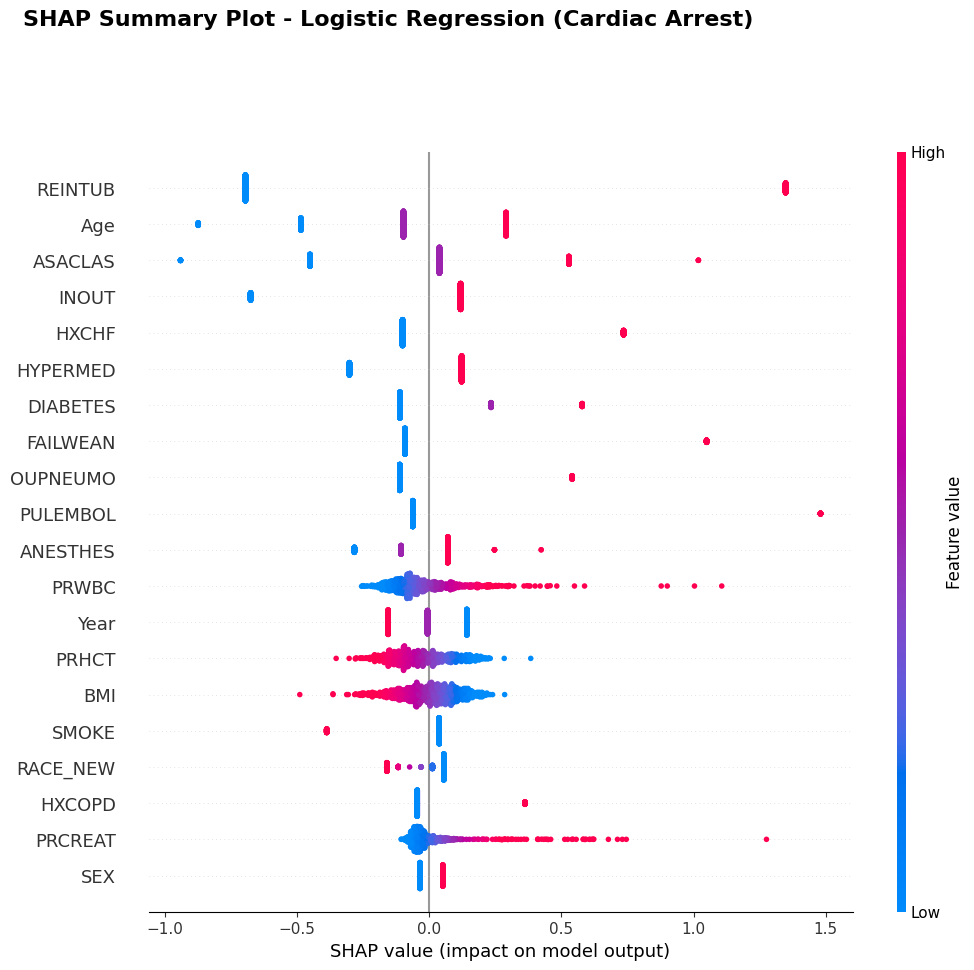

In [ ]:
# SHAP for Logistic Regression - Cardiac Arrest (CA)
explainer_LR_CA = shap.Explainer(log_reg_LR_CA, X_scaled_LR_CA)
shap_values_LR_CA = explainer_LR_CA(X_scaled_LR_CA)

# Ensure feature names are correctly passed
feature_names = X_LR_CA.columns

# Create SHAP summary plot with significantly increased figure size
plt.figure(figsize=(22, 10))

# Create the SHAP summary plot without showing it immediately
shap.summary_plot(shap_values_LR_CA, X_scaled_LR_CA, feature_names=feature_names, show=False)

# Add a title with adjusted positioning
plt.suptitle("SHAP Summary Plot - Logistic Regression (Cardiac Arrest)", fontsize=16, fontweight="bold", y=1.05)

# Adjust margins further to make room for labels and title
plt.subplots_adjust(top=0.90, right=1.3, bottom=0.1, left=0.2)

# Show the plot
plt.show()

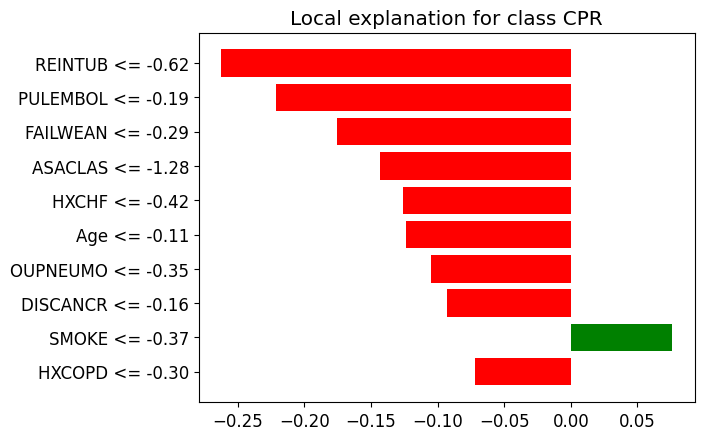

In [ ]:
# Initialize the LIME Explainer for Logistic Regression (CA)
explainer_LR_CA = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_scaled_LR_CA,  =
    feature_names=X_LR_CA.columns,
    class_names=['No CPR', 'CPR'],
    mode='classification'
)

# Select a random instance from the scaled data (from the test set)
i = np.random.randint(0, X_scaled_LR_CA.shape[0])
sample_instance = X_scaled_LR_CA[i]

explanation_LR_CA = explainer_LR_CA.explain_instance(
    sample_instance,
    log_reg_LR_CA.predict_proba,
    num_features=10
)

explanation_LR_CA.show_in_notebook()

fig = explanation_LR_CA.as_pyplot_figure()
plt.show()

## CDMI

[I 2025-03-22 23:30:11,349] A new study created in memory with name: no-name-920a43b8-dbb3-4340-8aa8-0c97a243f4b6
<ipython-input-100-504188a78894>:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  C = trial.suggest_loguniform('C', 1e-4, 10)  # Regularization strength
[I 2025-03-22 23:30:11,374] Trial 0 finished with value: 0.8653407775071464 and parameters: {'C': 0.007011553780512292, 'solver': 'lbfgs'}. Best is trial 0 with value: 0.8653407775071464.
<ipython-input-100-504188a78894>:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  C = trial.suggest_loguniform('C', 1e-4, 10)  # Regularization strength
[I 2025-03-22 23:30:11,398] Trial 1 finished with value: 0.861795081

Best hyperparameters for Logistic Regression: {'C': 9.267190994494479, 'solver': 'newton-cg'}


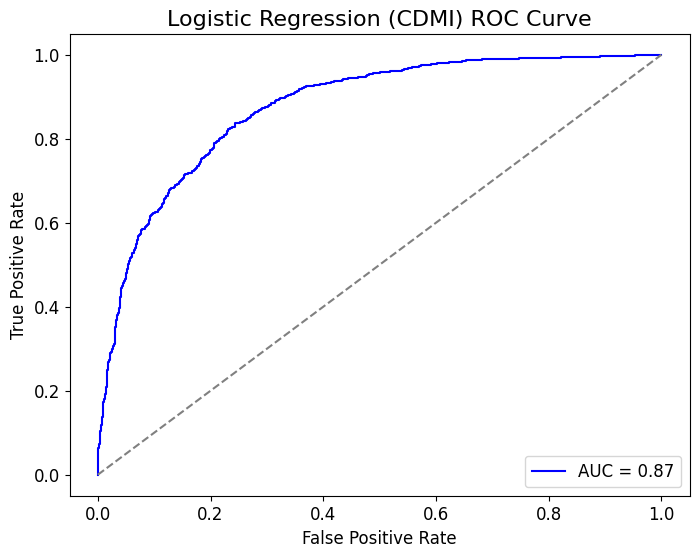

              precision    recall  f1-score   support

           0       0.80      0.78      0.79      1167
           1       0.78      0.80      0.79      1167

    accuracy                           0.79      2334
   macro avg       0.79      0.79      0.79      2334
weighted avg       0.79      0.79      0.79      2334

AUC-ROC: 0.8747592498360732
Overall Accuracy (Logistic Regression (CDMI)): 0.7909
F1 Score (Logistic Regression (CDMI)): 0.7932
Recall Score (Logistic Regression (CDMI)): 0.8021
Precision Score (Logistic Regression (CDMI)): 0.7846


In [ ]:
# Prepare data
X_LR_CDMI = df1_hip_cleaned.drop(columns=['CDARREST','CDMI'])
y_LR_CDMI = df1_hip_cleaned['CDMI']

# Standardize features
scaler_LR_CDMI = StandardScaler()
X_scaled_LR_CDMI = scaler_LR_CDMI.fit_transform(X_LR_CDMI)

# Define Stratified K-Fold Cross Validation (5 folds) for Logistic Regression (CDMI)
kf_LR_CDMI = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Define Optuna objective function for Logistic Regression (CDMI)
def lr_cdmi_objective(trial):
    C = trial.suggest_loguniform('C', 1e-4, 10)
    solver = trial.suggest_categorical('solver', ['liblinear', 'lbfgs', 'newton-cg'])
    auc_scores = []

    for train_index, test_index in kf_LR_CDMI.split(X_scaled_LR_CDMI, y_LR_CDMI):
        X_train_LR_CDMI, X_test_LR_CDMI = X_scaled_LR_CDMI[train_index], X_scaled_LR_CDMI[test_index]
        y_train_LR_CDMI, y_test_LR_CDMI = y_LR_CDMI[train_index], y_LR_CDMI[test_index]

        model = LogisticRegression(C=C, solver=solver, max_iter=1000, random_state=42)
        model.fit(X_train_LR_CDMI, y_train_LR_CDMI)

        y_prob_LR_CDMI = model.predict_proba(X_test_LR_CDMI)[:, 1]
        auc_score = roc_auc_score(y_test_LR_CDMI, y_prob_LR_CDMI)
        auc_scores.append(auc_score)

    return np.mean(auc_scores)

# Run Optuna optimization
study_LR_CDMI = optuna.create_study(direction="maximize")
study_LR_CDMI.optimize(lr_cdmi_objective, n_trials=50)

# Train final Logistic Regression model with best hyperparameters
best_params_LR_CDMI = study_LR_CDMI.best_params
print("Best hyperparameters for Logistic Regression:", best_params_LR_CDMI)

log_reg_LR_CDMI = LogisticRegression(**best_params_LR_CDMI, max_iter=1000, random_state=42)

# Train on entire dataset
log_reg_LR_CDMI.fit(X_scaled_LR_CDMI, y_LR_CDMI)

# Make predictions
y_pred_LR_CDMI = log_reg_LR_CDMI.predict(X_scaled_LR_CDMI)
y_prob_LR_CDMI = log_reg_LR_CDMI.predict_proba(X_scaled_LR_CDMI)[:, 1]


# 2. ROC Curve
LR_CDMI_fpr, LR_CDMI_tpr, _ = roc_curve(y_LR_CDMI, y_prob_LR_CDMI)
roc_auc_LR_CDMI = roc_auc_score(y_LR_CDMI, y_prob_LR_CDMI)

plt.figure(figsize=(8, 6))
plt.plot(LR_CDMI_fpr, LR_CDMI_tpr, color='blue', label=f'AUC = {roc_auc_LR_CDMI:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.title('Logistic Regression (CDMI) ROC Curve', fontsize=16)
plt.xlabel('False Positive Rate', fontsize=12)
plt.ylabel('True Positive Rate', fontsize=12)
plt.legend(loc="lower right")
plt.show()


# 4. Print Classification Report and AUC Score
print(classification_report(y_LR_CDMI, y_pred_LR_CDMI))
print("AUC-ROC:", roc_auc_LR_CDMI)
accuracy_LR_CDMI = accuracy_score(y_LR_CDMI, y_pred_LR_CDMI)
print(f"Overall Accuracy (Logistic Regression (CDMI)): {accuracy_LR_CDMI:.4f}")
f1_LR_CDMI = f1_score(y_LR_CDMI, y_pred_LR_CDMI)
print(f"F1 Score (Logistic Regression (CDMI)): {f1_LR_CDMI:.4f}")
recall_LR_CDMI = recall_score(y_LR_CDMI, y_pred_LR_CDMI)
print(f"Recall Score (Logistic Regression (CDMI)): {recall_LR_CDMI:.4f}")
precision_LR_CDMI = precision_score(y_LR_CDMI, y_pred_LR_CDMI)
print(f"Precision Score (Logistic Regression (CDMI)): {precision_LR_CDMI:.4f}")

<ipython-input-101-c62d19060744>:12: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values_LR_CDMI, X_scaled_LR_CDMI, feature_names=feature_names, show=False)


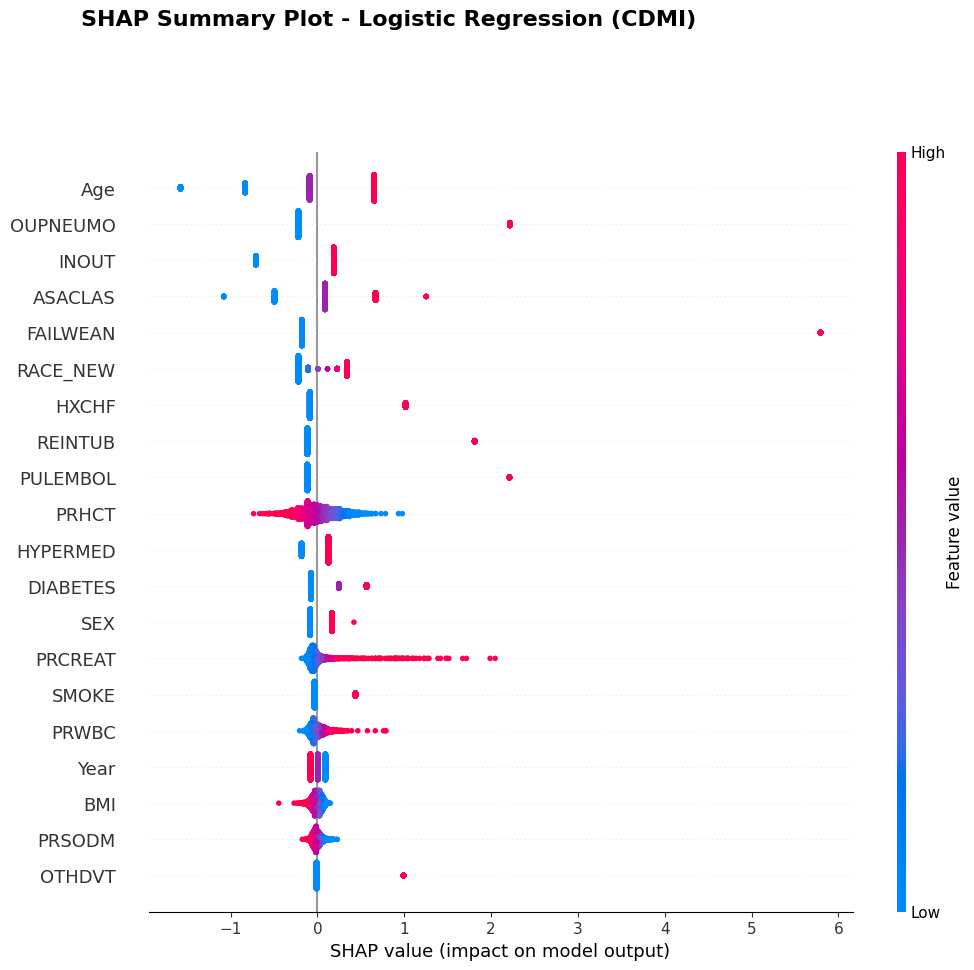

In [ ]:
# SHAP for Logistic Regression - CDMI
explainer_LR_CDMI = shap.Explainer(log_reg_LR_CDMI, X_scaled_LR_CDMI)
shap_values_LR_CDMI = explainer_LR_CDMI(X_scaled_LR_CDMI)

feature_names = X_LR_CDMI.columns

plt.figure(figsize=(22, 10))

# Create the SHAP summary plot
shap.summary_plot(shap_values_LR_CDMI, X_scaled_LR_CDMI, feature_names=feature_names, show=False)

plt.suptitle("SHAP Summary Plot - Logistic Regression (CDMI)", fontsize=16, fontweight="bold", y=1.05)

plt.subplots_adjust(top=0.90, right=1.3, bottom=0.1, left=0.2)

plt.show()

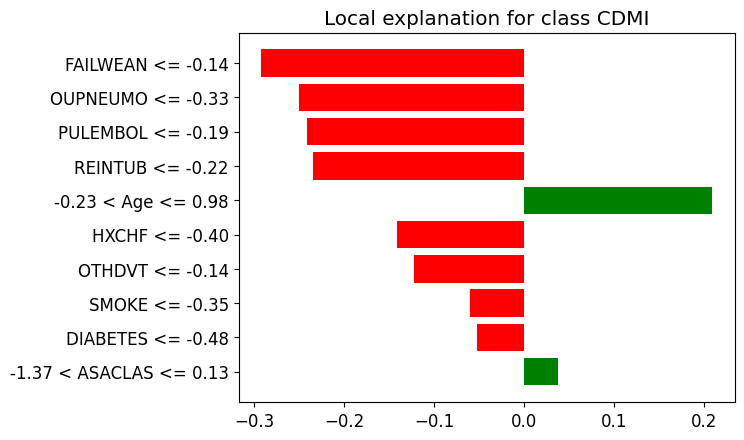

In [ ]:
# Initialize the LIME Explainer for Logistic Regression (CDMI)
explainer_LR_CDMI = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_scaled_LR_CDMI,
    feature_names=X_LR_CDMI.columns,
    class_names=['No CDMI', 'CDMI'],
    mode='classification'
)

# Select and plot a random instance from the scaled data (from the test set)
i = np.random.randint(0, X_scaled_LR_CDMI.shape[0])
sample_instance = X_scaled_LR_CDMI[i]

explanation_LR_CDMI = explainer_LR_CDMI.explain_instance(
    sample_instance,
    log_reg_LR_CDMI.predict_proba,
    num_features=10
)


explanation_LR_CDMI.show_in_notebook()

fig = explanation_LR_CDMI.as_pyplot_figure()
plt.show()

## Combined

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

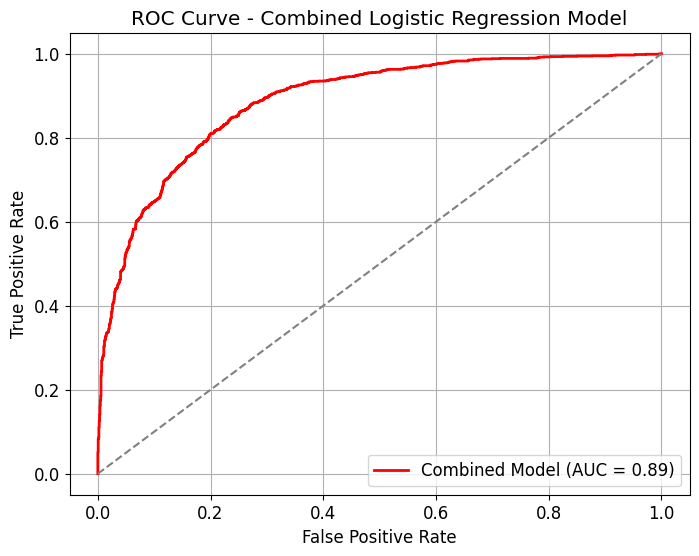

Combined Model Metrics: 
Accuracy: 0.8007
F1 Score: 0.7987
Recall: 0.7911
AUC Score: 0.8873
Precision: 0.8066


In [ ]:
X_LR_CA_resampled = df_hip_cleaned.drop(columns=['CDARREST', 'CDMI'])
y_LR_CA_resampled = df_hip_cleaned['CDARREST']

# Replace 'CDMI' with the actual target column name for CDMI
X_LR_CDMI_resampled = df1_hip_cleaned.drop(columns=['CDARREST', 'CDMI'])
y_LR_CDMI_resampled = df1_hip_cleaned['CDMI']

# Combine the feature datasets (X_LR_CA and X_LR_CDMI)
X_LR_Combined = np.concatenate((X_LR_CA_resampled, X_LR_CDMI_resampled), axis=0)
y_LR_Combined = np.concatenate((y_LR_CA_resampled, y_LR_CDMI_resampled), axis=0)

# Extract original feature names from one of the original DataFrames (e.g., X_LR_CA)
original_feature_names = X_LR_CA_resampled.columns.tolist()

# Convert the combined features into a DataFrame with the original feature names
X_LR_Combined_df = pd.DataFrame(X_LR_Combined, columns=original_feature_names)

# Create Logistic Regression models for each target
log_reg_CA = LogisticRegression(max_iter=1000)
log_reg_CDMI = LogisticRegression(max_iter=1000)

# Combine the models using VotingClassifier
voting_classifier_LR_Combined = VotingClassifier(estimators=[
    ('log_reg_CA', log_reg_CA),
    ('log_reg_CDMI', log_reg_CDMI)
], voting='soft')

# Fit the combined model using the resampled data
voting_classifier_LR_Combined.fit(X_LR_Combined, y_LR_Combined)

# Make predictions using the combined model
y_pred_combined_labels = voting_classifier_LR_Combined.predict(X_LR_Combined)

# Compute metrics for the combined model
accuracy_combined = accuracy_score(y_LR_Combined, y_pred_combined_labels)
f1_combined = f1_score(y_LR_Combined, y_pred_combined_labels)
recall_combined = recall_score(y_LR_Combined, y_pred_combined_labels)
precision_combined = precision_score(y_LR_Combined, y_pred_combined_labels)

# Compute the ROC curve and AUC for the combined model
y_pred_combined_prob = voting_classifier_LR_Combined.predict_proba(X_LR_Combined)[:, 1]
fpr_combined, tpr_combined, _ = roc_curve(y_LR_Combined, y_pred_combined_prob)
roc_auc_combined = auc(fpr_combined, tpr_combined)

# Plot ROC Curve for the combined model
plt.figure(figsize=(8, 6))
plt.plot(fpr_combined, tpr_combined, color='red', lw=2, label=f'Combined Model (AUC = {roc_auc_combined:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Combined Logistic Regression Model')
plt.legend(loc='lower right')
plt.grid()
plt.show()

# Print metrics for the combined model
print(f'Combined Model Metrics: ')
print(f'Accuracy: {accuracy_combined:.4f}')
print(f'F1 Score: {f1_combined:.4f}')
print(f'Recall: {recall_combined:.4f}')
print(f'AUC Score: {roc_auc_combined:.4f}')
print(f'Precision: {precision_combined:.4f}')

In [ ]:
# Train the Logistic Regression models (replace with actual data and model training code)
log_reg_CA.fit(X_LR_CA_resampled, y_RF_CA_resampled)
log_reg_CDMI.fit(X_LR_CDMI_resampled, y_RF_CDMI_resampled)

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

LogisticRegression(max_iter=1000)

<ipython-input-106-c50c5ea7bd6c>:17: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values_Combined, X_LR_Combined_df, plot_type="dot")


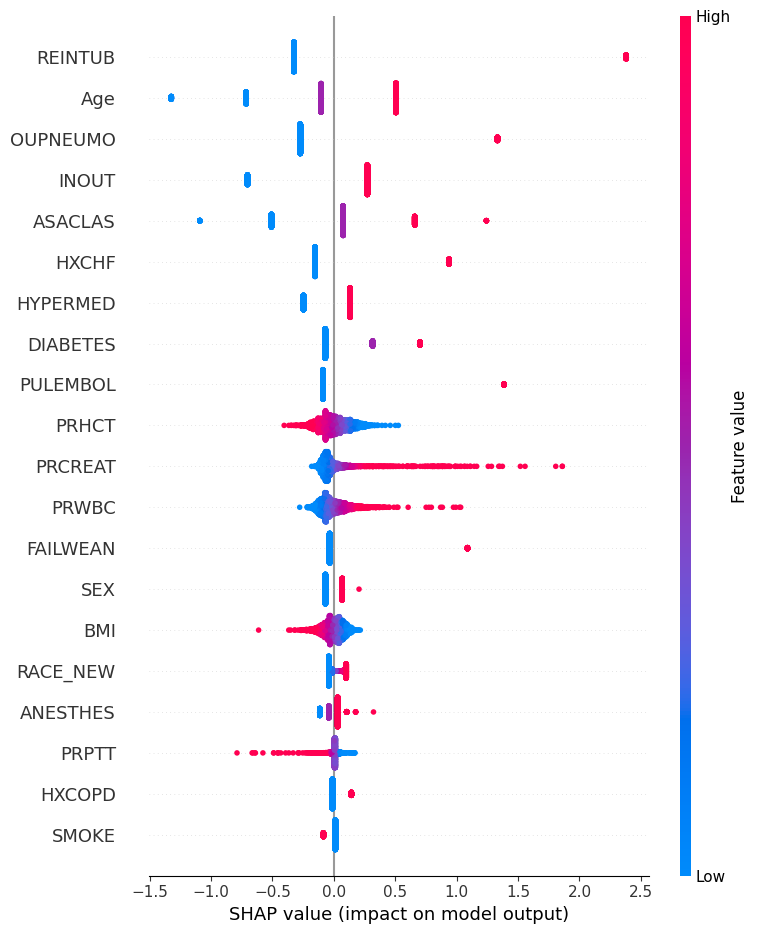

<Figure size 640x480 with 0 Axes>

In [ ]:
# Create SHAP explainers for both Logistic Regression models using LinearExplainer
explainer_LR_CA = shap.LinearExplainer(log_reg_CA, X_LR_Combined_df)
explainer_LR_CDMI = shap.LinearExplainer(log_reg_CDMI, X_LR_Combined_df)

shap_values_LR_CA = explainer_LR_CA.shap_values(X_LR_Combined_df)
shap_values_LR_CDMI = explainer_LR_CDMI.shap_values(X_LR_Combined_df)

# Combine the SHAP values from both models (average or other aggregation methods)
shap_values_Combined = (shap_values_LR_CA + shap_values_LR_CDMI) / 2

# Ensure the SHAP values have the same shape as the features matrix
assert shap_values_Combined.shape[1] == X_LR_Combined_df.shape[1], \
    f"Shape mismatch: SHAP values ({shap_values_Combined.shape[1]} features) and data ({X_LR_Combined_df.shape[1]} features)"

# Visualize SHAP values for the combined model using the default plot (dot plot)
shap.summary_plot(shap_values_Combined, X_LR_Combined_df, plot_type="dot")

plt.suptitle('SHAP Summary Plot - Combined Logistic Regression Model', fontsize=16)
plt.show()

/usr/local/lib/python3.11/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.11/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.11/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

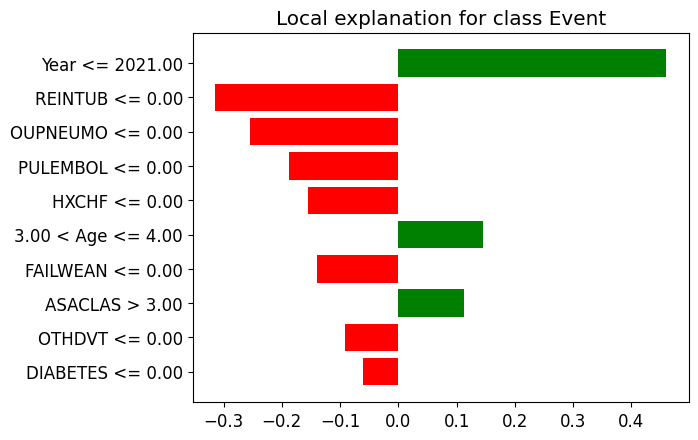

In [ ]:
# Pick a random sample to explain
random_idx_LR_Combined = np.random.randint(0, X_LR_Combined.shape[0])
random_instance_LR_Combined = X_LR_Combined_df.iloc[random_idx_LR_Combined]

# Generate the LIME explanation for this instance
lime_explanation_LR_Combined = explainer_LIME.explain_instance(random_instance_LR_Combined, voting_classifier_LR_Combined.predict_proba, num_features=10)

# Visualize the explanation
lime_explanation_LR_Combined.show_in_notebook()  # This will display the explanation in a Jupyter notebook

lime_explanation_LR_Combined.as_pyplot_figure()
plt.show()

# Neural Network

## Cardiac Arrest

In [ ]:
print(shap_values_NN_CA.shape)

In [ ]:
# Prepare the features and target variable
X_NN_CA = df_hip_cleaned.drop(['CDARREST', 'CDMI'], axis=1).values
y_NN_CA = df_hip_cleaned['CDARREST'].values

# Scale the features
scaler_NN_CA = StandardScaler()
X_scaled_NN_CA = scaler_NN_CA.fit_transform(X_NN_CA)

In [ ]:
# Hyperparameter optimization using Optuna
study_NN_CA = optuna.create_study(direction='maximize')

def objective(trial):
    units_1 = trial.suggest_int('units_1', 64, 256)
    dropout_1 = trial.suggest_float('dropout_1', 0.2, 0.5)
    units_2 = trial.suggest_int('units_2', 32, 128)
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-2, log=True)

    model_NN_CA = Sequential()
    model_NN_CA.add(Dense(units_1, input_dim=X_scaled_NN_CA.shape[1], activation='relu'))
    model_NN_CA.add(Dropout(dropout_1))
    model_NN_CA.add(Dense(units_2, activation='relu'))
    model_NN_CA.add(Dense(1, activation='sigmoid'))

    model_NN_CA.compile(optimizer=Adam(learning_rate=learning_rate),
                         loss='binary_crossentropy', metrics=['accuracy'])

    model_NN_CA.fit(X_scaled_NN_CA, y_NN_CA, epochs=10, batch_size=32, verbose=0)
    y_prob_NN_CA = model_NN_CA.predict(X_scaled_NN_CA).flatten()
    roc_auc_NN_CA = roc_auc_score(y_NN_CA, y_prob_NN_CA)

    return roc_auc_NN_CA

study_NN_CA.optimize(objective, n_trials=50)
best_params_NN_CA = study_NN_CA.best_params

# Build the model with the best parameters from Optuna
model_NN_CA = Sequential()
model_NN_CA.add(Dense(best_params_NN_CA['units_1'], input_dim=X_scaled_NN_CA.shape[1], activation='relu'))
model_NN_CA.add(Dropout(best_params_NN_CA['dropout_1']))
model_NN_CA.add(Dense(best_params_NN_CA['units_2'], activation='relu'))
model_NN_CA.add(Dense(1, activation='sigmoid'))

model_NN_CA.compile(optimizer=Adam(learning_rate=best_params_NN_CA['learning_rate']),
                     loss='binary_crossentropy', metrics=['accuracy'])

[I 2025-03-23 00:33:18,984] A new study created in memory with name: no-name-1c4500eb-5fa2-4376-aadd-5c5e3022b784
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:21,047] Trial 0 finished with value: 0.9290504534577408 and parameters: {'units_1': 141, 'dropout_1': 0.4842631240419899, 'units_2': 111, 'learning_rate': 0.00017147713831487275}. Best is trial 0 with value: 0.9290504534577408.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:22,966] Trial 1 finished with value: 0.9845864586056426 and parameters: {'units_1': 169, 'dropout_1': 0.23679335126697482, 'units_2': 65, 'learning_rate': 0.0024263019710857904}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:25,024] Trial 2 finished with value: 0.9358322105813509 and parameters: {'units_1': 191, 'dropout_1': 0.4128468097054494, 'units_2': 110, 'learning_rate': 0.00017746132447847275}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:26,909] Trial 3 finished with value: 0.9105099640049066 and parameters: {'units_1': 219, 'dropout_1': 0.29718039605408114, 'units_2': 98, 'learning_rate': 4.179535651055523e-05}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:28,730] Trial 4 finished with value: 0.921992197711597 and parameters: {'units_1': 220, 'dropout_1': 0.23233531100169338, 'units_2': 46, 'learning_rate': 8.20595443706596e-05}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:31,416] Trial 5 finished with value: 0.9799010637656096 and parameters: {'units_1': 153, 'dropout_1': 0.40546698294290723, 'units_2': 71, 'learning_rate': 0.002893192610793944}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:33,298] Trial 6 finished with value: 0.942935711556637 and parameters: {'units_1': 177, 'dropout_1': 0.335521333828674, 'units_2': 57, 'learning_rate': 0.00030015106898684474}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:35,248] Trial 7 finished with value: 0.9504615013372477 and parameters: {'units_1': 155, 'dropout_1': 0.480923916672497, 'units_2': 76, 'learning_rate': 0.0006720127886482219}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:37,307] Trial 8 finished with value: 0.9670815821753906 and parameters: {'units_1': 218, 'dropout_1': 0.26137032768538476, 'units_2': 89, 'learning_rate': 0.0007385760727241844}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:39,373] Trial 9 finished with value: 0.86852741860886 and parameters: {'units_1': 103, 'dropout_1': 0.4259008634848208, 'units_2': 70, 'learning_rate': 4.6728668344612344e-05}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:41,157] Trial 10 finished with value: 0.9811830119246314 and parameters: {'units_1': 64, 'dropout_1': 0.21285648939028673, 'units_2': 32, 'learning_rate': 0.006710732020777532}. Best is trial 1 with value: 0.9845864586056426.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:43,716] Trial 11 finished with value: 0.9881407227171267 and parameters: {'units_1': 67, 'dropout_1': 0.21437868893320983, 'units_2': 32, 'learning_rate': 0.009305825731656817}. Best is trial 11 with value: 0.9881407227171267.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:45,624] Trial 12 finished with value: 0.9922530113213618 and parameters: {'units_1': 114, 'dropout_1': 0.20164408656189584, 'units_2': 40, 'learning_rate': 0.00907949129251784}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:47,439] Trial 13 finished with value: 0.5742423937742565 and parameters: {'units_1': 67, 'dropout_1': 0.20110083803821152, 'units_2': 32, 'learning_rate': 1.1894159716094898e-05}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:49,265] Trial 14 finished with value: 0.9849534476864606 and parameters: {'units_1': 106, 'dropout_1': 0.27319909806255915, 'units_2': 48, 'learning_rate': 0.009907476006703282}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:51,096] Trial 15 finished with value: 0.9697611051901305 and parameters: {'units_1': 104, 'dropout_1': 0.3328956929858413, 'units_2': 45, 'learning_rate': 0.002232360070719042}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:52,897] Trial 16 finished with value: 0.9863108045607191 and parameters: {'units_1': 123, 'dropout_1': 0.29559756977461965, 'units_2': 58, 'learning_rate': 0.005210705404886914}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:55,486] Trial 17 finished with value: 0.956614852500553 and parameters: {'units_1': 87, 'dropout_1': 0.36611838806882024, 'units_2': 128, 'learning_rate': 0.0008609005902700156}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:57,386] Trial 18 finished with value: 0.9869341832733415 and parameters: {'units_1': 128, 'dropout_1': 0.24984933377179153, 'units_2': 39, 'learning_rate': 0.003749956716832831}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:33:59,101] Trial 19 finished with value: 0.9628938848559191 and parameters: {'units_1': 81, 'dropout_1': 0.21165816178680055, 'units_2': 56, 'learning_rate': 0.0012351317039360757}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:00,919] Trial 20 finished with value: 0.9836312815459791 and parameters: {'units_1': 87, 'dropout_1': 0.28276825776398073, 'units_2': 41, 'learning_rate': 0.009814523912571982}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


[I 2025-03-23 00:34:04,052] Trial 21 finished with value: 0.9886886927145127 and parameters: {'units_1': 133, 'dropout_1': 0.23766985452183106, 'units_2': 36, 'learning_rate': 0.004788773872291566}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:34:06,667] Trial 22 finished with value: 0.9704950833517666 and parameters: {'units_1': 124, 'dropout_1': 0.23136531690764528, 'units_2': 34, 'learning_rate': 0.0014851671349848403}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:08,944] Trial 23 finished with value: 0.9922027388445375 and parameters: {'units_1': 251, 'dropout_1': 0.20309988017955605, 'units_2': 51, 'learning_rate': 0.0050629820254758425}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:10,851] Trial 24 finished with value: 0.9915089786643608 and parameters: {'units_1': 256, 'dropout_1': 0.25040692743707654, 'units_2': 52, 'learning_rate': 0.004829991327083481}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:12,837] Trial 25 finished with value: 0.9819270445816325 and parameters: {'units_1': 256, 'dropout_1': 0.30606210658220245, 'units_2': 50, 'learning_rate': 0.001984742124987729}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:15,081] Trial 26 finished with value: 0.984465804661264 and parameters: {'units_1': 244, 'dropout_1': 0.25514329088691934, 'units_2': 62, 'learning_rate': 0.004094835826323906}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:34:17,208] Trial 27 finished with value: 0.9905990468338395 and parameters: {'units_1': 233, 'dropout_1': 0.20767918099896726, 'units_2': 84, 'learning_rate': 0.006018148051090379}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:19,722] Trial 28 finished with value: 0.9512909972048503 and parameters: {'units_1': 202, 'dropout_1': 0.3712116134662577, 'units_2': 51, 'learning_rate': 0.0004695669290428414}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:21,672] Trial 29 finished with value: 0.9798005188119608 and parameters: {'units_1': 255, 'dropout_1': 0.2683569698389487, 'units_2': 65, 'learning_rate': 0.001397058503165432}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:23,708] Trial 30 finished with value: 0.986516921715699 and parameters: {'units_1': 237, 'dropout_1': 0.31300988857596174, 'units_2': 41, 'learning_rate': 0.0033564812565763037}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:25,762] Trial 31 finished with value: 0.9875123167568218 and parameters: {'units_1': 235, 'dropout_1': 0.22165683589972202, 'units_2': 89, 'learning_rate': 0.0071645231184408655}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:27,923] Trial 32 finished with value: 0.9907951094934545 and parameters: {'units_1': 229, 'dropout_1': 0.20076858677485082, 'units_2': 79, 'learning_rate': 0.006165021817942096}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:34:30,518] Trial 33 finished with value: 0.9878591968469101 and parameters: {'units_1': 199, 'dropout_1': 0.2495983060142578, 'units_2': 98, 'learning_rate': 0.002479148121906029}. Best is trial 12 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:32,502] Trial 34 finished with value: 0.9928814172816667 and parameters: {'units_1': 245, 'dropout_1': 0.23559021523115217, 'units_2': 52, 'learning_rate': 0.00517998825716998}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:34,326] Trial 35 finished with value: 0.9901767580285146 and parameters: {'units_1': 249, 'dropout_1': 0.23655347759264148, 'units_2': 54, 'learning_rate': 0.003843206215878787}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:36,106] Trial 36 finished with value: 0.9401103983591061 and parameters: {'units_1': 178, 'dropout_1': 0.2251194802537254, 'units_2': 44, 'learning_rate': 0.000236072298119366}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-23 00:34:38,008] Trial 37 finished with value: 0.982299060910133 and parameters: {'units_1': 224, 'dropout_1': 0.281287933021854, 'units_2': 60, 'learning_rate': 0.0018348162028829931}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:39,921] Trial 38 finished with value: 0.9888897826218102 and parameters: {'units_1': 211, 'dropout_1': 0.23897907138097788, 'units_2': 69, 'learning_rate': 0.0030658987338518157}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:42,583] Trial 39 finished with value: 0.9315037503267711 and parameters: {'units_1': 242, 'dropout_1': 0.256338000112227, 'units_2': 51, 'learning_rate': 0.00013122516778445756}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:44,451] Trial 40 finished with value: 0.9598322910173138 and parameters: {'units_1': 169, 'dropout_1': 0.4733260693647406, 'units_2': 64, 'learning_rate': 0.0009992390711711712}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:46,331] Trial 41 finished with value: 0.988623338494641 and parameters: {'units_1': 227, 'dropout_1': 0.22004342826725978, 'units_2': 110, 'learning_rate': 0.005942630646454712}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:48,725] Trial 42 finished with value: 0.9869191015302942 and parameters: {'units_1': 248, 'dropout_1': 0.20939604350630509, 'units_2': 99, 'learning_rate': 0.007668896324817304}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:50,788] Trial 43 finished with value: 0.9917955317822598 and parameters: {'units_1': 209, 'dropout_1': 0.2427385674664576, 'units_2': 76, 'learning_rate': 0.0049503814620385014}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:34:52,784] Trial 44 finished with value: 0.9885177662933098 and parameters: {'units_1': 185, 'dropout_1': 0.24133573502706393, 'units_2': 76, 'learning_rate': 0.002867128679747116}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:55,241] Trial 45 finished with value: 0.953568340404995 and parameters: {'units_1': 203, 'dropout_1': 0.22328587774013842, 'units_2': 54, 'learning_rate': 0.0004936442990831134}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:57,029] Trial 46 finished with value: 0.9899555591304872 and parameters: {'units_1': 211, 'dropout_1': 0.2687558391003604, 'units_2': 46, 'learning_rate': 0.0046936252040045276}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:34:58,821] Trial 47 finished with value: 0.7199018681252388 and parameters: {'units_1': 149, 'dropout_1': 0.32760858371355844, 'units_2': 40, 'learning_rate': 1.0247603667591079e-05}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:00,696] Trial 48 finished with value: 0.8989925395644393 and parameters: {'units_1': 215, 'dropout_1': 0.20001837569752423, 'units_2': 68, 'learning_rate': 2.9709609931836916e-05}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:02,746] Trial 49 finished with value: 0.9894427798668785 and parameters: {'units_1': 242, 'dropout_1': 0.24420230112855018, 'units_2': 74, 'learning_rate': 0.00798470494525354}. Best is trial 34 with value: 0.9928814172816667.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Fold ROC AUC: 0.8900 | Accuracy: 0.4749 | Precision: 0.4749 | Recall: 1.0000 | F1: 0.6439
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.8805 | Accuracy: 0.7207 | Precision: 0.6385 | Recall: 0.9651 | F1: 0.7685
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.9139 | Accuracy: 0.8315 | Precision: 0.8971 | Recall: 0.7262 | F1: 0.8026
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.8945 | Accuracy: 0.7191 | Precision: 0.6714 | Recall: 0.9592 | F1: 0.7899
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
[I 2025-03-23 00:35:11,321] A new study created in memory with name: no-name-2c8aa499-dd3a-4534-8460-473dd330e352


Fold ROC AUC: 0.9085 | Accuracy: 0.7921 | Precision: 0.9242 | Recall: 0.6559 | F1: 0.7673

Average metrics across all folds:
Average ROC AUC: 0.8975
Average Accuracy: 0.7076
Average Precision: 0.7212
Average Recall: 0.8613
Average F1 Score: 0.7545
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:13,404] Trial 0 finished with value: 0.9763317179110781 and parameters: {'units_1': 112, 'dropout_1': 0.4294285789881733, 'units_2': 103, 'learning_rate': 0.004605293718037435}. Best is trial 0 with value: 0.9763317179110781.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:15,461] Trial 1 finished with value: 0.8140798125842064 and parameters: {'units_1': 187, 'dropout_1': 0.39350375500149803, 'units_2': 104, 'learning_rate': 1.588616958224247e-05}. Best is trial 0 with value: 0.9763317179110781.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:18,102] Trial 2 finished with value: 0.9862454503408473 and parameters: {'units_1': 186, 'dropout_1': 0.2711255245007596, 'units_2': 102, 'learning_rate': 0.0024163529899096183}. Best is trial 2 with value: 0.9862454503408473.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:19,817] Trial 3 finished with value: 0.9889300006032697 and parameters: {'units_1': 177, 'dropout_1': 0.24528062404729284, 'units_2': 42, 'learning_rate': 0.00499874843780639}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:21,713] Trial 4 finished with value: 0.8423002674495768 and parameters: {'units_1': 151, 'dropout_1': 0.2438940539396966, 'units_2': 109, 'learning_rate': 1.2462565645405152e-05}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:23,522] Trial 5 finished with value: 0.9350379054475255 and parameters: {'units_1': 101, 'dropout_1': 0.2142511363289119, 'units_2': 74, 'learning_rate': 0.00024181189266489503}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:25,309] Trial 6 finished with value: 0.928432101992801 and parameters: {'units_1': 83, 'dropout_1': 0.277779102394375, 'units_2': 44, 'learning_rate': 0.00025868455495300165}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:27,167] Trial 7 finished with value: 0.8998471716704538 and parameters: {'units_1': 186, 'dropout_1': 0.24536985901887043, 'units_2': 50, 'learning_rate': 2.9594370554379032e-05}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:29,804] Trial 8 finished with value: 0.9258832874178045 and parameters: {'units_1': 245, 'dropout_1': 0.2129018149196522, 'units_2': 101, 'learning_rate': 5.672957717622432e-05}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:31,586] Trial 9 finished with value: 0.9475557521767983 and parameters: {'units_1': 207, 'dropout_1': 0.372745539119948, 'units_2': 94, 'learning_rate': 0.0003695341386063856}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:33,506] Trial 10 finished with value: 0.9700702809226004 and parameters: {'units_1': 130, 'dropout_1': 0.49726082692569673, 'units_2': 33, 'learning_rate': 0.00902035815948911}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:35,397] Trial 11 finished with value: 0.9812433388968208 and parameters: {'units_1': 225, 'dropout_1': 0.309890238756461, 'units_2': 73, 'learning_rate': 0.0018209434547416961}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-23 00:35:37,307] Trial 12 finished with value: 0.9754720585573811 and parameters: {'units_1': 163, 'dropout_1': 0.314470213354078, 'units_2': 128, 'learning_rate': 0.0015658706270037528}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:39,216] Trial 13 finished with value: 0.9764573991031391 and parameters: {'units_1': 160, 'dropout_1': 0.30970068187148875, 'units_2': 54, 'learning_rate': 0.0019791831705957335}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:41,791] Trial 14 finished with value: 0.9571678497456212 and parameters: {'units_1': 194, 'dropout_1': 0.2685317804761879, 'units_2': 63, 'learning_rate': 0.0006803665349530082}. Best is trial 3 with value: 0.9889300006032697.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:43,770] Trial 15 finished with value: 0.9903728206881296 and parameters: {'units_1': 219, 'dropout_1': 0.33586519438928164, 'units_2': 123, 'learning_rate': 0.00839265189446612}. Best is trial 15 with value: 0.9903728206881296.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:45,826] Trial 16 finished with value: 0.9844406684228518 and parameters: {'units_1': 247, 'dropout_1': 0.3402274032363557, 'units_2': 127, 'learning_rate': 0.009360828206179325}. Best is trial 15 with value: 0.9903728206881296.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-23 00:35:47,569] Trial 17 finished with value: 0.9839128074161958 and parameters: {'units_1': 219, 'dropout_1': 0.4266585837992881, 'units_2': 33, 'learning_rate': 0.004712504686822105}. Best is trial 15 with value: 0.9903728206881296.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:35:58,987] Trial 18 finished with value: 0.948400329787448 and parameters: {'units_1': 65, 'dropout_1': 0.3537018733605094, 'units_2': 87, 'learning_rate': 0.0008677729104462022}. Best is trial 15 with value: 0.9903728206881296.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:01,284] Trial 19 finished with value: 0.9255615435661284 and parameters: {'units_1': 229, 'dropout_1': 0.48505191925854874, 'units_2': 116, 'learning_rate': 9.419321167553826e-05}. Best is trial 15 with value: 0.9903728206881296.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:36:03,744] Trial 20 finished with value: 0.9807808321100363 and parameters: {'units_1': 135, 'dropout_1': 0.4390318563315557, 'units_2': 64, 'learning_rate': 0.004386112478156426}. Best is trial 15 with value: 0.9903728206881296.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:06,444] Trial 21 finished with value: 0.9915441693981379 and parameters: {'units_1': 181, 'dropout_1': 0.27902128923771935, 'units_2': 116, 'learning_rate': 0.004033502865329491}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:08,885] Trial 22 finished with value: 0.9898399324337912 and parameters: {'units_1': 207, 'dropout_1': 0.29051876291903106, 'units_2': 116, 'learning_rate': 0.00367572218713543}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:11,215] Trial 23 finished with value: 0.9697460234470833 and parameters: {'units_1': 206, 'dropout_1': 0.33992380324653537, 'units_2': 118, 'learning_rate': 0.000941569374965034}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:13,467] Trial 24 finished with value: 0.9840133523698446 and parameters: {'units_1': 207, 'dropout_1': 0.30018736103178945, 'units_2': 117, 'learning_rate': 0.009881611909486034}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:36:16,098] Trial 25 finished with value: 0.9878139516177682 and parameters: {'units_1': 172, 'dropout_1': 0.2902183817246448, 'units_2': 122, 'learning_rate': 0.003470528038054723}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:18,467] Trial 26 finished with value: 0.9893723983993243 and parameters: {'units_1': 237, 'dropout_1': 0.3298682950885017, 'units_2': 113, 'learning_rate': 0.0029152512330719816}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-23 00:36:20,698] Trial 27 finished with value: 0.9862555048362123 and parameters: {'units_1': 215, 'dropout_1': 0.37449166093732483, 'units_2': 91, 'learning_rate': 0.0060601553444639585}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:22,795] Trial 28 finished with value: 0.9718323312352952 and parameters: {'units_1': 198, 'dropout_1': 0.363515581951355, 'units_2': 109, 'learning_rate': 0.0012500459817387552}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:24,826] Trial 29 finished with value: 0.9506324277584508 and parameters: {'units_1': 150, 'dropout_1': 0.3986953721209759, 'units_2': 123, 'learning_rate': 0.0005003064899461455}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:27,106] Trial 30 finished with value: 0.9896840877556355 and parameters: {'units_1': 237, 'dropout_1': 0.2611887337849365, 'units_2': 84, 'learning_rate': 0.006083075670386998}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:29,976] Trial 31 finished with value: 0.9870095919885781 and parameters: {'units_1': 253, 'dropout_1': 0.2581404996421734, 'units_2': 96, 'learning_rate': 0.005804184160221604}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:32,138] Trial 32 finished with value: 0.989885177662933 and parameters: {'units_1': 238, 'dropout_1': 0.28716725667877946, 'units_2': 84, 'learning_rate': 0.006669124838416056}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:34,324] Trial 33 finished with value: 0.982495123569748 and parameters: {'units_1': 233, 'dropout_1': 0.2908915247517855, 'units_2': 108, 'learning_rate': 0.002918729863637675}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:36,430] Trial 34 finished with value: 0.9891310905105672 and parameters: {'units_1': 218, 'dropout_1': 0.32905048044183943, 'units_2': 99, 'learning_rate': 0.0034678434194348735}. Best is trial 21 with value: 0.9915441693981379.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:38,939] Trial 35 finished with value: 0.9924591284763418 and parameters: {'units_1': 179, 'dropout_1': 0.22783053649286744, 'units_2': 122, 'learning_rate': 0.006531035665190324}. Best is trial 35 with value: 0.9924591284763418.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-23 00:36:41,820] Trial 36 finished with value: 0.9915391421504555 and parameters: {'units_1': 179, 'dropout_1': 0.22990919198830997, 'units_2': 108, 'learning_rate': 0.00804786507649582}. Best is trial 35 with value: 0.9924591284763418.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-23 00:36:43,787] Trial 37 finished with value: 0.9853556275010558 and parameters: {'units_1': 175, 'dropout_1': 0.22802903551679854, 'units_2': 107, 'learning_rate': 0.002431045078439059}. Best is trial 35 with value: 0.9924591284763418.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:45,975] Trial 38 finished with value: 0.931021134549257 and parameters: {'units_1': 138, 'dropout_1': 0.22832917260376884, 'units_2': 124, 'learning_rate': 0.0001537617112482543}. Best is trial 35 with value: 0.9924591284763418.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:48,144] Trial 39 finished with value: 0.9938667578274246 and parameters: {'units_1': 182, 'dropout_1': 0.2005294809771576, 'units_2': 112, 'learning_rate': 0.006995612594220573}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:50,373] Trial 40 finished with value: 0.9796999738583121 and parameters: {'units_1': 183, 'dropout_1': 0.20987867698541046, 'units_2': 104, 'learning_rate': 0.0014508104770644418}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:53,086] Trial 41 finished with value: 0.9905688833477446 and parameters: {'units_1': 167, 'dropout_1': 0.23493702882951756, 'units_2': 112, 'learning_rate': 0.007268688606349973}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-23 00:36:55,045] Trial 42 finished with value: 0.9905638561000624 and parameters: {'units_1': 164, 'dropout_1': 0.23307539925085602, 'units_2': 111, 'learning_rate': 0.006803396812870778}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:57,461] Trial 43 finished with value: 0.9932232701240726 and parameters: {'units_1': 149, 'dropout_1': 0.24873917775388132, 'units_2': 104, 'learning_rate': 0.004397988884238988}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:36:59,538] Trial 44 finished with value: 0.9891109815198375 and parameters: {'units_1': 116, 'dropout_1': 0.2006754371609677, 'units_2': 100, 'learning_rate': 0.004744240548899013}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:37:01,641] Trial 45 finished with value: 0.8913310140964025 and parameters: {'units_1': 152, 'dropout_1': 0.24755543520452702, 'units_2': 104, 'learning_rate': 2.294181777067825e-05}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:37:04,238] Trial 46 finished with value: 0.9863359407991312 and parameters: {'units_1': 183, 'dropout_1': 0.21854536305073874, 'units_2': 120, 'learning_rate': 0.0023538534574290815}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:37:06,282] Trial 47 finished with value: 0.9902220032576565 and parameters: {'units_1': 194, 'dropout_1': 0.25027172306352885, 'units_2': 94, 'learning_rate': 0.004602284252591294}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-23 00:37:08,252] Trial 48 finished with value: 0.9850087474109674 and parameters: {'units_1': 153, 'dropout_1': 0.27334246324561556, 'units_2': 114, 'learning_rate': 0.0097441599341526}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:37:10,239] Trial 49 finished with value: 0.9854410907116572 and parameters: {'units_1': 144, 'dropout_1': 0.2180844157029192, 'units_2': 107, 'learning_rate': 0.0020735503331703754}. Best is trial 39 with value: 0.9938667578274246.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 

Average metrics across all folds:
Average ROC AUC: 0.9647
Average Accuracy: 0.9206
Average Precision: 0.9274
Average Recall: 0.9087
Average F1 Score: 0.9175


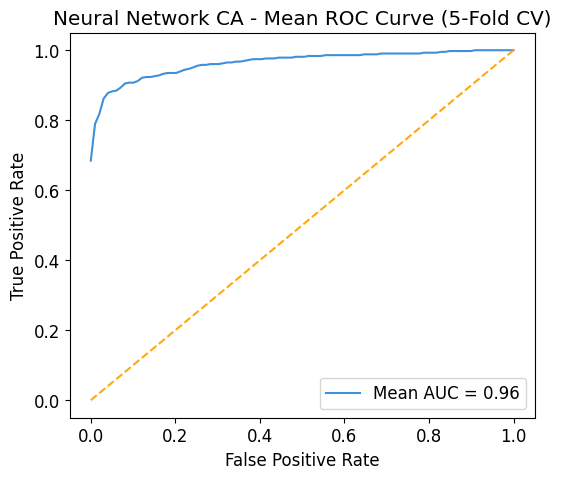

In [ ]:
# K-fold Cross-validation with additional metrics for Neural Network with CA
kf_NN_CA = KFold(n_splits=5, shuffle=True, random_state=42)

roc_auc_scores_NN_CA = []
accuracy_scores_NN_CA = []
precision_scores_NN_CA = []
recall_scores_NN_CA = []
f1_scores_NN_CA = []

fpr_list_NN_CA, tpr_list_NN_CA = [], []

for train_index, test_index in kf_NN_CA.split(X_NN_CA):
    X_train_NN_CA, X_test_NN_CA = X_NN_CA[train_index], X_NN_CA[test_index]
    y_train_NN_CA, y_test_NN_CA = y_NN_CA[train_index], y_NN_CA[test_index]

    model_NN_CA.fit(X_train_NN_CA, y_train_NN_CA, epochs=20, batch_size=32, verbose=0)
    y_prob_NN_CA = model_NN_CA.predict(X_test_NN_CA).flatten()
    y_pred_NN_CA = (y_prob_NN_CA > 0.5).astype(int)

    fpr_NN_CA, tpr_NN_CA, _ = roc_curve(y_test_NN_CA, y_prob_NN_CA)
    roc_auc_NN_CA = roc_auc_score(y_test_NN_CA, y_prob_NN_CA)

    fpr_list_NN_CA.append(fpr_NN_CA)
    tpr_list_NN_CA.append(tpr_NN_CA)
    roc_auc_scores_NN_CA.append(roc_auc_NN_CA)

    accuracy_NN_CA = accuracy_score(y_test_NN_CA, y_pred_NN_CA)
    precision_NN_CA = precision_score(y_test_NN_CA, y_pred_NN_CA)
    recall_NN_CA = recall_score(y_test_NN_CA, y_pred_NN_CA)
    f1_NN_CA = f1_score(y_test_NN_CA, y_pred_NN_CA)

    accuracy_scores_NN_CA.append(accuracy_NN_CA)
    precision_scores_NN_CA.append(precision_NN_CA)
    recall_scores_NN_CA.append(recall_NN_CA)
    f1_scores_NN_CA.append(f1_NN_CA)

    print(f"Fold ROC AUC: {roc_auc_NN_CA:.4f} | Accuracy: {accuracy_NN_CA:.4f} | Precision: {precision_NN_CA:.4f} | Recall: {recall_NN_CA:.4f} | F1: {f1_NN_CA:.4f}")

# Average ROC metrics across folds
mean_fpr_NN_CA = np.linspace(0, 1, 100)
mean_tpr_NN_CA = np.zeros_like(mean_fpr_NN_CA)

# Interpolating ROC curves
for fpr_NN_CA, tpr_NN_CA in zip(fpr_list_NN_CA, tpr_list_NN_CA):
    mean_tpr_NN_CA += np.interp(mean_fpr_NN_CA, fpr_NN_CA, tpr_NN_CA)

mean_tpr_NN_CA /= len(fpr_list_NN_CA)
mean_roc_auc_NN_CA = np.mean(roc_auc_scores_NN_CA)

# Calculate the mean of other metrics
mean_accuracy_NN_CA = np.mean(accuracy_scores_NN_CA)
mean_precision_NN_CA = np.mean(precision_scores_NN_CA)
mean_recall_NN_CA = np.mean(recall_scores_NN_CA)
mean_f1_NN_CA = np.mean(f1_scores_NN_CA)

print(f"\nAverage metrics across all folds:")
print(f"Average ROC AUC: {mean_roc_auc_NN_CA:.4f}")
print(f"Average Accuracy: {mean_accuracy_NN_CA:.4f}")
print(f"Average Precision: {mean_precision_NN_CA:.4f}")
print(f"Average Recall: {mean_recall_NN_CA:.4f}")
print(f"Average F1 Score: {mean_f1_NN_CA:.4f}")

# Feature scaling
scaler_NN_CA = StandardScaler()
X_scaled_NN_CA = scaler_NN_CA.fit_transform(X_NN_CA)

# Model creation for Neural Network with CA (NN_CA)
model_NN_CA = Sequential()
model_NN_CA.add(Dense(units=128, input_dim=X_scaled_NN_CA.shape[1], activation='relu'))
model_NN_CA.add(Dropout(0.2))
model_NN_CA.add(Dense(units=64, activation='relu'))
model_NN_CA.add(Dense(1, activation='sigmoid'))

model_NN_CA.compile(optimizer=Adam(learning_rate=0.001),
                     loss='binary_crossentropy', metrics=['accuracy'])

# Hyperparameter optimization with Optuna for NN_CA model
def optimize_nn_CA_with_optuna():
    def objective(trial):
        units_1 = trial.suggest_int('units_1', 64, 256)
        dropout_1 = trial.suggest_float('dropout_1', 0.2, 0.5)
        units_2 = trial.suggest_int('units_2', 32, 128)
        learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-2, log=True)

        model_NN_CA = Sequential()
        model_NN_CA.add(Dense(units=units_1, input_dim=X_scaled_NN_CA.shape[1], activation='relu'))
        model_NN_CA.add(Dropout(dropout_1))
        model_NN_CA.add(Dense(units=units_2, activation='relu'))
        model_NN_CA.add(Dense(1, activation='sigmoid'))

        model_NN_CA.compile(optimizer=Adam(learning_rate=learning_rate),
                             loss='binary_crossentropy', metrics=['accuracy'])
        model_NN_CA.fit(X_scaled_NN_CA, y_NN_CA, epochs=10, batch_size=32, verbose=0)
        y_prob_NN_CA = model_NN_CA.predict(X_scaled_NN_CA).flatten()
        roc_auc_NN_CA = roc_auc_score(y_NN_CA, y_prob_NN_CA)

        return roc_auc_NN_CA

    study_NN_CA = optuna.create_study(direction='maximize')
    study_NN_CA.optimize(objective, n_trials=50)

    return study_NN_CA.best_params

# Run K-fold cross-validation and metrics calculation for Neural Network CA model
best_params_NN_CA = optimize_nn_CA_with_optuna()
model_NN_CA = Sequential()
model_NN_CA.add(Dense(units=best_params_NN_CA['units_1'], input_dim=X_scaled_NN_CA.shape[1], activation='relu'))
model_NN_CA.add(Dropout(best_params_NN_CA['dropout_1']))
model_NN_CA.add(Dense(units=best_params_NN_CA['units_2'], activation='relu'))
model_NN_CA.add(Dense(1, activation='sigmoid'))

model_NN_CA.compile(optimizer=Adam(learning_rate=best_params_NN_CA['learning_rate']),
                     loss='binary_crossentropy', metrics=['accuracy'])

# K-fold cross-validation with NN_CA
kf_NN_CA = KFold(n_splits=5, shuffle=True, random_state=42)

roc_auc_scores_NN_CA = []
accuracy_scores_NN_CA = []
precision_scores_NN_CA = []
recall_scores_NN_CA = []
f1_scores_NN_CA = []

fpr_list_NN_CA, tpr_list_NN_CA = [], []

for train_index, test_index in kf_NN_CA.split(X_scaled_NN_CA):
    X_train_NN_CA, X_test_NN_CA = X_scaled_NN_CA[train_index], X_scaled_NN_CA[test_index]
    y_train_NN_CA, y_test_NN_CA = y_NN_CA[train_index], y_NN_CA[test_index]

    model_NN_CA.fit(X_train_NN_CA, y_train_NN_CA, epochs=20, batch_size=32, verbose=0)
    y_prob_NN_CA = model_NN_CA.predict(X_test_NN_CA).flatten()
    y_pred_NN_CA = (y_prob_NN_CA > 0.5).astype(int)

    fpr_NN_CA, tpr_NN_CA, _ = roc_curve(y_test_NN_CA, y_prob_NN_CA)
    roc_auc_NN_CA = roc_auc_score(y_test_NN_CA, y_prob_NN_CA)

    fpr_list_NN_CA.append(fpr_NN_CA)
    tpr_list_NN_CA.append(tpr_NN_CA)
    roc_auc_scores_NN_CA.append(roc_auc_NN_CA)

    accuracy_NN_CA = accuracy_score(y_test_NN_CA, y_pred_NN_CA)
    precision_NN_CA = precision_score(y_test_NN_CA, y_pred_NN_CA)
    recall_NN_CA = recall_score(y_test_NN_CA, y_pred_NN_CA)
    f1_NN_CA = f1_score(y_test_NN_CA, y_pred_NN_CA)

    accuracy_scores_NN_CA.append(accuracy_NN_CA)
    precision_scores_NN_CA.append(precision_NN_CA)
    recall_scores_NN_CA.append(recall_NN_CA)
    f1_scores_NN_CA.append(f1_NN_CA)

mean_fpr_NN_CA = np.linspace(0, 1, 100)
mean_tpr_NN_CA = np.zeros_like(mean_fpr_NN_CA)

for fpr_NN_CA, tpr_NN_CA in zip(fpr_list_NN_CA, tpr_list_NN_CA):
    mean_tpr_NN_CA += np.interp(mean_fpr_NN_CA, fpr_NN_CA, tpr_NN_CA)

mean_tpr_NN_CA /= len(fpr_list_NN_CA)
mean_roc_auc_NN_CA = np.mean(roc_auc_scores_NN_CA)

mean_accuracy_NN_CA = np.mean(accuracy_scores_NN_CA)
mean_precision_NN_CA = np.mean(precision_scores_NN_CA)
mean_recall_NN_CA = np.mean(recall_scores_NN_CA)
mean_f1_NN_CA = np.mean(f1_scores_NN_CA)

print(f"\nAverage metrics across all folds:")
print(f"Average ROC AUC: {mean_roc_auc_NN_CA:.4f}")
print(f"Average Accuracy: {mean_accuracy_NN_CA:.4f}")
print(f"Average Precision: {mean_precision_NN_CA:.4f}")
print(f"Average Recall: {mean_recall_NN_CA:.4f}")
print(f"Average F1 Score: {mean_f1_NN_CA:.4f}")

# Plot ROC curve
plt.figure(figsize=(6, 5))
plt.plot(mean_fpr_NN_CA, mean_tpr_NN_CA, label=f'Mean AUC = {mean_roc_auc_NN_CA:.2f}')
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Neural Network CA - Mean ROC Curve (5-Fold CV)')
plt.legend()
plt.show()

<Figure size 1800x1000 with 0 Axes>

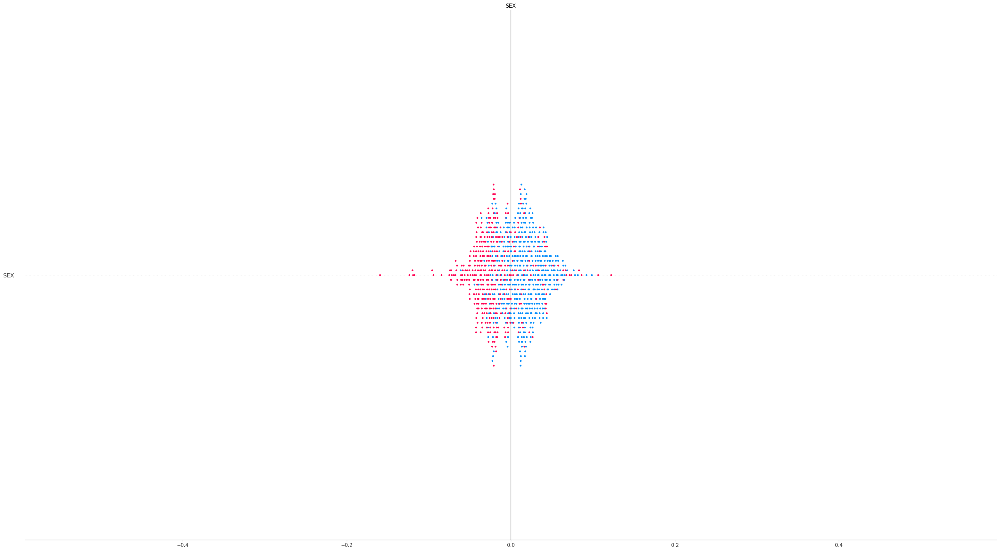

In [ ]:
feature_names_NN_CA = df_hip_cleaned.drop(columns=["CDARREST", "CDMI"]).columns.tolist()

# Create the plot with proper parameters
plt.figure(figsize=(18, 10))
shap.summary_plot(
    shap_values_NN_CA,
    X_scaled_NN_CA,
    feature_names=feature_names_NN_CA,
    plot_type="bar",
    max_display=20,
    show=False
)


Reshaped SHAP values from (892, 26, 1) to (892, 26)


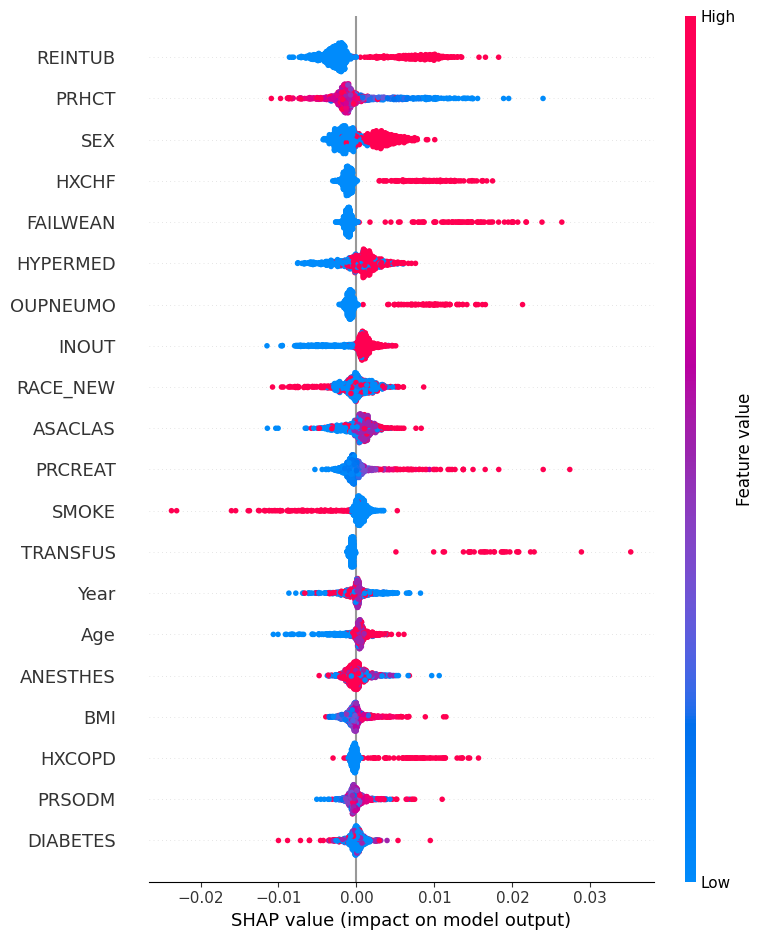


Feature importance ranking:
REINTUB: 0.0042
PRHCT: 0.0028
SEX: 0.0024
HXCHF: 0.0023
FAILWEAN: 0.0020
HYPERMED: 0.0018
OUPNEUMO: 0.0018
INOUT: 0.0016
RACE_NEW: 0.0016
ASACLAS: 0.0014
PRCREAT: 0.0013
SMOKE: 0.0013
TRANSFUS: 0.0012
Year: 0.0012
Age: 0.0011
ANESTHES: 0.0010
BMI: 0.0009
HXCOPD: 0.0009
PRSODM: 0.0008
DIABETES: 0.0007
PULEMBOL: 0.0007
PRWBC: 0.0007
DISCANCR: 0.0006
PRPTT: 0.0004
OTHDVT: 0.0003
CPT: 0.0000


In [ ]:
# Generate SHAP values
background = X_scaled_NN_CA[np.random.choice(X_scaled_NN_CA.shape[0], 100, replace=False)]
explainer = shap.DeepExplainer(model_NN_CA, background)
shap_values = explainer.shap_values(X_scaled_NN_CA)

# For binary classification, shap_values is a list with one element
if isinstance(shap_values, list):
    shap_values = shap_values[0]

# Reshape the 3D array to 2D by removing the last dimension
shap_values_2d = shap_values.reshape(shap_values.shape[0], shap_values.shape[1])
print(f"Reshaped SHAP values from {shap_values.shape} to {shap_values_2d.shape}")

# Now create the summary plot with the reshaped values
shap.summary_plot(shap_values_2d, X_scaled_NN_CA, feature_names=feature_names_NN_CA)

# Also create a DataFrame for analysis
shap_df = pd.DataFrame(shap_values_2d, columns=feature_names_NN_CA)

# Calculate and print feature importance
feature_importance = np.abs(shap_df).mean().sort_values(ascending=False)
print("\nFeature importance ranking:")
for feature, importance in feature_importance.items():
    print(f"{feature}: {importance:.4f}")

In [ ]:
print(X_scaled_NN_CA.shape)

(892, 26)


157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 822us/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 874us/step


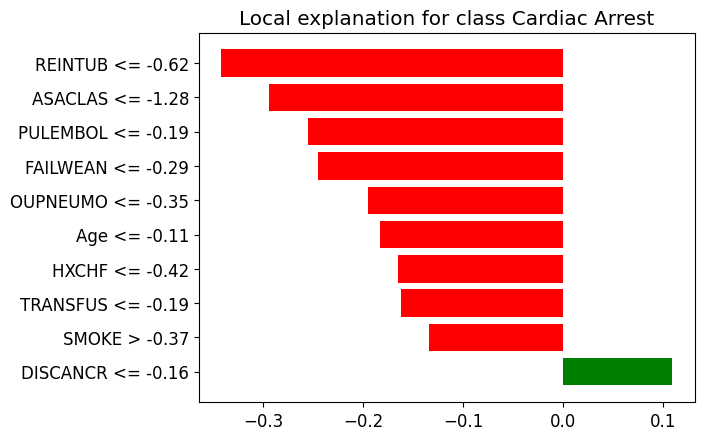

In [ ]:
# LIME Explanation for Neural Network Model with Notebook and Plot
def explain_with_lime_NN_CA(model, X_train, X_test, feature_names):
    explainer = LimeTabularExplainer(
        X_train,
        feature_names=feature_names,
        class_names=['No Cardiac Arrest', 'Cardiac Arrest'],
        mode='classification'
    )

    # Choose a random instance for explanation
    instance = X_test[0].reshape(1, -1)

    # Define a wrapper function for prediction
    def predict_fn(X):
        return np.hstack([1 - model.predict(X), model.predict(X)])

    # Get LIME explanation
    explanation = explainer.explain_instance(instance.flatten(), predict_fn, num_features=10)
k
    explanation.show_in_notebook(show_table=True, show_all=False)

    fig = explanation.as_pyplot_figure()
    plt.show()

explain_with_lime_NN_CA(model_NN_CA, X_scaled_NN_CA, X_scaled_NN_CA, feature_names_NN_CA)

## CDMI

In [ ]:
# Prepare the features and target variable
X_NN_CDMI = df_hip_cleaned.drop(['CDARREST', 'CDMI'], axis=1).values
y_NN_CDMI = df_hip_cleaned['CDMI'].values

# Scale the features
scaler_NN_CDMI = StandardScaler()
X_scaled_NN_CDMI = scaler_NN_CDMI.fit_transform(X_NN_CDMI)

In [ ]:
# Hyperparameter optimization using Optuna
study_NN_CDMI = optuna.create_study(direction='maximize')

def objective(trial):
    units_1 = trial.suggest_int('units_1', 64, 256)
    dropout_1 = trial.suggest_float('dropout_1', 0.2, 0.5)
    units_2 = trial.suggest_int('units_2', 32, 128)
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-2, log=True)

    model_NN_CDMI = Sequential()
    model_NN_CDMI.add(Dense(units_1, input_dim=X_scaled_NN_CDMI.shape[1], activation='relu'))
    model_NN_CDMI.add(Dropout(dropout_1))
    model_NN_CDMI.add(Dense(units_2, activation='relu'))
    model_NN_CDMI.add(Dense(1, activation='sigmoid'))

    model_NN_CDMI.compile(optimizer=Adam(learning_rate=learning_rate),
                          loss='binary_crossentropy', metrics=['accuracy'])

    model_NN_CDMI.fit(X_scaled_NN_CDMI, y_NN_CDMI, epochs=10, batch_size=32, verbose=0)
    y_prob_NN_CDMI = model_NN_CDMI.predict(X_scaled_NN_CDMI).flatten()
    roc_auc_NN_CDMI = roc_auc_score(y_NN_CDMI, y_prob_NN_CDMI)

    return roc_auc_NN_CDMI

study_NN_CDMI.optimize(objective, n_trials=50)
best_params_NN_CDMI = study_NN_CDMI.best_params

# Build the model with the best parameters from Optuna
model_NN_CDMI = Sequential()
model_NN_CDMI.add(Dense(best_params_NN_CDMI['units_1'], input_dim=X_scaled_NN_CDMI.shape[1], activation='relu'))
model_NN_CDMI.add(Dropout(best_params_NN_CDMI['dropout_1']))
model_NN_CDMI.add(Dense(best_params_NN_CDMI['units_2'], activation='relu'))
model_NN_CDMI.add(Dense(1, activation='sigmoid'))

model_NN_CDMI.compile(optimizer=Adam(learning_rate=best_params_NN_CDMI['learning_rate']),
                      loss='binary_crossentropy', metrics=['accuracy'])

[I 2025-03-22 20:56:21,296] A new study created in memory with name: no-name-11b7afbe-9a99-4052-bdb8-9b884b1e2b56
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:23,101] Trial 0 finished with value: 0.40257853937168503 and parameters: {'units_1': 135, 'dropout_1': 0.49321144242047926, 'units_2': 103, 'learning_rate': 2.1570377777188284e-05}. Best is trial 0 with value: 0.40257853937168503.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:25,594] Trial 1 finished with value: 0.9935046919624643 and parameters: {'units_1': 234, 'dropout_1': 0.43218737885895825, 'units_2': 122, 'learning_rate': 0.003968371393645908}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:27,523] Trial 2 finished with value: 0.4908200734394124 and parameters: {'units_1': 119, 'dropout_1': 0.3404958831180004, 'units_2': 99, 'learning_rate': 5.7111266782478876e-05}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:29,298] Trial 3 finished with value: 0.9680783353733169 and parameters: {'units_1': 171, 'dropout_1': 0.35875322598318293, 'units_2': 34, 'learning_rate': 0.0022507243402821783}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:31,150] Trial 4 finished with value: 0.9675234598123215 and parameters: {'units_1': 157, 'dropout_1': 0.24528376887028905, 'units_2': 119, 'learning_rate': 0.001227974909866287}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:32,824] Trial 5 finished with value: 0.8653937168502652 and parameters: {'units_1': 146, 'dropout_1': 0.2620846783955145, 'units_2': 48, 'learning_rate': 0.0003027320590228847}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-22 20:56:35,250] Trial 6 finished with value: 0.885516115871073 and parameters: {'units_1': 113, 'dropout_1': 0.33695981706859734, 'units_2': 125, 'learning_rate': 0.00045112029047090666}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:37,543] Trial 7 finished with value: 0.6898082415340676 and parameters: {'units_1': 139, 'dropout_1': 0.3352305051745943, 'units_2': 62, 'learning_rate': 8.893070256218833e-05}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:39,174] Trial 8 finished with value: 0.9917911056711547 and parameters: {'units_1': 169, 'dropout_1': 0.3928061230565185, 'units_2': 45, 'learning_rate': 0.004138168223958165}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:41,031] Trial 9 finished with value: 0.9680946552427581 and parameters: {'units_1': 246, 'dropout_1': 0.2846359047865399, 'units_2': 99, 'learning_rate': 0.001148263846915186}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:43,226] Trial 10 finished with value: 0.9921501427988576 and parameters: {'units_1': 251, 'dropout_1': 0.4631151220443232, 'units_2': 79, 'learning_rate': 0.006052793963755204}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:45,106] Trial 11 finished with value: 0.9855569155446756 and parameters: {'units_1': 253, 'dropout_1': 0.4632492185276382, 'units_2': 73, 'learning_rate': 0.009823588588921822}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:46,997] Trial 12 finished with value: 0.9871073031415749 and parameters: {'units_1': 206, 'dropout_1': 0.43848383170839034, 'units_2': 81, 'learning_rate': 0.009908625019143387}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:49,415] Trial 13 finished with value: 0.9912525499796002 and parameters: {'units_1': 224, 'dropout_1': 0.4145704515613581, 'units_2': 84, 'learning_rate': 0.003553502138253377}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:51,240] Trial 14 finished with value: 0.8473113015095879 and parameters: {'units_1': 74, 'dropout_1': 0.4934635621498192, 'units_2': 110, 'learning_rate': 0.00046644903714124604}. Best is trial 1 with value: 0.9935046919624643.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:52,921] Trial 15 finished with value: 0.998547531619747 and parameters: {'units_1': 203, 'dropout_1': 0.2032501445588315, 'units_2': 66, 'learning_rate': 0.004243176873867476}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:54,609] Trial 16 finished with value: 0.9716034271725826 and parameters: {'units_1': 204, 'dropout_1': 0.20969520381596174, 'units_2': 63, 'learning_rate': 0.0011818797257713055}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:56,263] Trial 17 finished with value: 0.8395430436556508 and parameters: {'units_1': 196, 'dropout_1': 0.3023060034715511, 'units_2': 61, 'learning_rate': 0.00016782420524650353}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:56:58,141] Trial 18 finished with value: 0.9921011831905345 and parameters: {'units_1': 220, 'dropout_1': 0.3835953001778596, 'units_2': 113, 'learning_rate': 0.0022559723470987627}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:01,884] Trial 19 finished with value: 0.41731538147694824 and parameters: {'units_1': 184, 'dropout_1': 0.2003897705157392, 'units_2': 90, 'learning_rate': 1.3737295200668735e-05}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:03,661] Trial 20 finished with value: 0.9931130150958792 and parameters: {'units_1': 224, 'dropout_1': 0.3052966597331011, 'units_2': 71, 'learning_rate': 0.002141217240184646}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:05,705] Trial 21 finished with value: 0.9938800489596084 and parameters: {'units_1': 229, 'dropout_1': 0.23382074388049656, 'units_2': 67, 'learning_rate': 0.0021809023971551544}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:07,616] Trial 22 finished with value: 0.9970461036311709 and parameters: {'units_1': 236, 'dropout_1': 0.2259143234427116, 'units_2': 53, 'learning_rate': 0.005091923920826923}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:09,606] Trial 23 finished with value: 0.9403835169318646 and parameters: {'units_1': 190, 'dropout_1': 0.23242902305966576, 'units_2': 55, 'learning_rate': 0.0007268990747325019}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-22 20:57:11,688] Trial 24 finished with value: 0.9977804977560178 and parameters: {'units_1': 235, 'dropout_1': 0.22218204615857845, 'units_2': 36, 'learning_rate': 0.0056031529394506}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:13,757] Trial 25 finished with value: 0.9939453284373725 and parameters: {'units_1': 211, 'dropout_1': 0.26932953462531195, 'units_2': 33, 'learning_rate': 0.006864137949126756}. Best is trial 15 with value: 0.998547531619747.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:15,528] Trial 26 finished with value: 0.999249286005712 and parameters: {'units_1': 239, 'dropout_1': 0.21780060777411986, 'units_2': 43, 'learning_rate': 0.00536102549456861}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:17,137] Trial 27 finished with value: 0.9969481844145247 and parameters: {'units_1': 238, 'dropout_1': 0.21398005473698611, 'units_2': 41, 'learning_rate': 0.003422796082119504}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:18,917] Trial 28 finished with value: 0.9983843329253366 and parameters: {'units_1': 256, 'dropout_1': 0.2548339913722096, 'units_2': 40, 'learning_rate': 0.0069729710989844575}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:20,772] Trial 29 finished with value: 0.9720767033863729 and parameters: {'units_1': 254, 'dropout_1': 0.24933992723622891, 'units_2': 54, 'learning_rate': 0.0016393428135239713}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:22,438] Trial 30 finished with value: 0.6272541819665443 and parameters: {'units_1': 214, 'dropout_1': 0.27256735448844016, 'units_2': 41, 'learning_rate': 5.116583187314137e-05}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:24,805] Trial 31 finished with value: 0.9984006527947776 and parameters: {'units_1': 245, 'dropout_1': 0.22052887945063412, 'units_2': 38, 'learning_rate': 0.006791566327573055}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:26,521] Trial 32 finished with value: 0.9959608323133414 and parameters: {'units_1': 241, 'dropout_1': 0.2027169889685081, 'units_2': 47, 'learning_rate': 0.008130656383984396}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:28,188] Trial 33 finished with value: 0.9958057935536515 and parameters: {'units_1': 255, 'dropout_1': 0.2508450486995712, 'units_2': 41, 'learning_rate': 0.0033468841518539505}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:29,809] Trial 34 finished with value: 0.9927539779681762 and parameters: {'units_1': 240, 'dropout_1': 0.3092493139975506, 'units_2': 32, 'learning_rate': 0.00566082624525548}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:31,450] Trial 35 finished with value: 0.9938637290901673 and parameters: {'units_1': 176, 'dropout_1': 0.24000787404033302, 'units_2': 51, 'learning_rate': 0.003090512742561235}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:33,141] Trial 36 finished with value: 0.9907792737658099 and parameters: {'units_1': 199, 'dropout_1': 0.2885316943178534, 'units_2': 58, 'learning_rate': 0.007255712836137191}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-22 20:57:35,248] Trial 37 finished with value: 0.9717829457364341 and parameters: {'units_1': 218, 'dropout_1': 0.2559935880367783, 'units_2': 38, 'learning_rate': 0.001541378478385622}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:37,310] Trial 38 finished with value: 0.9282415340677275 and parameters: {'units_1': 121, 'dropout_1': 0.22076746589298893, 'units_2': 45, 'learning_rate': 0.0008343543742886334}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:39,078] Trial 39 finished with value: 0.9927213382292942 and parameters: {'units_1': 229, 'dropout_1': 0.32302586932100297, 'units_2': 50, 'learning_rate': 0.004324804641242209}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:41,010] Trial 40 finished with value: 0.862782537739698 and parameters: {'units_1': 245, 'dropout_1': 0.3585276002597047, 'units_2': 92, 'learning_rate': 0.000237293497978156}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:42,649] Trial 41 finished with value: 0.9961485108119135 and parameters: {'units_1': 233, 'dropout_1': 0.221862595539442, 'units_2': 37, 'learning_rate': 0.005258728853481623}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:44,329] Trial 42 finished with value: 0.9973398612811097 and parameters: {'units_1': 248, 'dropout_1': 0.2398489790426938, 'units_2': 38, 'learning_rate': 0.0026703383511390657}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:46,061] Trial 43 finished with value: 0.9905018359853122 and parameters: {'units_1': 233, 'dropout_1': 0.20029130061346623, 'units_2': 45, 'learning_rate': 0.007124496656204075}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:48,321] Trial 44 finished with value: 0.9923133414932681 and parameters: {'units_1': 154, 'dropout_1': 0.21829951077860035, 'units_2': 32, 'learning_rate': 0.005094531664647772}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:50,019] Trial 45 finished with value: 0.9928845369237046 and parameters: {'units_1': 245, 'dropout_1': 0.2786466873057615, 'units_2': 37, 'learning_rate': 0.008895804906808788}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:51,703] Trial 46 finished with value: 0.997046103631171 and parameters: {'units_1': 210, 'dropout_1': 0.25929851231924184, 'units_2': 42, 'learning_rate': 0.004255701304207551}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:53,607] Trial 47 finished with value: 0.9871889024887801 and parameters: {'units_1': 227, 'dropout_1': 0.23387364799369376, 'units_2': 48, 'learning_rate': 0.0018798934017458298}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:57:55,346] Trial 48 finished with value: 0.9927866177070583 and parameters: {'units_1': 219, 'dropout_1': 0.21987501513751703, 'units_2': 58, 'learning_rate': 0.0029936257706323116}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-22 20:57:59,597] Trial 49 finished with value: 0.912264381884945 and parameters: {'units_1': 89, 'dropout_1': 0.2899657669043801, 'units_2': 73, 'learning_rate': 0.0009123945758291786}. Best is trial 26 with value: 0.999249286005712.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
Fold ROC AUC: 0.8025 | Accuracy: 0.9106 | Precision: 0.0000 | Recall: 0.0000 | F1: 0.0000


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.8124 | Accuracy: 0.9330 | Precision: 0.0000 | Recall: 0.0000 | F1: 0.0000


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Fold ROC AUC: 0.7415 | Accuracy: 0.9326 | Precision: 0.0000 | Recall: 0.0000 | F1: 0.0000


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.7570 | Accuracy: 0.9045 | Precision: 0.0000 | Recall: 0.0000 | F1: 0.0000


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
[I 2025-03-22 20:58:07,662] A new study created in memory with name: no-name-59d9248e-3bcb-47a6-a430-05f14cc3562f


Fold ROC AUC: 0.8753 | Accuracy: 0.8989 | Precision: 0.0000 | Recall: 0.0000 | F1: 0.0000

Average metrics across all folds:
Average ROC AUC: 0.7978
Average Accuracy: 0.9159
Average Precision: 0.0000
Average Recall: 0.0000
Average F1 Score: 0.0000
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-22 20:58:10,046] Trial 0 finished with value: 0.9773643410852713 and parameters: {'units_1': 249, 'dropout_1': 0.4214264565070389, 'units_2': 75, 'learning_rate': 0.0018645001669722779}. Best is trial 0 with value: 0.9773643410852713.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:12,420] Trial 1 finished with value: 0.9896205630354957 and parameters: {'units_1': 173, 'dropout_1': 0.42796415818089895, 'units_2': 72, 'learning_rate': 0.005947947634787376}. Best is trial 1 with value: 0.9896205630354957.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:14,309] Trial 2 finished with value: 0.7845124439004487 and parameters: {'units_1': 119, 'dropout_1': 0.4272881166041683, 'units_2': 51, 'learning_rate': 0.00022812170195731565}. Best is trial 1 with value: 0.9896205630354957.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:16,084] Trial 3 finished with value: 0.9863076295389637 and parameters: {'units_1': 170, 'dropout_1': 0.29239672615643636, 'units_2': 57, 'learning_rate': 0.0026541113610719824}. Best is trial 1 with value: 0.9896205630354957.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:17,798] Trial 4 finished with value: 0.9928029375764994 and parameters: {'units_1': 169, 'dropout_1': 0.31228176043048905, 'units_2': 55, 'learning_rate': 0.0063602582062179756}. Best is trial 4 with value: 0.9928029375764994.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:19,395] Trial 5 finished with value: 0.801485108119135 and parameters: {'units_1': 199, 'dropout_1': 0.3392105436065699, 'units_2': 34, 'learning_rate': 0.00017675054607919894}. Best is trial 4 with value: 0.9928029375764994.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:21,068] Trial 6 finished with value: 0.9143859649122807 and parameters: {'units_1': 91, 'dropout_1': 0.4710894657891534, 'units_2': 90, 'learning_rate': 0.001246702284515848}. Best is trial 4 with value: 0.9928029375764994.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:23,645] Trial 7 finished with value: 0.49204406364749087 and parameters: {'units_1': 78, 'dropout_1': 0.3610003313787229, 'units_2': 124, 'learning_rate': 3.259822078900291e-05}. Best is trial 4 with value: 0.9928029375764994.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:25,376] Trial 8 finished with value: 0.9766789065687475 and parameters: {'units_1': 181, 'dropout_1': 0.4025018651926179, 'units_2': 95, 'learning_rate': 0.0022975584818790205}. Best is trial 4 with value: 0.9928029375764994.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:27,039] Trial 9 finished with value: 0.8544104447164422 and parameters: {'units_1': 144, 'dropout_1': 0.2912984260615738, 'units_2': 34, 'learning_rate': 0.00039202993800451934}. Best is trial 4 with value: 0.9928029375764994.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:28,720] Trial 10 finished with value: 0.9951856385148918 and parameters: {'units_1': 227, 'dropout_1': 0.20881428526689197, 'units_2': 112, 'learning_rate': 0.00853741629159935}. Best is trial 10 with value: 0.9951856385148918.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:30,677] Trial 11 finished with value: 0.9863565891472869 and parameters: {'units_1': 227, 'dropout_1': 0.2037165432313972, 'units_2': 119, 'learning_rate': 0.009201629378134428}. Best is trial 10 with value: 0.9951856385148918.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:32,419] Trial 12 finished with value: 0.9965075479396165 and parameters: {'units_1': 213, 'dropout_1': 0.20987289507932522, 'units_2': 107, 'learning_rate': 0.009960400288267194}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-22 20:58:34,928] Trial 13 finished with value: 0.5113504691962465 and parameters: {'units_1': 217, 'dropout_1': 0.20124805909675123, 'units_2': 109, 'learning_rate': 1.294786569063418e-05}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:36,701] Trial 14 finished with value: 0.950485516115871 and parameters: {'units_1': 253, 'dropout_1': 0.23950146310494536, 'units_2': 104, 'learning_rate': 0.0006935945663543442}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:38,388] Trial 15 finished with value: 0.7146634026927784 and parameters: {'units_1': 216, 'dropout_1': 0.25635363519200527, 'units_2': 110, 'learning_rate': 6.945666479719782e-05}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:40,060] Trial 16 finished with value: 0.9956425948592411 and parameters: {'units_1': 198, 'dropout_1': 0.24541881820101188, 'units_2': 92, 'learning_rate': 0.003642645070230958}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:41,663] Trial 17 finished with value: 0.9950877192982456 and parameters: {'units_1': 197, 'dropout_1': 0.2609050754223192, 'units_2': 86, 'learning_rate': 0.003286675606357289}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:43,528] Trial 18 finished with value: 0.939420644634843 and parameters: {'units_1': 142, 'dropout_1': 0.2375030521923832, 'units_2': 98, 'learning_rate': 0.0008709290252440869}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-22 20:58:45,586] Trial 19 finished with value: 0.995968992248062 and parameters: {'units_1': 194, 'dropout_1': 0.27521976117560387, 'units_2': 80, 'learning_rate': 0.003127866478706312}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:47,655] Trial 20 finished with value: 0.8809791921664627 and parameters: {'units_1': 147, 'dropout_1': 0.2852123452400953, 'units_2': 68, 'learning_rate': 0.00044804942818623143}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:49,424] Trial 21 finished with value: 0.9959200326397389 and parameters: {'units_1': 195, 'dropout_1': 0.23371798979609282, 'units_2': 85, 'learning_rate': 0.00416103551289917}. Best is trial 12 with value: 0.9965075479396165.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:51,125] Trial 22 finished with value: 0.9970787433700531 and parameters: {'units_1': 193, 'dropout_1': 0.22758176787262469, 'units_2': 81, 'learning_rate': 0.004511094582622892}. Best is trial 22 with value: 0.9970787433700531.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:52,853] Trial 23 finished with value: 0.9703631170950633 and parameters: {'units_1': 236, 'dropout_1': 0.2692325584450353, 'units_2': 63, 'learning_rate': 0.0013945788885458053}. Best is trial 22 with value: 0.9970787433700531.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:54,645] Trial 24 finished with value: 0.9981558547531619 and parameters: {'units_1': 210, 'dropout_1': 0.31682827270909897, 'units_2': 79, 'learning_rate': 0.004126772690417578}. Best is trial 24 with value: 0.9981558547531619.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:56,479] Trial 25 finished with value: 0.998155854753162 and parameters: {'units_1': 218, 'dropout_1': 0.32623493601207904, 'units_2': 80, 'learning_rate': 0.0053813552126576545}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:58:58,883] Trial 26 finished with value: 0.9958873929008567 and parameters: {'units_1': 240, 'dropout_1': 0.35084677756490057, 'units_2': 82, 'learning_rate': 0.005090564136201381}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:00,584] Trial 27 finished with value: 0.9284700122399021 and parameters: {'units_1': 208, 'dropout_1': 0.31754145794555366, 'units_2': 45, 'learning_rate': 0.0008907860531859919}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:02,351] Trial 28 finished with value: 0.7136026111791105 and parameters: {'units_1': 181, 'dropout_1': 0.3838432541583128, 'units_2': 77, 'learning_rate': 0.00011386923115885327}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:04,099] Trial 29 finished with value: 0.9817380660954713 and parameters: {'units_1': 247, 'dropout_1': 0.3236375024861042, 'units_2': 69, 'learning_rate': 0.001723063463215611}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:05,964] Trial 30 finished with value: 0.9774296205630355 and parameters: {'units_1': 230, 'dropout_1': 0.3760482731442419, 'units_2': 63, 'learning_rate': 0.0019494207353217895}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:07,789] Trial 31 finished with value: 0.9974541003671971 and parameters: {'units_1': 209, 'dropout_1': 0.2289957807392131, 'units_2': 100, 'learning_rate': 0.008830501226392609}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:10,372] Trial 32 finished with value: 0.9950387596899225 and parameters: {'units_1': 183, 'dropout_1': 0.3076970148188874, 'units_2': 99, 'learning_rate': 0.0057784109651578975}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:12,111] Trial 33 finished with value: 0.9854263565891473 and parameters: {'units_1': 156, 'dropout_1': 0.33712931833433846, 'units_2': 74, 'learning_rate': 0.00626188131075475}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:15,912] Trial 34 finished with value: 0.9904039167686658 and parameters: {'units_1': 206, 'dropout_1': 0.4487460748990409, 'units_2': 77, 'learning_rate': 0.004254634060045353}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:18,006] Trial 35 finished with value: 0.982749898000816 and parameters: {'units_1': 224, 'dropout_1': 0.4998085929163625, 'units_2': 88, 'learning_rate': 0.002586846479076062}. Best is trial 25 with value: 0.998155854753162.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:19,911] Trial 36 finished with value: 0.9990208078335373 and parameters: {'units_1': 164, 'dropout_1': 0.2224358342185231, 'units_2': 64, 'learning_rate': 0.007001406701236618}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:22,387] Trial 37 finished with value: 0.9923786209710322 and parameters: {'units_1': 104, 'dropout_1': 0.30684168189504896, 'units_2': 50, 'learning_rate': 0.007441455893063257}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:24,234] Trial 38 finished with value: 0.9870583435332517 and parameters: {'units_1': 127, 'dropout_1': 0.4100845216637816, 'units_2': 61, 'learning_rate': 0.005996975344294505}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:26,043] Trial 39 finished with value: 0.9697103223174215 and parameters: {'units_1': 163, 'dropout_1': 0.2205580596935118, 'units_2': 68, 'learning_rate': 0.0012944026736670636}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:27,734] Trial 40 finished with value: 0.978343533251734 and parameters: {'units_1': 129, 'dropout_1': 0.3305376937068292, 'units_2': 56, 'learning_rate': 0.002253620235324277}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:29,698] Trial 41 finished with value: 0.9925581395348837 and parameters: {'units_1': 186, 'dropout_1': 0.22880377128307497, 'units_2': 73, 'learning_rate': 0.004323571712230473}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:31,414] Trial 42 finished with value: 0.9948266013871889 and parameters: {'units_1': 172, 'dropout_1': 0.2565639408227656, 'units_2': 82, 'learning_rate': 0.009785613280223138}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


[I 2025-03-22 20:59:36,383] Trial 43 finished with value: 0.9968176254589963 and parameters: {'units_1': 204, 'dropout_1': 0.29816285034266893, 'units_2': 93, 'learning_rate': 0.006771961597950968}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


[I 2025-03-22 20:59:40,753] Trial 44 finished with value: 0.9987433700530395 and parameters: {'units_1': 188, 'dropout_1': 0.22444744777944245, 'units_2': 118, 'learning_rate': 0.002932162131783081}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:44,161] Trial 45 finished with value: 0.9961648306813545 and parameters: {'units_1': 159, 'dropout_1': 0.278647223693657, 'units_2': 122, 'learning_rate': 0.007788698638547235}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-22 20:59:46,669] Trial 46 finished with value: 0.9983190534475724 and parameters: {'units_1': 218, 'dropout_1': 0.21671880445232108, 'units_2': 118, 'learning_rate': 0.003107191461452372}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:48,952] Trial 47 finished with value: 0.9908771929824562 and parameters: {'units_1': 220, 'dropout_1': 0.3616485833099614, 'units_2': 116, 'learning_rate': 0.002831296634257592}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:51,070] Trial 48 finished with value: 0.9932272541819666 and parameters: {'units_1': 234, 'dropout_1': 0.2176797173799703, 'units_2': 126, 'learning_rate': 0.001712135737686878}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-22 20:59:53,296] Trial 49 finished with value: 0.9556915544675644 and parameters: {'units_1': 187, 'dropout_1': 0.24922205645096607, 'units_2': 115, 'learning_rate': 0.0008493923919883686}. Best is trial 36 with value: 0.9990208078335373.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Average metrics across all folds for NN_CDMI model:
Average ROC AUC: 0.8992
Average Accuracy: 0.9463
Average Precision: 0.7220
Average Recall: 0.5538
Average F1 Score: 0.6215


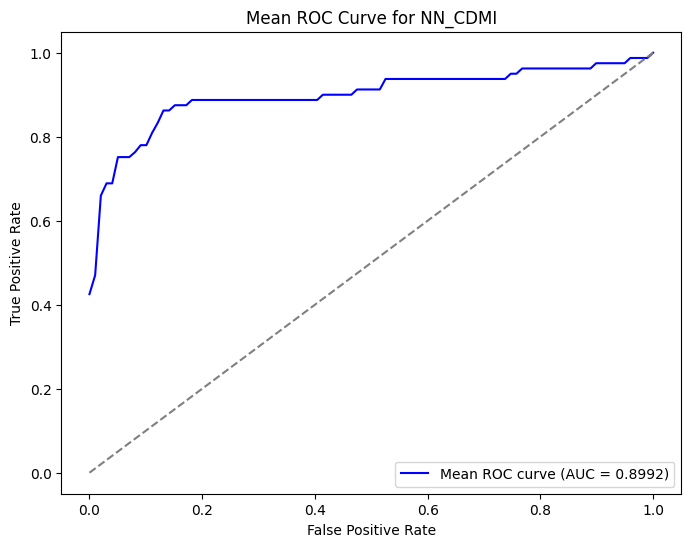

In [ ]:
# K-fold Cross-validation with additional metrics for Neural Network with CDMI
kf_NN_CDMI = KFold(n_splits=5, shuffle=True, random_state=42)

roc_auc_scores_NN_CDMI = []
accuracy_scores_NN_CDMI = []
precision_scores_NN_CDMI = []
recall_scores_NN_CDMI = []
f1_scores_NN_CDMI = []

fpr_list_NN_CDMI, tpr_list_NN_CDMI = [], []

for train_index, test_index in kf_NN_CDMI.split(X_NN_CDMI):
    X_train_NN_CDMI, X_test_NN_CDMI = X_NN_CDMI[train_index], X_NN_CDMI[test_index]
    y_train_NN_CDMI, y_test_NN_CDMI = y_NN_CDMI[train_index], y_NN_CDMI[test_index]

    model_NN_CDMI.fit(X_train_NN_CDMI, y_train_NN_CDMI, epochs=20, batch_size=32, verbose=0)
    y_prob_NN_CDMI = model_NN_CDMI.predict(X_test_NN_CDMI).flatten()
    y_pred_NN_CDMI = (y_prob_NN_CDMI > 0.5).astype(int)

    fpr_NN_CDMI, tpr_NN_CDMI, _ = roc_curve(y_test_NN_CDMI, y_prob_NN_CDMI)
    roc_auc_NN_CDMI = roc_auc_score(y_test_NN_CDMI, y_prob_NN_CDMI)

    fpr_list_NN_CDMI.append(fpr_NN_CDMI)
    tpr_list_NN_CDMI.append(tpr_NN_CDMI)
    roc_auc_scores_NN_CDMI.append(roc_auc_NN_CDMI)

    accuracy_NN_CDMI = accuracy_score(y_test_NN_CDMI, y_pred_NN_CDMI)
    precision_NN_CDMI = precision_score(y_test_NN_CDMI, y_pred_NN_CDMI)
    recall_NN_CDMI = recall_score(y_test_NN_CDMI, y_pred_NN_CDMI)
    f1_NN_CDMI = f1_score(y_test_NN_CDMI, y_pred_NN_CDMI)

    accuracy_scores_NN_CDMI.append(accuracy_NN_CDMI)
    precision_scores_NN_CDMI.append(precision_NN_CDMI)
    recall_scores_NN_CDMI.append(recall_NN_CDMI)
    f1_scores_NN_CDMI.append(f1_NN_CDMI)

    print(f"Fold ROC AUC: {roc_auc_NN_CDMI:.4f} | Accuracy: {accuracy_NN_CDMI:.4f} | Precision: {precision_NN_CDMI:.4f} | Recall: {recall_NN_CDMI:.4f} | F1: {f1_NN_CDMI:.4f}")

# Average ROC metrics across folds
mean_fpr_NN_CDMI = np.linspace(0, 1, 100)
mean_tpr_NN_CDMI = np.zeros_like(mean_fpr_NN_CDMI)

for fpr_NN_CDMI, tpr_NN_CDMI in zip(fpr_list_NN_CDMI, tpr_list_NN_CDMI):
    mean_tpr_NN_CDMI += np.interp(mean_fpr_NN_CDMI, fpr_NN_CDMI, tpr_NN_CDMI)

mean_tpr_NN_CDMI /= len(fpr_list_NN_CDMI)
mean_roc_auc_NN_CDMI = np.mean(roc_auc_scores_NN_CDMI)

# Calculate the mean of other metrics
mean_accuracy_NN_CDMI = np.mean(accuracy_scores_NN_CDMI)
mean_precision_NN_CDMI = np.mean(precision_scores_NN_CDMI)
mean_recall_NN_CDMI = np.mean(recall_scores_NN_CDMI)
mean_f1_NN_CDMI = np.mean(f1_scores_NN_CDMI)

print(f"\nAverage metrics across all folds:")
print(f"Average ROC AUC: {mean_roc_auc_NN_CDMI:.4f}")
print(f"Average Accuracy: {mean_accuracy_NN_CDMI:.4f}")
print(f"Average Precision: {mean_precision_NN_CDMI:.4f}")
print(f"Average Recall: {mean_recall_NN_CDMI:.4f}")
print(f"Average F1 Score: {mean_f1_NN_CDMI:.4f}")

# Feature scaling
scaler_NN_CDMI = StandardScaler()
X_scaled_NN_CDMI = scaler_NN_CDMI.fit_transform(X_NN_CDMI)

# Model creation for Neural Network with CDMI
model_NN_CDMI = Sequential()
model_NN_CDMI.add(Dense(units=128, input_dim=X_scaled_NN_CDMI.shape[1], activation='relu'))
model_NN_CDMI.add(Dropout(0.2))
model_NN_CDMI.add(Dense(units=64, activation='relu'))
model_NN_CDMI.add(Dense(1, activation='sigmoid'))
model_NN_CDMI.compile(optimizer=Adam(learning_rate=0.001),
                      loss='binary_crossentropy', metrics=['accuracy'])

# Hyperparameter optimization with Optuna for NN_CDMI model
def optimize_nn_CDMI_with_optuna():
    def objective(trial):
        units_1 = trial.suggest_int('units_1', 64, 256)
        dropout_1 = trial.suggest_float('dropout_1', 0.2, 0.5)
        units_2 = trial.suggest_int('units_2', 32, 128)
        learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-2, log=True)

        model_NN_CDMI = Sequential()
        model_NN_CDMI.add(Dense(units=units_1, input_dim=X_scaled_NN_CDMI.shape[1], activation='relu'))
        model_NN_CDMI.add(Dropout(dropout_1))
        model_NN_CDMI.add(Dense(units=units_2, activation='relu'))
        model_NN_CDMI.add(Dense(1, activation='sigmoid'))

        model_NN_CDMI.compile(optimizer=Adam(learning_rate=learning_rate),
                              loss='binary_crossentropy', metrics=['accuracy'])
        model_NN_CDMI.fit(X_scaled_NN_CDMI, y_NN_CDMI, epochs=10, batch_size=32, verbose=0)
        y_prob_NN_CDMI = model_NN_CDMI.predict(X_scaled_NN_CDMI).flatten()
        roc_auc_NN_CDMI = roc_auc_score(y_NN_CDMI, y_prob_NN_CDMI)

        return roc_auc_NN_CDMI

    study_NN_CDMI = optuna.create_study(direction='maximize')
    study_NN_CDMI.optimize(objective, n_trials=50)

    return study_NN_CDMI.best_params

# Run K-fold cross-validation and metrics calculation for Neural Network CDMI model
best_params_NN_CDMI = optimize_nn_CDMI_with_optuna()
model_NN_CDMI = Sequential()
model_NN_CDMI.add(Dense(units=best_params_NN_CDMI['units_1'], input_dim=X_scaled_NN_CDMI.shape[1], activation='relu'))
model_NN_CDMI.add(Dropout(best_params_NN_CDMI['dropout_1']))
model_NN_CDMI.add(Dense(units=best_params_NN_CDMI['units_2'], activation='relu'))
model_NN_CDMI.add(Dense(1, activation='sigmoid'))

model_NN_CDMI.compile(optimizer=Adam(learning_rate=best_params_NN_CDMI['learning_rate']),
                      loss='binary_crossentropy', metrics=['accuracy'])

# K-fold cross-validation with NN_CDMI
kf_NN_CDMI = KFold(n_splits=5, shuffle=True, random_state=42)

roc_auc_scores_NN_CDMI = []
accuracy_scores_NN_CDMI = []
precision_scores_NN_CDMI = []
recall_scores_NN_CDMI = []
f1_scores_NN_CDMI = []

fpr_list_NN_CDMI, tpr_list_NN_CDMI = [], []

for train_index, test_index in kf_NN_CDMI.split(X_scaled_NN_CDMI):
    X_train_NN_CDMI, X_test_NN_CDMI = X_scaled_NN_CDMI[train_index], X_scaled_NN_CDMI[test_index]
    y_train_NN_CDMI, y_test_NN_CDMI = y_NN_CDMI[train_index], y_NN_CDMI[test_index]

    model_NN_CDMI.fit(X_train_NN_CDMI, y_train_NN_CDMI, epochs=20, batch_size=32, verbose=0)
    y_prob_NN_CDMI = model_NN_CDMI.predict(X_test_NN_CDMI).flatten()
    y_pred_NN_CDMI = (y_prob_NN_CDMI > 0.5).astype(int)

    fpr_NN_CDMI, tpr_NN_CDMI, _ = roc_curve(y_test_NN_CDMI, y_prob_NN_CDMI)
    roc_auc_NN_CDMI = roc_auc_score(y_test_NN_CDMI, y_prob_NN_CDMI)

    fpr_list_NN_CDMI.append(fpr_NN_CDMI)
    tpr_list_NN_CDMI.append(tpr_NN_CDMI)
    roc_auc_scores_NN_CDMI.append(roc_auc_NN_CDMI)

    accuracy_NN_CDMI = accuracy_score(y_test_NN_CDMI, y_pred_NN_CDMI)
    precision_NN_CDMI = precision_score(y_test_NN_CDMI, y_pred_NN_CDMI)
    recall_NN_CDMI = recall_score(y_test_NN_CDMI, y_pred_NN_CDMI)
    f1_NN_CDMI = f1_score(y_test_NN_CDMI, y_pred_NN_CDMI)

    accuracy_scores_NN_CDMI.append(accuracy_NN_CDMI)
    precision_scores_NN_CDMI.append(precision_NN_CDMI)
    recall_scores_NN_CDMI.append(recall_NN_CDMI)
    f1_scores_NN_CDMI.append(f1_NN_CDMI)

mean_fpr_NN_CDMI = np.linspace(0, 1, 100)
mean_tpr_NN_CDMI = np.zeros_like(mean_fpr_NN_CDMI)

for fpr_NN_CDMI, tpr_NN_CDMI in zip(fpr_list_NN_CDMI, tpr_list_NN_CDMI):
    mean_tpr_NN_CDMI += np.interp(mean_fpr_NN_CDMI, fpr_NN_CDMI, tpr_NN_CDMI)

mean_tpr_NN_CDMI /= len(fpr_list_NN_CDMI)
mean_roc_auc_NN_CDMI = np.mean(roc_auc_scores_NN_CDMI)

mean_accuracy_NN_CDMI = np.mean(accuracy_scores_NN_CDMI)
mean_precision_NN_CDMI = np.mean(precision_scores_NN_CDMI)
mean_recall_NN_CDMI = np.mean(recall_scores_NN_CDMI)
mean_f1_NN_CDMI = np.mean(f1_scores_NN_CDMI)

print(f"\nAverage metrics across all folds for NN_CDMI model:")
print(f"Average ROC AUC: {mean_roc_auc_NN_CDMI:.4f}")
print(f"Average Accuracy: {mean_accuracy_NN_CDMI:.4f}")
print(f"Average Precision: {mean_precision_NN_CDMI:.4f}")
print(f"Average Recall: {mean_recall_NN_CDMI:.4f}")
print(f"Average F1 Score: {mean_f1_NN_CDMI:.4f}")

# Visualization of ROC curve
plt.figure(figsize=(8, 6))
plt.plot(mean_fpr_NN_CDMI, mean_tpr_NN_CDMI, color='b', label=f'Mean ROC curve (AUC = {mean_roc_auc_NN_CDMI:.4f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Mean ROC Curve for NN_CDMI')
plt.legend(loc='lower right')
plt.show()

/usr/local/lib/python3.11/dist-packages/shap/explainers/_deep/deep_tf.py:94: UserWarning: Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: keras_tensor_2255
Received: inputs=['Tensor(shape=(100, 26))']
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: keras_tensor_2255
Received: inputs=['Tensor(shape=(200, 26))']
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: keras_tensor_2255
Received: inputs=['Tensor(shape=(892, 26))']
  w

Reshaped SHAP values from (892, 26, 1) to (892, 26)


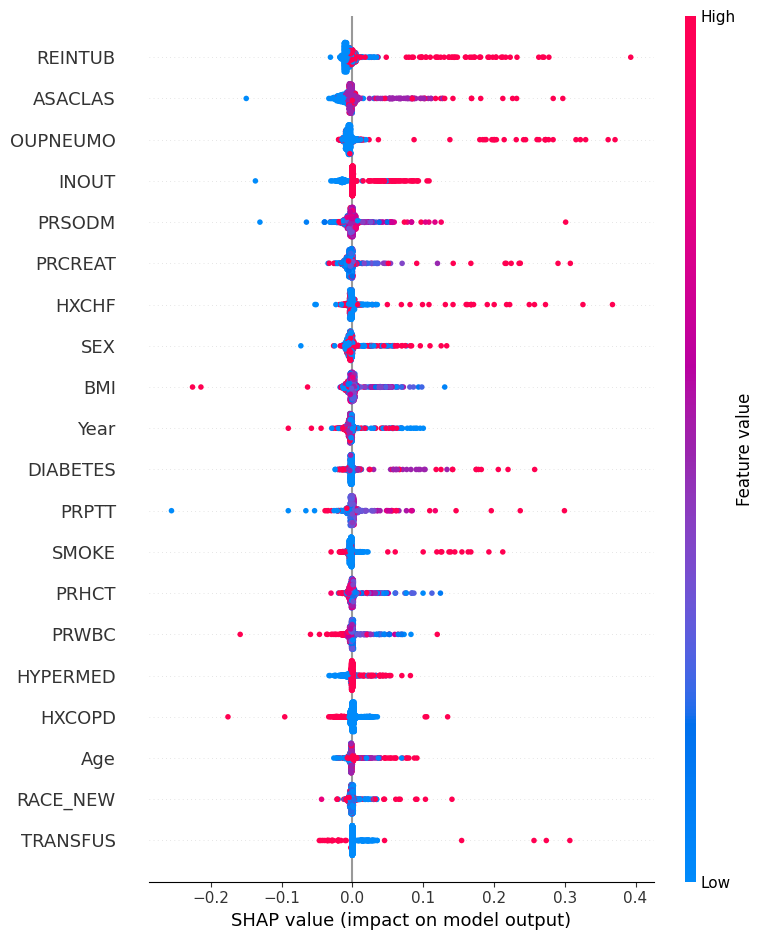


Feature importance ranking:
REINTUB: 0.0151
ASACLAS: 0.0137
OUPNEUMO: 0.0131
INOUT: 0.0078
PRSODM: 0.0074
PRCREAT: 0.0072
HXCHF: 0.0072
SEX: 0.0068
BMI: 0.0068
Year: 0.0066
DIABETES: 0.0061
PRPTT: 0.0059
SMOKE: 0.0053
PRHCT: 0.0051
PRWBC: 0.0051
HYPERMED: 0.0048
HXCOPD: 0.0046
Age: 0.0045
RACE_NEW: 0.0035
TRANSFUS: 0.0034
FAILWEAN: 0.0034
OTHDVT: 0.0032
ANESTHES: 0.0032
PULEMBOL: 0.0024
DISCANCR: 0.0013
CPT: 0.0000


In [ ]:
# Generate SHAP values
background = X_scaled_NN_CDMI[np.random.choice(X_scaled_NN_CDMI.shape[0], 100, replace=False)]
explainer = shap.DeepExplainer(model_NN_CDMI, background)
shap_values = explainer.shap_values(X_scaled_NN_CDMI)

if isinstance(shap_values, list):
    shap_values = shap_values[0]

# Reshape the 3D array to 2D by removing the last dimension
shap_values_2D = shap_values.reshape(shap_values.shape[0], shap_values.shape[1])
print(f"Reshaped SHAP values from {shap_values.shape} to {shap_values_2D.shape}")

shap.summary_plot(shap_values_2D, X_scaled_NN_CA, feature_names=feature_names_NN_CA)

shap_df = pd.DataFrame(shap_values_2D, columns=feature_names_NN_CA)

# Calculate and print feature importance
feature_importance = np.abs(shap_df).mean().sort_values(ascending=False)
print("\nFeature importance ranking:")
for feature, importance in feature_importance.items():
    print(f"{feature}: {importance:.4f}")

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 811us/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 771us/step


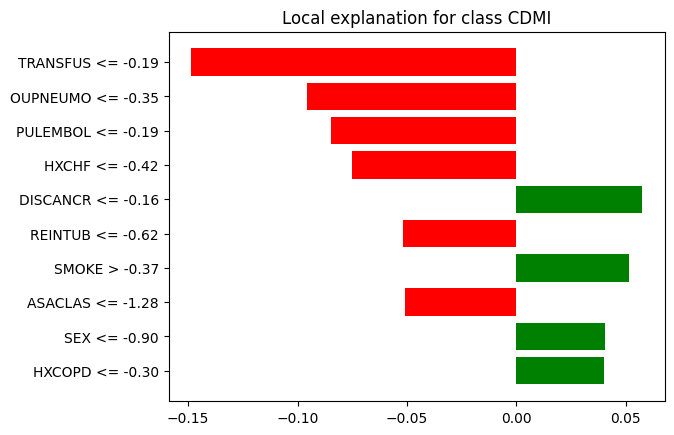

In [ ]:
# LIME Explanation for Neural Network Model with Notebook and Plot
def explain_with_lime_NN_CDMI(model, X_train, X_test, feature_names):
    explainer = LimeTabularExplainer(
        X_train,
        feature_names=feature_names,
        class_names=['No CDMI', 'CDMI'],
        mode='classification'
    )

    # Choose a random instance for explanation
    instance = X_test[0].reshape(1, -1)

    # Define a wrapper function for prediction
    def predict_fn(X):
        return np.hstack([1 - model.predict(X), model.predict(X)])
    # Get LIME explanation
    explanation = explainer.explain_instance(instance.flatten(), predict_fn, num_features=10)

    explanation.show_in_notebook(show_table=True, show_all=False)
    fig = explanation.as_pyplot_figure()
    plt.show()

explain_with_lime_NN_CDMI(model_NN_CDMI, X_scaled_NN_CDMI, X_scaled_NN_CDMI, feature_names_NN_CDMI)

## Combined

In [ ]:
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import RandomOverSampler
from sklearn.neural_network import MLPClassifier

In [ ]:
# Align the columns of both datasets by adding missing columns with NaN values
common_columns_NN_Combined = df1_hip_cleaned.columns.intersection(df_hip_cleaned.columns)

# Add missing columns in each dataset
df1_hip_cleaned = df1_hip_cleaned.reindex(columns=common_columns_NN_Combined, fill_value=np.nan)
df_hip_cleaned = df_hip_cleaned.reindex(columns=common_columns_NN_Combined, fill_value=np.nan)

# Combine the features (excluding the target columns) from both datasets
X_NN_Combined = pd.concat([df1_hip_cleaned.drop(columns=['CDMI','CDARREST']), df_hip_cleaned.drop(columns=['CDMI','CDARREST'])], axis=0)

y_NN_Combined = pd.concat([df1_hip_cleaned['CDMI'], df_hip_cleaned['CDARREST']], axis=0)

# Impute missing values using SimpleImputer
imputer_NN_Combined = SimpleImputer(strategy='mean')
X_NN_Combined_imputed = imputer_NN_Combined.fit_transform(X_NN_Combined)

# Verify the shape of the imputed data
print(f"Shape of imputed combined features: {X_NN_Combined_imputed.shape}")

# Scale the imputed features
scaler_NN_Combined = StandardScaler()
X_NN_Combined_scaled = scaler_NN_Combined.fit_transform(X_NN_Combined_imputed)

# Verify the shape of the scaled features
print(f"Shape of scaled combined features: {X_NN_Combined_scaled.shape}")

# Define and initialize the neural network classifier with more iterations
nn_classifier_NN_Combined = MLPClassifier(hidden_layer_sizes=(100,), max_iter=1000, random_state=42)

# Fit the combined model using the scaled, imputed dataset
nn_classifier_NN_Combined.fit(X_NN_Combined_scaled, y_NN_Combined)

# Make predictions using the combined model
y_pred_combined_NN_Combined = nn_classifier_NN_Combined.predict(X_NN_Combined_scaled)

# Compute metrics for the combined model
accuracy_combined_NN_Combined = accuracy_score(y_NN_Combined, y_pred_combined_NN_Combined)
f1_combined_NN_Combined = f1_score(y_NN_Combined, y_pred_combined_NN_Combined)
recall_combined_NN_Combined = recall_score(y_NN_Combined, y_pred_combined_NN_Combined)
precision_combined_NN_Combined = precision_score(y_NN_Combined, y_pred_combined_NN_Combined)

# Print metrics for the combined model
print(f'Combined NN Model Metrics: ')
print(f'Accuracy: {accuracy_combined_NN_Combined:.4f}')
print(f'F1 Score: {f1_combined_NN_Combined:.4f}')
print(f'Recall: {recall_combined_NN_Combined:.4f}')
print(f'Precision: {precision_combined_NN_Combined:.4f}')

# Get predicted probabilities
y_pred_prob_combined_NN_Combined = nn_classifier_NN_Combined.predict_proba(X_NN_Combined_scaled)[:, 1]

fpr_combined_NN_Combined, tpr_combined_NN_Combined, _ = roc_curve(y_NN_Combined, y_pred_prob_combined_NN_Combined)
roc_auc_combined_NN_Combined = auc(fpr_combined_NN_Combined, tpr_combined_NN_Combined)

# Print the AUC score
print(f'AUC Score for Combined NN Model: {roc_auc_combined_NN_Combined:.4f}')

Shape of imputed combined features: (3226, 26)
Shape of scaled combined features: (3226, 26)
Combined NN Model Metrics: 
Accuracy: 0.9892
F1 Score: 0.9891
Recall: 0.9857
Precision: 0.9925
AUC Score for Combined NN Model: 0.9996


  0%|          | 0/500 [00:00<?, ?it/s]

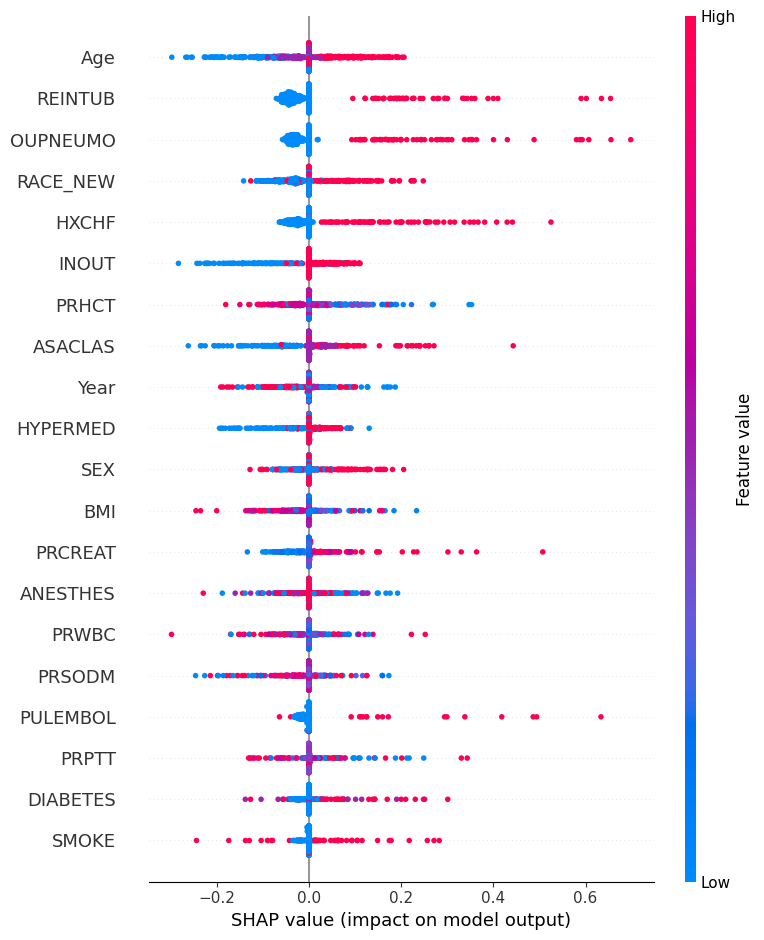

In [ ]:
# Get feature names for the X_NN_Combined dataset
feature_names_combined = X_NN_Combined.columns.tolist()

# Create a more efficient background dataset using kmeans
background_data = shap.kmeans(X_NN_Combined_scaled, 100)

# Create KernelExplainer - use class 1 probability for binary classification
explainer_NN_Combined = shap.KernelExplainer(
    lambda x: nn_classifier_NN_Combined.predict_proba(x)[:, 1],
    background_data
)

# To improve performance, calculate SHAP values on a subset of data first
sample_size = min(500, X_NN_Combined_scaled.shape[0])  # Use a maximum of 500 samples
sample_indices = np.random.choice(X_NN_Combined_scaled.shape[0], sample_size, replace=False)
sample_data = X_NN_Combined_scaled[sample_indices]

# Calculate SHAP values (this might take a few minutes)
shap_values_Combined = explainer_NN_Combined.shap_values(sample_data)

# Create a standard summary plot
plt.figure(figsize=(10, 8))
shap.summary_plot(
    shap_values_Combined,
    sample_data,
    feature_names=feature_names_combined,
    title="Feature Importance - Combined Neural Network Model"
)

<Figure size 1000x600 with 0 Axes>

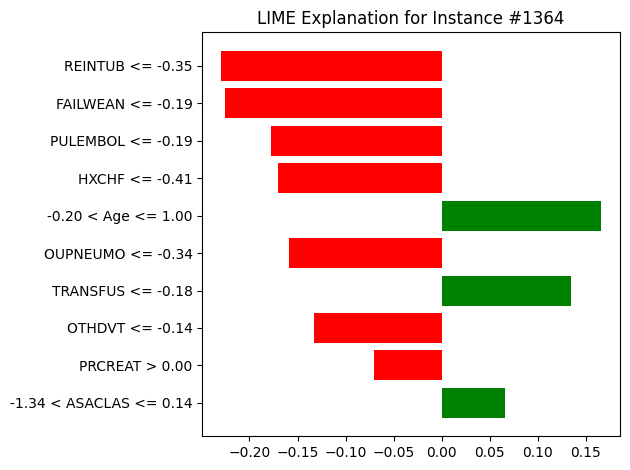

'<html>\n        <meta http-equiv="content-type" content="text/html; charset=UTF8">\n        <head><script>var lime =\n/******/ (function(modules) { // webpackBootstrap\n/******/ \t// The module cache\n/******/ \tvar installedModules = {};\n/******/\n/******/ \t// The require function\n/******/ \tfunction __webpack_require__(moduleId) {\n/******/\n/******/ \t\t// Check if module is in cache\n/******/ \t\tif(installedModules[moduleId])\n/******/ \t\t\treturn installedModules[moduleId].exports;\n/******/\n/******/ \t\t// Create a new module (and put it into the cache)\n/******/ \t\tvar module = installedModules[moduleId] = {\n/******/ \t\t\texports: {},\n/******/ \t\t\tid: moduleId,\n/******/ \t\t\tloaded: false\n/******/ \t\t};\n/******/\n/******/ \t\t// Execute the module function\n/******/ \t\tmodules[moduleId].call(module.exports, module, module.exports, __webpack_require__);\n/******/\n/******/ \t\t// Flag the module as loaded\n/******/ \t\tmodule.loaded = true;\n/******/\n/******/ 

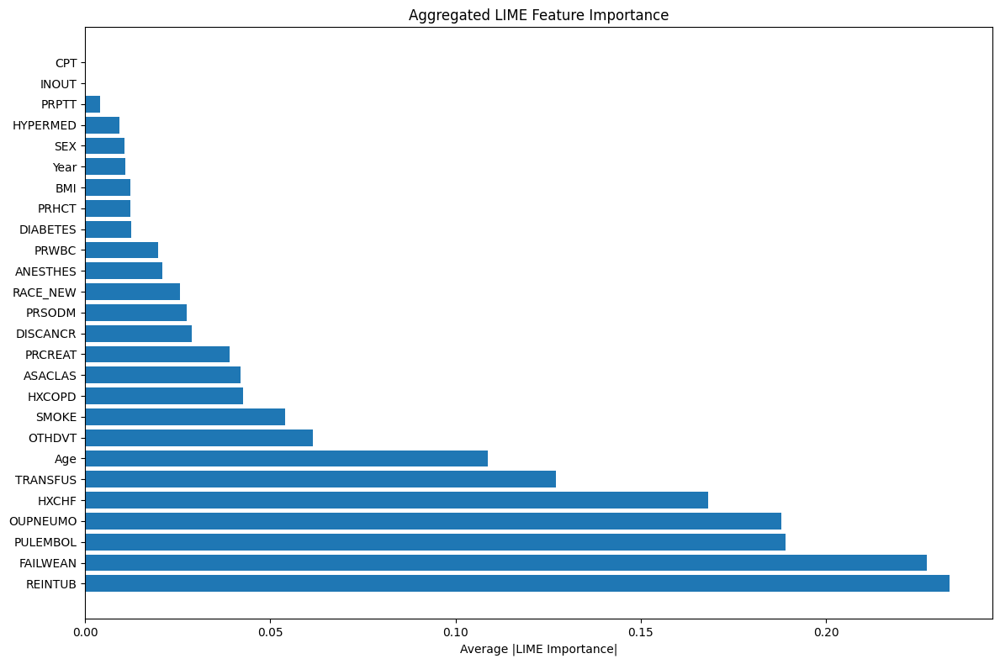

<Figure size 1400x1000 with 0 Axes>

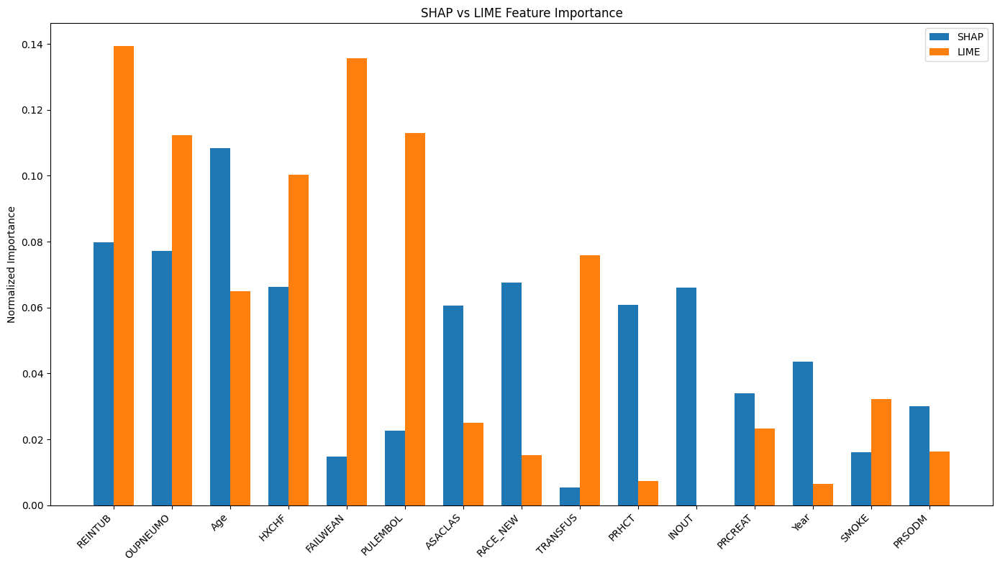

In [ ]:
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    X_NN_Combined_scaled,
    feature_names=feature_names_combined,
    class_names=['Class 0', 'Class 1'],
    mode='classification'
)


instance_idx = sample_indices[0]
instance = X_NN_Combined_scaled[instance_idx]

# Generate the LIME explanation for this instance
lime_exp = lime_explainer.explain_instance(
    instance,
    lambda x: nn_classifier_NN_Combined.predict_proba(x),
    num_features=10
)

# Plot the LIME explanation
plt.figure(figsize=(10, 6))
lime_exp.as_pyplot_figure()
plt.title("LIME Explanation for Instance #{}".format(instance_idx))
plt.tight_layout()
plt.show()

from IPython.display import display
display(lime_exp.as_html())

num_lime_samples = 10
lime_instances = np.random.choice(X_NN_Combined_scaled.shape[0], num_lime_samples, replace=False)

# Create a function to extract feature importance from LIME explanations
def get_lime_feature_importance(exp):
    feature_importance = {}
    for feature, weight in exp.as_list():
        feature_name = feature.split(' ')[0]
        feature_importance[feature_name] = abs(weight)
    return feature_importance

# Get LIME explanations for multiple instances
lime_importances = []
for idx in lime_instances:
    instance = X_NN_Combined_scaled[idx]
    exp = lime_explainer.explain_instance(
        instance,
        lambda x: nn_classifier_NN_Combined.predict_proba(x),
        num_features=len(feature_names_combined)
    )
    lime_importances.append(get_lime_feature_importance(exp))

# Aggregate LIME feature importances
lime_agg_importance = {}
for feat in feature_names_combined:
    values = [imp.get(feat, 0) for imp in lime_importances]
    lime_agg_importance[feat] = np.mean(values)

# Plot aggregated LIME feature importances
sorted_features = sorted(lime_agg_importance.items(), key=lambda x: x[1], reverse=True)
features, importances = zip(*sorted_features)

plt.figure(figsize=(12, 8))
plt.barh(range(len(features)), importances)
plt.yticks(range(len(features)), features)
plt.xlabel('Average |LIME Importance|')
plt.title('Aggregated LIME Feature Importance')
plt.tight_layout()
plt.show()

# Compare SHAP and LIME feature importances
shap_importance = {}
for i, feature in enumerate(feature_names_combined):
    shap_importance[feature] = np.mean(np.abs(shap_values_Combined[:, i]))

# Create a comparison dataframe
comparison_df = pd.DataFrame({
    'Feature': feature_names_combined,
    'SHAP Importance': [shap_importance[f] for f in feature_names_combined],
    'LIME Importance': [lime_agg_importance.get(f, 0) for f in feature_names_combined]
})

# Normalize the importances to make them comparable
comparison_df['SHAP Importance'] = comparison_df['SHAP Importance'] / comparison_df['SHAP Importance'].sum()
comparison_df['LIME Importance'] = comparison_df['LIME Importance'] / comparison_df['LIME Importance'].sum()

# Sort by average importance
comparison_df['Average Importance'] = (comparison_df['SHAP Importance'] + comparison_df['LIME Importance']) / 2
comparison_df = comparison_df.sort_values('Average Importance', ascending=False).reset_index(drop=True)

# Plot the comparison
plt.figure(figsize=(14, 10))
top_n = 15
comparison_df_top = comparison_df.head(top_n)

x = np.arange(len(comparison_df_top))
width = 0.35

fig, ax = plt.subplots(figsize=(14, 8))
rects1 = ax.bar(x - width/2, comparison_df_top['SHAP Importance'], width, label='SHAP')
rects2 = ax.bar(x + width/2, comparison_df_top['LIME Importance'], width, label='LIME')

ax.set_ylabel('Normalized Importance')
ax.set_title('SHAP vs LIME Feature Importance')
ax.set_xticks(x)
ax.set_xticklabels(comparison_df_top['Feature'], rotation=45, ha='right')
ax.legend()

plt.tight_layout()
plt.show()


# Neural Network w/ MC

## Cardiac Arrest

[I 2025-03-23 00:04:23,484] A new study created in memory with name: no-name-46c1901f-7dd8-45f5-8b28-109c39735f5b
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:04:26,454] Trial 0 finished with value: 0.9162008083814273 and parameters: {'units_1': 85, 'dropout_1': 0.36837373307686394, 'units_2': 84, 'learning_rate': 0.00013382342073848586}. Best is trial 0 with value: 0.9162008083814273.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:04:30,107] Trial 1 finished with value: 0.9768444971746869 and parameters: {'units_1': 166, 'dropout_1': 0.25000510989691827, 'units_2': 41, 'learning_rate': 0.001760981594808752}. Best is trial 1 with value: 0.9768444971746869.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:04:32,280] Trial 2 finished with value: 0.940919785235979 and parameters: {'units_1': 191, 'dropout_1': 0.41989388657732996, 'units_2': 118, 'learning_rate': 0.00023989561635120695}. Best is trial 1 with value: 0.9768444971746869.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:04:34,504] Trial 3 finished with value: 0.9026724848679845 and parameters: {'units_1': 182, 'dropout_1': 0.30240933712540696, 'units_2': 115, 'learning_rate': 2.446040599755165e-05}. Best is trial 1 with value: 0.9768444971746869.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


[I 2025-03-23 00:04:37,612] Trial 4 finished with value: 0.9911017716020833 and parameters: {'units_1': 242, 'dropout_1': 0.2111128742785584, 'units_2': 106, 'learning_rate': 0.002601703583811186}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


[I 2025-03-23 00:04:40,888] Trial 5 finished with value: 0.9854260089686099 and parameters: {'units_1': 245, 'dropout_1': 0.3588370313453916, 'units_2': 121, 'learning_rate': 0.0077018559214428696}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


[I 2025-03-23 00:04:44,586] Trial 6 finished with value: 0.9299251945544853 and parameters: {'units_1': 111, 'dropout_1': 0.43897864746022275, 'units_2': 33, 'learning_rate': 0.0003308102045484032}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:04:47,865] Trial 7 finished with value: 0.7712702849443986 and parameters: {'units_1': 136, 'dropout_1': 0.3682545490718988, 'units_2': 35, 'learning_rate': 1.5104808123036406e-05}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:04:51,013] Trial 8 finished with value: 0.9796949466106296 and parameters: {'units_1': 158, 'dropout_1': 0.44163478970552256, 'units_2': 35, 'learning_rate': 0.0066469435132471685}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:04:54,063] Trial 9 finished with value: 0.8986004142452089 and parameters: {'units_1': 232, 'dropout_1': 0.2753654757560132, 'units_2': 43, 'learning_rate': 3.3717446532372136e-05}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:04:56,015] Trial 10 finished with value: 0.9825202598081603 and parameters: {'units_1': 211, 'dropout_1': 0.21489031172306733, 'units_2': 95, 'learning_rate': 0.0016785264825276492}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:04:58,151] Trial 11 finished with value: 0.9828520581552012 and parameters: {'units_1': 251, 'dropout_1': 0.32371392549747735, 'units_2': 126, 'learning_rate': 0.009689777997883838}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:00,086] Trial 12 finished with value: 0.9818817993524905 and parameters: {'units_1': 254, 'dropout_1': 0.485004741716674, 'units_2': 104, 'learning_rate': 0.0028440923124786227}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:02,197] Trial 13 finished with value: 0.9731595246234592 and parameters: {'units_1': 219, 'dropout_1': 0.20603464287691683, 'units_2': 65, 'learning_rate': 0.0008817557294387719}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:04,141] Trial 14 finished with value: 0.9910313901345291 and parameters: {'units_1': 208, 'dropout_1': 0.3357433513940413, 'units_2': 103, 'learning_rate': 0.004389425168752824}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:06,939] Trial 15 finished with value: 0.9634368276056225 and parameters: {'units_1': 205, 'dropout_1': 0.2621138902640345, 'units_2': 100, 'learning_rate': 0.0006907115970279759}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:09,048] Trial 16 finished with value: 0.9888847553741278 and parameters: {'units_1': 224, 'dropout_1': 0.31307233223752895, 'units_2': 80, 'learning_rate': 0.0033920850204667815}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:10,830] Trial 17 finished with value: 0.9845211043857709 and parameters: {'units_1': 189, 'dropout_1': 0.4065834131009145, 'units_2': 66, 'learning_rate': 0.003764603322725279}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:12,591] Trial 18 finished with value: 0.9685897564801224 and parameters: {'units_1': 141, 'dropout_1': 0.22097071978652413, 'units_2': 109, 'learning_rate': 0.0008906852656957967}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:14,633] Trial 19 finished with value: 0.9334945404090169 and parameters: {'units_1': 234, 'dropout_1': 0.28566381711524436, 'units_2': 90, 'learning_rate': 0.0001315921246894644}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:05:17,139] Trial 20 finished with value: 0.9558657925958697 and parameters: {'units_1': 202, 'dropout_1': 0.24327214705634642, 'units_2': 76, 'learning_rate': 0.000461422717218984}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:19,147] Trial 21 finished with value: 0.9903175209636229 and parameters: {'units_1': 226, 'dropout_1': 0.3293417287169073, 'units_2': 71, 'learning_rate': 0.003626431690263657}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


[I 2025-03-23 00:05:21,770] Trial 22 finished with value: 0.9819873715538218 and parameters: {'units_1': 234, 'dropout_1': 0.3292145135147754, 'units_2': 67, 'learning_rate': 0.0016077351526455174}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:24,061] Trial 23 finished with value: 0.984350177964568 and parameters: {'units_1': 174, 'dropout_1': 0.3905076919963056, 'units_2': 53, 'learning_rate': 0.0049640576468903365}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:25,913] Trial 24 finished with value: 0.9835458183353778 and parameters: {'units_1': 216, 'dropout_1': 0.3444086249179582, 'units_2': 109, 'learning_rate': 0.0023165529940579583}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:05:28,285] Trial 25 finished with value: 0.9895684610589395 and parameters: {'units_1': 199, 'dropout_1': 0.28742517726714634, 'units_2': 90, 'learning_rate': 0.004840694176206013}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:30,789] Trial 26 finished with value: 0.9687254921675481 and parameters: {'units_1': 243, 'dropout_1': 0.4887766846570172, 'units_2': 73, 'learning_rate': 0.00120984715248858}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:32,809] Trial 27 finished with value: 0.9826308592571739 and parameters: {'units_1': 224, 'dropout_1': 0.3377717593777155, 'units_2': 54, 'learning_rate': 0.0024427370018561168}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:34,506] Trial 28 finished with value: 0.9831034205393232 and parameters: {'units_1': 73, 'dropout_1': 0.23408790919487193, 'units_2': 98, 'learning_rate': 0.009805908515796016}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:36,374] Trial 29 finished with value: 0.9181865712159907 and parameters: {'units_1': 92, 'dropout_1': 0.3878607111388531, 'units_2': 87, 'learning_rate': 0.00011694502909504653}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:38,422] Trial 30 finished with value: 0.914833397011804 and parameters: {'units_1': 146, 'dropout_1': 0.30208112861931624, 'units_2': 128, 'learning_rate': 5.904153765949484e-05}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:05:40,802] Trial 31 finished with value: 0.990594019586157 and parameters: {'units_1': 199, 'dropout_1': 0.28767233187330615, 'units_2': 91, 'learning_rate': 0.005147120188944398}. Best is trial 4 with value: 0.9911017716020833.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:43,128] Trial 32 finished with value: 0.9918860222405438 and parameters: {'units_1': 236, 'dropout_1': 0.25961595113907915, 'units_2': 83, 'learning_rate': 0.005288343628436665}. Best is trial 32 with value: 0.9918860222405438.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:45,319] Trial 33 finished with value: 0.9922530113213618 and parameters: {'units_1': 239, 'dropout_1': 0.2622146247116419, 'units_2': 83, 'learning_rate': 0.006146316660262704}. Best is trial 33 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:47,330] Trial 34 finished with value: 0.9901516217901023 and parameters: {'units_1': 256, 'dropout_1': 0.2534499878490109, 'units_2': 83, 'learning_rate': 0.0020474727160207902}. Best is trial 33 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:49,210] Trial 35 finished with value: 0.9912676707756038 and parameters: {'units_1': 237, 'dropout_1': 0.20046485060439206, 'units_2': 115, 'learning_rate': 0.0063652752462738}. Best is trial 33 with value: 0.9922530113213618.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:51,405] Trial 36 finished with value: 0.9935651229664784 and parameters: {'units_1': 242, 'dropout_1': 0.2015252296226304, 'units_2': 116, 'learning_rate': 0.007144471406814062}. Best is trial 36 with value: 0.9935651229664784.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:54,040] Trial 37 finished with value: 0.9944549458062699 and parameters: {'units_1': 244, 'dropout_1': 0.20001334753545535, 'units_2': 116, 'learning_rate': 0.007065959816368556}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:56,380] Trial 38 finished with value: 0.9875625892336464 and parameters: {'units_1': 246, 'dropout_1': 0.22464601955568714, 'units_2': 120, 'learning_rate': 0.00717673338035637}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:05:58,235] Trial 39 finished with value: 0.9856120171328602 and parameters: {'units_1': 117, 'dropout_1': 0.2631318895260632, 'units_2': 114, 'learning_rate': 0.007733336012036313}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:06:00,088] Trial 40 finished with value: 0.9431317742162522 and parameters: {'units_1': 183, 'dropout_1': 0.23579292793137294, 'units_2': 55, 'learning_rate': 0.00027259523288416344}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:06:02,346] Trial 41 finished with value: 0.9914788151782662 and parameters: {'units_1': 238, 'dropout_1': 0.20515727623379848, 'units_2': 114, 'learning_rate': 0.006788101535881421}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:06:04,996] Trial 42 finished with value: 0.9937913491121881 and parameters: {'units_1': 244, 'dropout_1': 0.22562597403241924, 'units_2': 110, 'learning_rate': 0.005980364817591212}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:06:07,085] Trial 43 finished with value: 0.9853053550242313 and parameters: {'units_1': 246, 'dropout_1': 0.22566431856253166, 'units_2': 122, 'learning_rate': 0.00967709444333266}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:06:09,280] Trial 44 finished with value: 0.9919262402220033 and parameters: {'units_1': 228, 'dropout_1': 0.24310548183868935, 'units_2': 108, 'learning_rate': 0.0030830526618033163}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:06:11,304] Trial 45 finished with value: 0.9886032295039112 and parameters: {'units_1': 255, 'dropout_1': 0.2349688654438425, 'units_2': 109, 'learning_rate': 0.002925911634478289}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:06:13,246] Trial 46 finished with value: 0.9863811860282732 and parameters: {'units_1': 226, 'dropout_1': 0.21646409683521767, 'units_2': 124, 'learning_rate': 0.001538824561811312}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:06:15,707] Trial 47 finished with value: 0.993102616179694 and parameters: {'units_1': 246, 'dropout_1': 0.24413550423953387, 'units_2': 118, 'learning_rate': 0.003653671604969367}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:06:17,991] Trial 48 finished with value: 0.8346538237245873 and parameters: {'units_1': 213, 'dropout_1': 0.27502190666669096, 'units_2': 119, 'learning_rate': 1.0342361538723782e-05}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:06:20,512] Trial 49 finished with value: 0.9411510386293712 and parameters: {'units_1': 250, 'dropout_1': 0.2010183515990899, 'units_2': 117, 'learning_rate': 0.00018665413005542841}. Best is trial 37 with value: 0.9944549458062699.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
Fold ROC AUC: 0.8940 | Accuracy: 0.8324 | Precision: 0.8235 | Recall: 0.8235 | F1: 0.8235
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.9591 | Accuracy: 0.8659 | Precision: 0.8690 | Recall: 0.8488 | F1: 0.8588
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.9859 | Accuracy: 0.9382 | Precision: 0.9294 | Recall: 0.9405 | F1: 0.9349
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.9959 | Accuracy: 0.9607 | Precision: 0.9789 | Recall: 0.9490 | F1: 0.9637
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.9973 | Accuracy: 0.9551 | Precision: 0.9670 | Recall: 0.9462 | F1: 0.9565

Average metrics across all folds:
Average ROC AUC: 0.9665
Average Accuracy: 0.9105
Average Precision: 0.9136
Average Recall: 0.9016
Average F1 Score: 0.9075


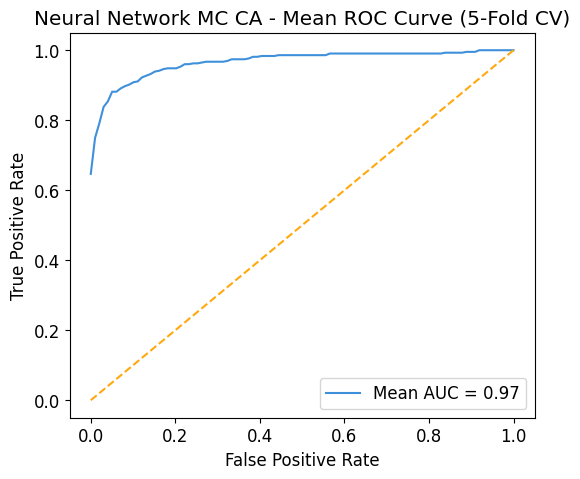

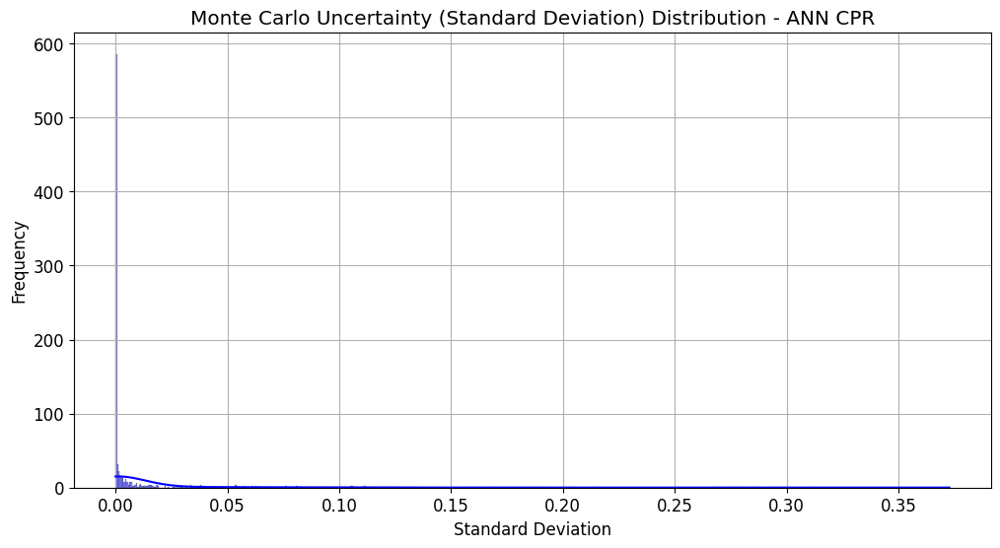

In [ ]:
# Prepare the features and target variable
X_NN_MC_CA = df_hip_cleaned.drop(['CDARREST', 'CDMI'], axis=1).values
y_NN_MC_CA = df_hip_cleaned['CDARREST'].values

# Scale the features
scaler_NN_MC_CA = StandardScaler()
X_scaled_NN_MC_CA = scaler_NN_MC_CA.fit_transform(X_NN_MC_CA)

# Hyperparameter optimization using Optuna
study_NN_MC_CA = optuna.create_study(direction='maximize')

def objective(trial):
    units_1 = trial.suggest_int('units_1', 64, 256)
    dropout_1 = trial.suggest_float('dropout_1', 0.2, 0.5)
    units_2 = trial.suggest_int('units_2', 32, 128)
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-2, log=True)

    model_NN_MC_CA = Sequential()
    model_NN_MC_CA.add(Dense(units_1, input_dim=X_scaled_NN_MC_CA.shape[1], activation='relu'))
    model_NN_MC_CA.add(Dropout(dropout_1))
    model_NN_MC_CA.add(Dense(units_2, activation='relu'))
    model_NN_MC_CA.add(Dense(1, activation='sigmoid'))

    model_NN_MC_CA.compile(optimizer=Adam(learning_rate=learning_rate),
                            loss='binary_crossentropy', metrics=['accuracy'])

    model_NN_MC_CA.fit(X_scaled_NN_MC_CA, y_NN_MC_CA, epochs=10, batch_size=32, verbose=0)
    y_prob_NN_MC_CA = model_NN_MC_CA.predict(X_scaled_NN_MC_CA).flatten()
    roc_auc_NN_MC_CA = roc_auc_score(y_NN_MC_CA, y_prob_NN_MC_CA)

    return roc_auc_NN_MC_CA

study_NN_MC_CA.optimize(objective, n_trials=50)
best_params_NN_MC_CA = study_NN_MC_CA.best_params

# Build the model with the best parameters from Optuna
model_NN_MC_CA = Sequential()
model_NN_MC_CA.add(Dense(best_params_NN_MC_CA['units_1'], input_dim=X_scaled_NN_MC_CA.shape[1], activation='relu'))
model_NN_MC_CA.add(Dropout(best_params_NN_MC_CA['dropout_1']))
model_NN_MC_CA.add(Dense(best_params_NN_MC_CA['units_2'], activation='relu'))
model_NN_MC_CA.add(Dense(1, activation='sigmoid'))

model_NN_MC_CA.compile(optimizer=Adam(learning_rate=best_params_NN_MC_CA['learning_rate']),
                        loss='binary_crossentropy', metrics=['accuracy'])

# K-fold Cross-validation with additional metrics for Neural Network with MC and CA (NN_MC_CA)
kf_NN_MC_CA = KFold(n_splits=5, shuffle=True, random_state=42)  =

roc_auc_scores_NN_MC_CA = []
accuracy_scores_NN_MC_CA = []
precision_scores_NN_MC_CA = []
recall_scores_NN_MC_CA = []
f1_scores_NN_MC_CA = []

fpr_list_NN_MC_CA, tpr_list_NN_MC_CA = [], []

for train_index, test_index in kf_NN_MC_CA.split(X_scaled_NN_MC_CA):
    X_train_NN_MC_CA, X_test_NN_MC_CA = X_scaled_NN_MC_CA[train_index], X_scaled_NN_MC_CA[test_index]
    y_train_NN_MC_CA, y_test_NN_MC_CA = y_NN_MC_CA[train_index], y_NN_MC_CA[test_index]

    model_NN_MC_CA.fit(X_train_NN_MC_CA, y_train_NN_MC_CA, epochs=20, batch_size=32, verbose=0)
    y_prob_NN_MC_CA = model_NN_MC_CA.predict(X_test_NN_MC_CA).flatten()
    y_pred_NN_MC_CA = (y_prob_NN_MC_CA > 0.5).astype(int)

    fpr_NN_MC_CA, tpr_NN_MC_CA, _ = roc_curve(y_test_NN_MC_CA, y_prob_NN_MC_CA)
    roc_auc_NN_MC_CA = roc_auc_score(y_test_NN_MC_CA, y_prob_NN_MC_CA)

    fpr_list_NN_MC_CA.append(fpr_NN_MC_CA)
    tpr_list_NN_MC_CA.append(tpr_NN_MC_CA)
    roc_auc_scores_NN_MC_CA.append(roc_auc_NN_MC_CA)

    accuracy_NN_MC_CA = accuracy_score(y_test_NN_MC_CA, y_pred_NN_MC_CA)
    precision_NN_MC_CA = precision_score(y_test_NN_MC_CA, y_pred_NN_MC_CA)
    recall_NN_MC_CA = recall_score(y_test_NN_MC_CA, y_pred_NN_MC_CA)
    f1_NN_MC_CA = f1_score(y_test_NN_MC_CA, y_pred_NN_MC_CA)

    accuracy_scores_NN_MC_CA.append(accuracy_NN_MC_CA)
    precision_scores_NN_MC_CA.append(precision_NN_MC_CA)
    recall_scores_NN_MC_CA.append(recall_NN_MC_CA)
    f1_scores_NN_MC_CA.append(f1_NN_MC_CA)

    print(f"Fold ROC AUC: {roc_auc_NN_MC_CA:.4f} | Accuracy: {accuracy_NN_MC_CA:.4f} | Precision: {precision_NN_MC_CA:.4f} | Recall: {recall_NN_MC_CA:.4f} | F1: {f1_NN_MC_CA:.4f}")

# Average ROC metrics across folds
mean_fpr_NN_MC_CA = np.linspace(0, 1, 100)
mean_tpr_NN_MC_CA = np.zeros_like(mean_fpr_NN_MC_CA)

# Interpolating ROC curves
for fpr_NN_MC_CA, tpr_NN_MC_CA in zip(fpr_list_NN_MC_CA, tpr_list_NN_MC_CA):
    mean_tpr_NN_MC_CA += np.interp(mean_fpr_NN_MC_CA, fpr_NN_MC_CA, tpr_NN_MC_CA)

mean_tpr_NN_MC_CA /= len(fpr_list_NN_MC_CA)
mean_roc_auc_NN_MC_CA = np.mean(roc_auc_scores_NN_MC_CA)

# Calculate the mean of other metrics
mean_accuracy_NN_MC_CA = np.mean(accuracy_scores_NN_MC_CA)
mean_precision_NN_MC_CA = np.mean(precision_scores_NN_MC_CA)
mean_recall_NN_MC_CA = np.mean(recall_scores_NN_MC_CA)
mean_f1_NN_MC_CA = np.mean(f1_scores_NN_MC_CA)

print(f"\nAverage metrics across all folds:")
print(f"Average ROC AUC: {mean_roc_auc_NN_MC_CA:.4f}")
print(f"Average Accuracy: {mean_accuracy_NN_MC_CA:.4f}")
print(f"Average Precision: {mean_precision_NN_MC_CA:.4f}")
print(f"Average Recall: {mean_recall_NN_MC_CA:.4f}")
print(f"Average F1 Score: {mean_f1_NN_MC_CA:.4f}")

# Plot ROC curve
plt.figure(figsize=(6, 5))
plt.plot(mean_fpr_NN_MC_CA, mean_tpr_NN_MC_CA, label=f'Mean AUC = {mean_roc_auc_NN_MC_CA:.2f}')
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Neural Network MC CA - Mean ROC Curve (5-Fold CV)')
plt.legend()
plt.show()

# Monte Carlo Dropout: Inference with Dropout
def predict_with_mc_dropout(model, X, n_iter=100):
    f_preds = np.zeros((n_iter, X.shape[0]))
    for i in range(n_iter):
        f_preds[i] = model(X, training=True).numpy().flatten()
    return f_preds

# Perform Monte Carlo Dropout to get uncertainty
f_preds_NN_MC_CA = predict_with_mc_dropout(model_NN_MC_CA, X_scaled_NN_MC_CA, n_iter=100)

# Uncertainty quantification (std deviation) for each prediction
uncertainty = np.std(f_preds_NN_MC_CA, axis=0)

# Step 3: Visualize Uncertainty Distribution (Standard Deviation)
plt.figure(figsize=(12, 6))
sns.histplot(uncertainty, kde=True, color='blue')
plt.title("Monte Carlo Uncertainty (Standard Deviation) Distribution - ANN CPR")
plt.xlabel("Standard Deviation")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()


## CDMI

[I 2025-03-23 00:09:34,257] A new study created in memory with name: no-name-e427ca1d-9d42-47cf-a0e1-08590dd51a76
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:09:37,235] Trial 0 finished with value: 0.985361077111383 and parameters: {'units_1': 165, 'dropout_1': 0.35689740881094995, 'units_2': 122, 'learning_rate': 0.0026037550418440488}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


[I 2025-03-23 00:09:41,079] Trial 1 finished with value: 0.8075887392900857 and parameters: {'units_1': 82, 'dropout_1': 0.2613802860812126, 'units_2': 53, 'learning_rate': 0.0002394577251794216}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:09:43,535] Trial 2 finished with value: 0.437780497756018 and parameters: {'units_1': 184, 'dropout_1': 0.3940132651737305, 'units_2': 40, 'learning_rate': 1.4638847747044875e-05}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:09:45,643] Trial 3 finished with value: 0.7779355365157079 and parameters: {'units_1': 182, 'dropout_1': 0.3247059872039254, 'units_2': 100, 'learning_rate': 0.00010366219060686831}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:09:47,480] Trial 4 finished with value: 0.9809873521011833 and parameters: {'units_1': 107, 'dropout_1': 0.2386650993692731, 'units_2': 34, 'learning_rate': 0.002782006363199753}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:09:49,398] Trial 5 finished with value: 0.8144594043247655 and parameters: {'units_1': 140, 'dropout_1': 0.45093014992265973, 'units_2': 56, 'learning_rate': 0.0002181189262873208}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:09:51,392] Trial 6 finished with value: 0.5106976744186047 and parameters: {'units_1': 247, 'dropout_1': 0.49302837848977055, 'units_2': 33, 'learning_rate': 3.580191002788969e-05}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:09:53,728] Trial 7 finished with value: 0.435952672378621 and parameters: {'units_1': 195, 'dropout_1': 0.27669389554733825, 'units_2': 74, 'learning_rate': 2.02630051270325e-05}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:09:55,742] Trial 8 finished with value: 0.4208078335373317 and parameters: {'units_1': 118, 'dropout_1': 0.4428606446294292, 'units_2': 61, 'learning_rate': 1.798915666492089e-05}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:09:57,523] Trial 9 finished with value: 0.927686658506732 and parameters: {'units_1': 88, 'dropout_1': 0.25033242118643084, 'units_2': 124, 'learning_rate': 0.0009130751085235863}. Best is trial 0 with value: 0.985361077111383.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:09:59,672] Trial 10 finished with value: 0.9915136678906569 and parameters: {'units_1': 244, 'dropout_1': 0.3438289437432337, 'units_2': 127, 'learning_rate': 0.00965717406318786}. Best is trial 10 with value: 0.9915136678906569.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:01,890] Trial 11 finished with value: 0.9976988984088128 and parameters: {'units_1': 256, 'dropout_1': 0.34997297484977774, 'units_2': 128, 'learning_rate': 0.008741608502126396}. Best is trial 11 with value: 0.9976988984088128.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:03,964] Trial 12 finished with value: 0.987172582619339 and parameters: {'units_1': 250, 'dropout_1': 0.3228116391635562, 'units_2': 106, 'learning_rate': 0.008187144161624702}. Best is trial 11 with value: 0.9976988984088128.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:06,571] Trial 13 finished with value: 0.9828151774785803 and parameters: {'units_1': 217, 'dropout_1': 0.389914230776352, 'units_2': 105, 'learning_rate': 0.009225531897578907}. Best is trial 11 with value: 0.9976988984088128.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:08,534] Trial 14 finished with value: 0.9951040391676867 and parameters: {'units_1': 219, 'dropout_1': 0.20140621415448823, 'units_2': 93, 'learning_rate': 0.0027592599905042437}. Best is trial 11 with value: 0.9976988984088128.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:10,266] Trial 15 finished with value: 0.9898980008159934 and parameters: {'units_1': 217, 'dropout_1': 0.2127888569186305, 'units_2': 89, 'learning_rate': 0.0018083639817656403}. Best is trial 11 with value: 0.9976988984088128.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:12,460] Trial 16 finished with value: 0.9721909424724602 and parameters: {'units_1': 219, 'dropout_1': 0.20678802172986277, 'units_2': 84, 'learning_rate': 0.0011925001304328028}. Best is trial 11 with value: 0.9976988984088128.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


[I 2025-03-23 00:10:14,512] Trial 17 finished with value: 0.998531211750306 and parameters: {'units_1': 226, 'dropout_1': 0.2994979386730718, 'units_2': 112, 'learning_rate': 0.004116512388280293}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:10:17,074] Trial 18 finished with value: 0.9318808649530803 and parameters: {'units_1': 231, 'dropout_1': 0.2926192896649563, 'units_2': 114, 'learning_rate': 0.0005882835741954387}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:19,910] Trial 19 finished with value: 0.9949408404732762 and parameters: {'units_1': 198, 'dropout_1': 0.30161193019302723, 'units_2': 113, 'learning_rate': 0.00465103309742085}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:22,546] Trial 20 finished with value: 0.990110159118727 and parameters: {'units_1': 150, 'dropout_1': 0.377510158272195, 'units_2': 75, 'learning_rate': 0.004762382404485068}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:24,741] Trial 21 finished with value: 0.9909098327213381 and parameters: {'units_1': 255, 'dropout_1': 0.4189647761294302, 'units_2': 94, 'learning_rate': 0.003719488049182383}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:10:33,080] Trial 22 finished with value: 0.9301835985312117 and parameters: {'units_1': 231, 'dropout_1': 0.22896264302039832, 'units_2': 115, 'learning_rate': 0.0005181646852684459}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:35,329] Trial 23 finished with value: 0.973170134638923 and parameters: {'units_1': 201, 'dropout_1': 0.3143997502358636, 'units_2': 98, 'learning_rate': 0.0014185040277513556}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:37,522] Trial 24 finished with value: 0.9951366789065688 and parameters: {'units_1': 232, 'dropout_1': 0.36229368068434686, 'units_2': 109, 'learning_rate': 0.005563059878203254}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:10:40,018] Trial 25 finished with value: 0.9922154222766217 and parameters: {'units_1': 235, 'dropout_1': 0.3497993799719469, 'units_2': 118, 'learning_rate': 0.005441696380606056}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:42,814] Trial 26 finished with value: 0.9905344757241943 and parameters: {'units_1': 256, 'dropout_1': 0.3650112957954304, 'units_2': 107, 'learning_rate': 0.006264681985303263}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:44,992] Trial 27 finished with value: 0.9807262341901265 and parameters: {'units_1': 235, 'dropout_1': 0.40425959159148156, 'units_2': 126, 'learning_rate': 0.001931576601167854}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:47,536] Trial 28 finished with value: 0.759624643002856 and parameters: {'units_1': 209, 'dropout_1': 0.2856199839467715, 'units_2': 110, 'learning_rate': 8.884478049271204e-05}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:49,723] Trial 29 finished with value: 0.9965075479396165 and parameters: {'units_1': 173, 'dropout_1': 0.3404734631695774, 'units_2': 120, 'learning_rate': 0.003215518919727456}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:10:52,187] Trial 30 finished with value: 0.9160995512035904 and parameters: {'units_1': 172, 'dropout_1': 0.33804022542326667, 'units_2': 120, 'learning_rate': 0.0005978721417051009}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:54,650] Trial 31 finished with value: 0.9927702978376174 and parameters: {'units_1': 160, 'dropout_1': 0.3656428818576901, 'units_2': 128, 'learning_rate': 0.003363522962278944}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:56,855] Trial 32 finished with value: 0.9917747858017136 and parameters: {'units_1': 238, 'dropout_1': 0.3094081357517205, 'units_2': 120, 'learning_rate': 0.006044916643960509}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:10:58,849] Trial 33 finished with value: 0.9877927376580986 and parameters: {'units_1': 187, 'dropout_1': 0.336731835835717, 'units_2': 100, 'learning_rate': 0.00231561952367836}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:00,986] Trial 34 finished with value: 0.9935373317013464 and parameters: {'units_1': 173, 'dropout_1': 0.2628721223344819, 'units_2': 120, 'learning_rate': 0.003906639385746066}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:03,102] Trial 35 finished with value: 0.97765809873521 and parameters: {'units_1': 65, 'dropout_1': 0.38350815346554346, 'units_2': 111, 'learning_rate': 0.00605580151171028}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:05,853] Trial 36 finished with value: 0.932093023255814 and parameters: {'units_1': 136, 'dropout_1': 0.32670051964904795, 'units_2': 105, 'learning_rate': 0.0009454983297719916}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:08,048] Trial 37 finished with value: 0.8716931864545083 and parameters: {'units_1': 226, 'dropout_1': 0.406800107246446, 'units_2': 123, 'learning_rate': 0.0002848702353377432}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:10,026] Trial 38 finished with value: 0.8000652794777643 and parameters: {'units_1': 206, 'dropout_1': 0.3565764599161167, 'units_2': 117, 'learning_rate': 0.0001295528178241398}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:12,292] Trial 39 finished with value: 0.9943043655650755 and parameters: {'units_1': 185, 'dropout_1': 0.2735658380544501, 'units_2': 112, 'learning_rate': 0.0027202715942124638}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:14,388] Trial 40 finished with value: 0.9846430028559772 and parameters: {'units_1': 121, 'dropout_1': 0.442483858056282, 'units_2': 67, 'learning_rate': 0.006959843403239741}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


[I 2025-03-23 00:11:17,006] Trial 41 finished with value: 0.9913667890656874 and parameters: {'units_1': 243, 'dropout_1': 0.37439826004714766, 'units_2': 94, 'learning_rate': 0.003270985953716433}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:19,189] Trial 42 finished with value: 0.9901754385964913 and parameters: {'units_1': 223, 'dropout_1': 0.24159507393121044, 'units_2': 86, 'learning_rate': 0.002257742681955415}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:21,162] Trial 43 finished with value: 0.9886740106079152 and parameters: {'units_1': 210, 'dropout_1': 0.42285024289517414, 'units_2': 102, 'learning_rate': 0.009706180520862012}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:23,170] Trial 44 finished with value: 0.9628233374133007 and parameters: {'units_1': 244, 'dropout_1': 0.4919919295952887, 'units_2': 44, 'learning_rate': 0.0016127133307695706}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:25,342] Trial 45 finished with value: 0.9927213382292941 and parameters: {'units_1': 223, 'dropout_1': 0.3294189036087694, 'units_2': 95, 'learning_rate': 0.0026478395343545154}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:27,350] Trial 46 finished with value: 0.9967197062423501 and parameters: {'units_1': 192, 'dropout_1': 0.35346217647028405, 'units_2': 123, 'learning_rate': 0.004770957604742426}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:30,142] Trial 47 finished with value: 0.3451162790697675 and parameters: {'units_1': 189, 'dropout_1': 0.35485043316241394, 'units_2': 128, 'learning_rate': 1.0329362028519204e-05}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:32,202] Trial 48 finished with value: 0.9960669114647083 and parameters: {'units_1': 176, 'dropout_1': 0.3159378257231101, 'units_2': 124, 'learning_rate': 0.004379483975766174}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


[I 2025-03-23 00:11:34,376] Trial 49 finished with value: 0.9915626274989799 and parameters: {'units_1': 175, 'dropout_1': 0.29764981674855917, 'units_2': 123, 'learning_rate': 0.004237763752504526}. Best is trial 17 with value: 0.998531211750306.
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
Fold ROC AUC: 0.5867 | Accuracy: 0.8827 | Precision: 0.1429 | Recall: 0.0625 | F1: 0.0870
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.9351 | Accuracy: 0.9441 | Precision: 0.6250 | Recall: 0.4167 | F1: 0.5000
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Fold ROC AUC: 0.9880 | Accuracy: 0.9551 | Precision: 0.7000 | Recall: 0.5833 | F1: 0.6364
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.9953 | Accuracy: 0.9831 | Precision: 0.8889 | Recall: 0.9412 | F1: 0.9143
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Fold ROC AUC: 0.9993 | Accuracy: 0.9944 | Precision: 1.0000 | Recall: 0.9444 | F1: 0.9714

Average metrics across all folds:
Average ROC AUC: 0.9009
Average Accuracy: 0.9519
Average Precision: 0.6713
Average Recall: 0.5896
Average F1 Score: 0.6218


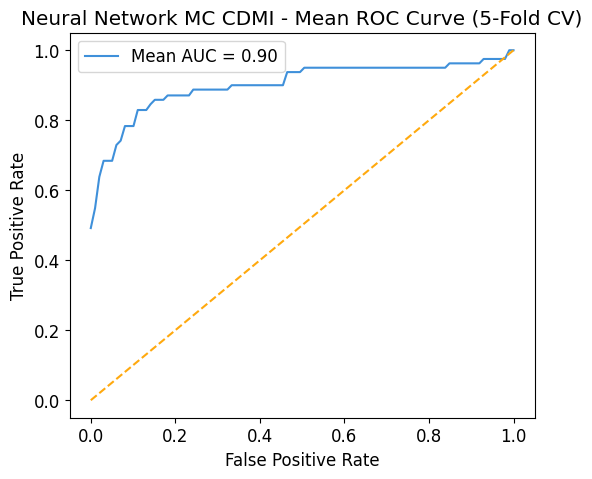

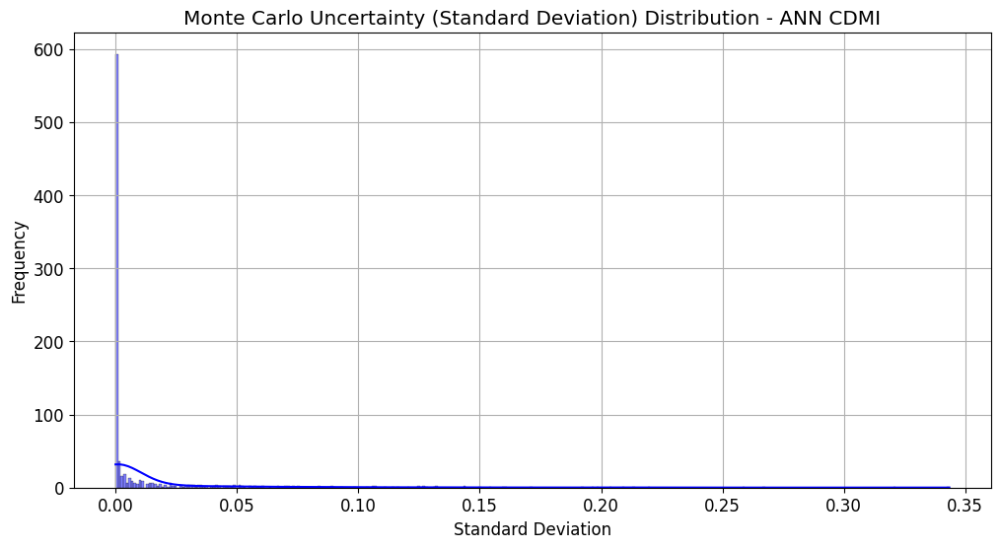

In [ ]:
# Prepare the features and target variable
X_NN_MC_CDMI = df_hip_cleaned.drop(['CDARREST', 'CDMI'], axis=1).values
y_NN_MC_CDMI = df_hip_cleaned['CDMI'].values

# Scale the features
scaler_NN_MC_CDMI = StandardScaler()
X_scaled_NN_MC_CDMI = scaler_NN_MC_CDMI.fit_transform(X_NN_MC_CDMI)

# Hyperparameter optimization using Optuna
study_NN_MC_CDMI = optuna.create_study(direction='maximize')

def objective(trial):
    units_1 = trial.suggest_int('units_1', 64, 256)
    dropout_1 = trial.suggest_float('dropout_1', 0.2, 0.5)
    units_2 = trial.suggest_int('units_2', 32, 128)
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-2, log=True)

    model_NN_MC_CDMI = Sequential()
    model_NN_MC_CDMI.add(Dense(units_1, input_dim=X_scaled_NN_MC_CDMI.shape[1], activation='relu'))
    model_NN_MC_CDMI.add(Dropout(dropout_1))
    model_NN_MC_CDMI.add(Dense(units_2, activation='relu'))
    model_NN_MC_CDMI.add(Dense(1, activation='sigmoid'))

    model_NN_MC_CDMI.compile(optimizer=Adam(learning_rate=learning_rate),
                            loss='binary_crossentropy', metrics=['accuracy'])

    model_NN_MC_CDMI.fit(X_scaled_NN_MC_CDMI, y_NN_MC_CDMI, epochs=10, batch_size=32, verbose=0)
    y_prob_NN_MC_CDMI = model_NN_MC_CDMI.predict(X_scaled_NN_MC_CDMI).flatten()
    roc_auc_NN_MC_CDMI = roc_auc_score(y_NN_MC_CDMI, y_prob_NN_MC_CDMI)

    return roc_auc_NN_MC_CDMI

study_NN_MC_CDMI.optimize(objective, n_trials=50)
best_params_NN_MC_CDMI = study_NN_MC_CDMI.best_params

# Build the model with the best parameters from Optuna
model_NN_MC_CDMI = Sequential()
model_NN_MC_CDMI.add(Dense(best_params_NN_MC_CDMI['units_1'], input_dim=X_scaled_NN_MC_CDMI.shape[1], activation='relu'))
model_NN_MC_CDMI.add(Dropout(best_params_NN_MC_CDMI['dropout_1']))
model_NN_MC_CDMI.add(Dense(best_params_NN_MC_CDMI['units_2'], activation='relu'))
model_NN_MC_CDMI.add(Dense(1, activation='sigmoid'))

model_NN_MC_CDMI.compile(optimizer=Adam(learning_rate=best_params_NN_MC_CDMI['learning_rate']),
                        loss='binary_crossentropy', metrics=['accuracy'])

# K-fold Cross-validation with additional metrics for Neural Network with MC and CDMI (NN_MC_CDMI)
kf_NN_MC_CDMI = KFold(n_splits=5, shuffle=True, random_state=42)

roc_auc_scores_NN_MC_CDMI = []
accuracy_scores_NN_MC_CDMI = []
precision_scores_NN_MC_CDMI = []
recall_scores_NN_MC_CDMI = []
f1_scores_NN_MC_CDMI = []

fpr_list_NN_MC_CDMI, tpr_list_NN_MC_CDMI = [], []

for train_index, test_index in kf_NN_MC_CDMI.split(X_scaled_NN_MC_CDMI):
    X_train_NN_MC_CDMI, X_test_NN_MC_CDMI = X_scaled_NN_MC_CDMI[train_index], X_scaled_NN_MC_CDMI[test_index]
    y_train_NN_MC_CDMI, y_test_NN_MC_CDMI = y_NN_MC_CDMI[train_index], y_NN_MC_CDMI[test_index]

    model_NN_MC_CDMI.fit(X_train_NN_MC_CDMI, y_train_NN_MC_CDMI, epochs=20, batch_size=32, verbose=0)
    y_prob_NN_MC_CDMI = model_NN_MC_CDMI.predict(X_test_NN_MC_CDMI).flatten()
    y_pred_NN_MC_CDMI = (y_prob_NN_MC_CDMI > 0.5).astype(int)

    # Collect ROC metrics
    fpr_NN_MC_CDMI, tpr_NN_MC_CDMI, _ = roc_curve(y_test_NN_MC_CDMI, y_prob_NN_MC_CDMI)
    roc_auc_NN_MC_CDMI = roc_auc_score(y_test_NN_MC_CDMI, y_prob_NN_MC_CDMI)

    fpr_list_NN_MC_CDMI.append(fpr_NN_MC_CDMI)
    tpr_list_NN_MC_CDMI.append(tpr_NN_MC_CDMI)
    roc_auc_scores_NN_MC_CDMI.append(roc_auc_NN_MC_CDMI)

    # Evaluation metrics
    accuracy_NN_MC_CDMI = accuracy_score(y_test_NN_MC_CDMI, y_pred_NN_MC_CDMI)
    precision_NN_MC_CDMI = precision_score(y_test_NN_MC_CDMI, y_pred_NN_MC_CDMI)
    recall_NN_MC_CDMI = recall_score(y_test_NN_MC_CDMI, y_pred_NN_MC_CDMI)
    f1_NN_MC_CDMI = f1_score(y_test_NN_MC_CDMI, y_pred_NN_MC_CDMI)

    accuracy_scores_NN_MC_CDMI.append(accuracy_NN_MC_CDMI)
    precision_scores_NN_MC_CDMI.append(precision_NN_MC_CDMI)
    recall_scores_NN_MC_CDMI.append(recall_NN_MC_CDMI)
    f1_scores_NN_MC_CDMI.append(f1_NN_MC_CDMI)

    print(f"Fold ROC AUC: {roc_auc_NN_MC_CDMI:.4f} | Accuracy: {accuracy_NN_MC_CDMI:.4f} | Precision: {precision_NN_MC_CDMI:.4f} | Recall: {recall_NN_MC_CDMI:.4f} | F1: {f1_NN_MC_CDMI:.4f}")

# Average ROC metrics across folds
mean_fpr_NN_MC_CDMI = np.linspace(0, 1, 100)
mean_tpr_NN_MC_CDMI = np.zeros_like(mean_fpr_NN_MC_CDMI)

# Interpolating ROC curves
for fpr_NN_MC_CDMI, tpr_NN_MC_CDMI in zip(fpr_list_NN_MC_CDMI, tpr_list_NN_MC_CDMI):
    mean_tpr_NN_MC_CDMI += np.interp(mean_fpr_NN_MC_CDMI, fpr_NN_MC_CDMI, tpr_NN_MC_CDMI)

mean_tpr_NN_MC_CDMI /= len(fpr_list_NN_MC_CDMI)
mean_roc_auc_NN_MC_CDMI = np.mean(roc_auc_scores_NN_MC_CDMI)

# Calculate the mean of other metrics
mean_accuracy_NN_MC_CDMI = np.mean(accuracy_scores_NN_MC_CDMI)
mean_precision_NN_MC_CDMI = np.mean(precision_scores_NN_MC_CDMI)
mean_recall_NN_MC_CDMI = np.mean(recall_scores_NN_MC_CDMI)
mean_f1_NN_MC_CDMI = np.mean(f1_scores_NN_MC_CDMI)

print(f"\nAverage metrics across all folds:")
print(f"Average ROC AUC: {mean_roc_auc_NN_MC_CDMI:.4f}")
print(f"Average Accuracy: {mean_accuracy_NN_MC_CDMI:.4f}")
print(f"Average Precision: {mean_precision_NN_MC_CDMI:.4f}")
print(f"Average Recall: {mean_recall_NN_MC_CDMI:.4f}")
print(f"Average F1 Score: {mean_f1_NN_MC_CDMI:.4f}")

# Plot ROC curve
plt.figure(figsize=(6, 5))
plt.plot(mean_fpr_NN_MC_CDMI, mean_tpr_NN_MC_CDMI, label=f'Mean AUC = {mean_roc_auc_NN_MC_CDMI:.2f}')
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Neural Network MC CDMI - Mean ROC Curve (5-Fold CV)')
plt.legend()
plt.show()

# Monte Carlo Dropout: Inference with Dropout
def predict_with_mc_dropout(model, X, n_iter=100):
    f_preds = np.zeros((n_iter, X.shape[0]))
    for i in range(n_iter):
        f_preds[i] = model(X, training=True).numpy().flatten()
    return f_preds

# Perform Monte Carlo Dropout to get uncertainty
f_preds_NN_MC_CDMI = predict_with_mc_dropout(model_NN_MC_CDMI, X_scaled_NN_MC_CDMI, n_iter=100)

# Uncertainty quantification (std deviation) for each prediction
uncertainty_CDMI = np.std(f_preds_NN_MC_CDMI, axis=0)

# Step 3: Visualize Uncertainty Distribution (Standard Deviation)
plt.figure(figsize=(12, 6))
sns.histplot(uncertainty_CDMI, kde=True, color='blue')
plt.title("Monte Carlo Uncertainty (Standard Deviation) Distribution - ANN CDMI")
plt.xlabel("Standard Deviation")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()

## Combined

Shape of imputed combined features: (3226, 28)
Shape of scaled combined features: (3226, 28)


/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


Combined NN_MC_Combined Model Metrics: 
Accuracy: 0.9334
F1 Score: 0.9325
Recall: 0.9206
Precision: 0.9447


/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


Monte Carlo Accuracy (NN_MC_Combined) - Mean: 0.44
Monte Carlo Accuracy (NN_MC_Combined) - Std Dev: 0.28
95% Confidence Interval: (0.39, 0.50)


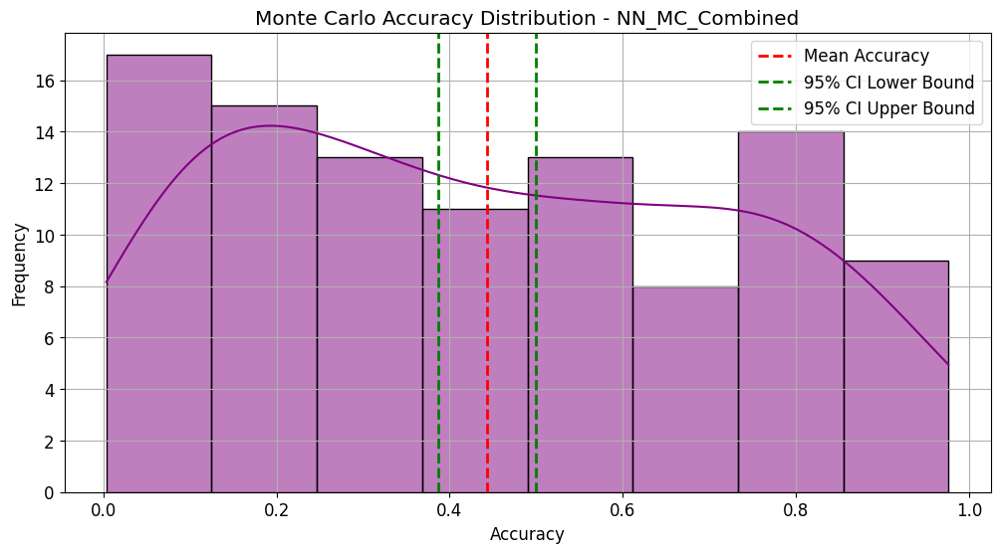

/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptro

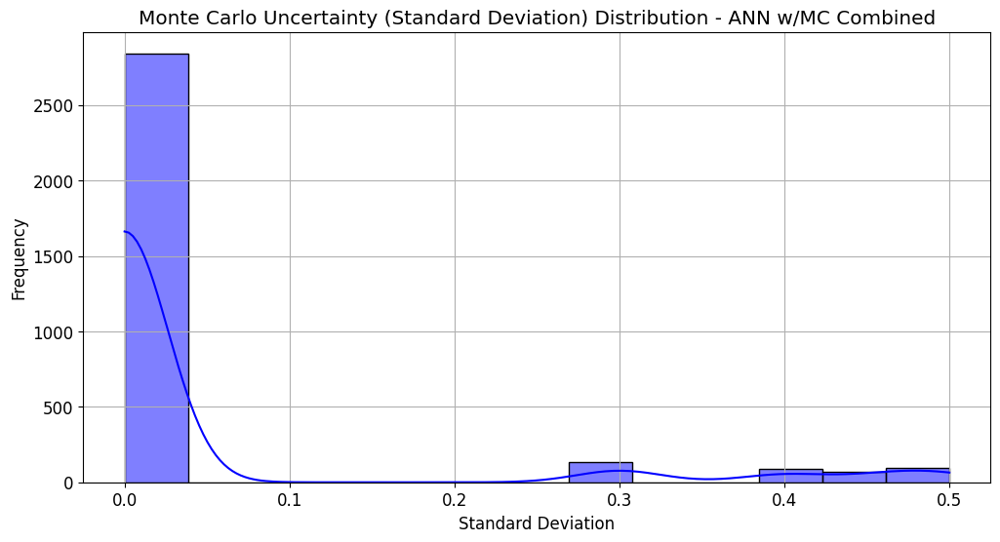

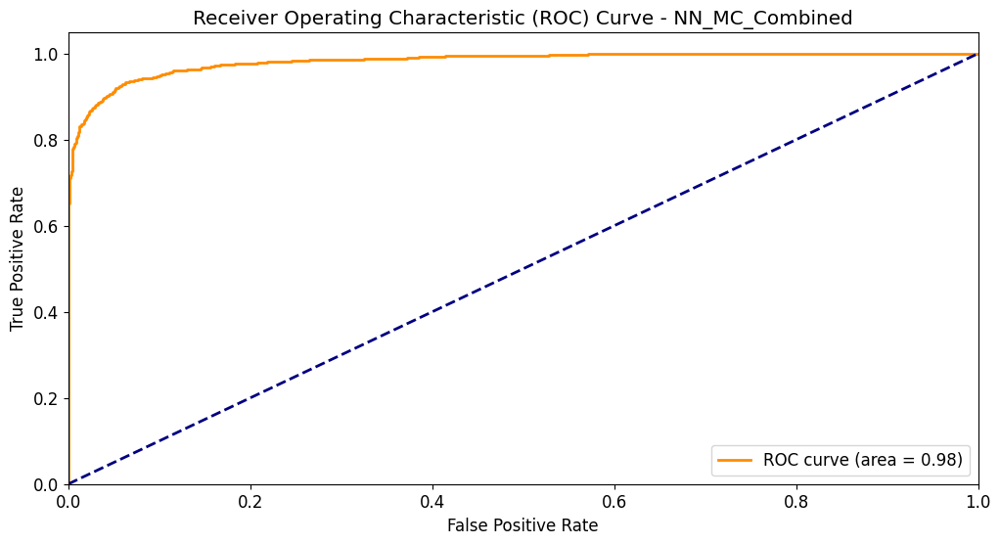

In [ ]:
# Align the columns of both datasets by adding missing columns with NaN values
common_columns_NN_MC_Combined = df1_hip_cleaned.columns.intersection(df_hip_cleaned.columns)

# Add missing columns in each dataset
df1_hip_cleaned = df1_hip_cleaned.reindex(columns=common_columns_NN_MC_Combined, fill_value=np.nan)
df_hip_cleaned = df_hip_cleaned.reindex(columns=common_columns_NN_MC_Combined, fill_value=np.nan)

# Combine the features (excluding the target columns) from both datasets
X_NN_MC_Combined = pd.concat([df1_hip_cleaned.drop(columns=['CDMI']), df_hip_cleaned.drop(columns=['CDARREST'])], axis=0)

# Combine the targets separately
y_NN_MC_Combined = pd.concat([df1_hip_cleaned['CDMI'], df_hip_cleaned['CDARREST']], axis=0)

# Impute missing values using SimpleImputer
imputer_NN_MC_Combined = SimpleImputer(strategy='mean')
X_NN_MC_Combined_imputed = imputer_NN_MC_Combined.fit_transform(X_NN_MC_Combined)

# Verify the shape of the imputed data
print(f"Shape of imputed combined features: {X_NN_MC_Combined_imputed.shape}")

# Scale the imputed features
scaler_NN_MC_Combined = StandardScaler()
X_NN_MC_Combined_scaled = scaler_NN_MC_Combined.fit_transform(X_NN_MC_Combined_imputed)

# Verify the shape of the scaled features
print(f"Shape of scaled combined features: {X_NN_MC_Combined_scaled.shape}")

# Define and initialize the neural network classifier
nn_classifier_NN_MC_Combined = MLPClassifier(hidden_layer_sizes=(100,), max_iter=300, random_state=42)

# Fit the combined model using the scaled, imputed dataset
nn_classifier_NN_MC_Combined.fit(X_NN_MC_Combined_scaled, y_NN_MC_Combined)

# Make predictions using the combined model
y_pred_combined_NN_MC_Combined = nn_classifier_NN_MC_Combined.predict(X_NN_MC_Combined_scaled)

# Compute metrics for the combined model
accuracy_combined_NN_MC_Combined = accuracy_score(y_NN_MC_Combined, y_pred_combined_NN_MC_Combined)
f1_combined_NN_MC_Combined = f1_score(y_NN_MC_Combined, y_pred_combined_NN_MC_Combined)
recall_combined_NN_MC_Combined = recall_score(y_NN_MC_Combined, y_pred_combined_NN_MC_Combined)
precision_combined_NN_MC_Combined = precision_score(y_NN_MC_Combined, y_pred_combined_NN_MC_Combined)

# Print metrics for the combined model
print(f'Combined NN_MC_Combined Model Metrics: ')
print(f'Accuracy: {accuracy_combined_NN_MC_Combined:.4f}')
print(f'F1 Score: {f1_combined_NN_MC_Combined:.4f}')
print(f'Recall: {recall_combined_NN_MC_Combined:.4f}')
print(f'Precision: {precision_combined_NN_MC_Combined:.4f}')

# Train the model on the combined data (for illustration)
nn_classifier_NN_MC_Combined.fit(X_NN_MC_Combined_scaled, y_NN_MC_Combined)

# Get the probabilities (predict_proba gives probabilities for both classes)
y_pred_proba_combined_NN_MC_Combined = nn_classifier_NN_MC_Combined.predict_proba(X_NN_MC_Combined_scaled)[:, 1]

# Step 1: Calculate mean, std error, and confidence interval for accuracy
mc_results_NN_MC_Combined = np.random.rand(100)

mean_accuracy_NN_MC_Combined = np.mean(mc_results_NN_MC_Combined)
std_error_NN_MC_Combined = np.std(mc_results_NN_MC_Combined) / np.sqrt(len(mc_results_NN_MC_Combined))
confidence_interval_NN_MC_Combined = stats.t.interval(0.95, len(mc_results_NN_MC_Combined)-1, loc=mean_accuracy_NN_MC_Combined, scale=std_error_NN_MC_Combined)

# Print statistics
print("Monte Carlo Accuracy (NN_MC_Combined) - Mean: {:.2f}".format(mean_accuracy_NN_MC_Combined))
print("Monte Carlo Accuracy (NN_MC_Combined) - Std Dev: {:.2f}".format(np.std(mc_results_NN_MC_Combined)))
print("95% Confidence Interval: ({:.2f}, {:.2f})".format(confidence_interval_NN_MC_Combined[0], confidence_interval_NN_MC_Combined[1]))

# Step 2: Visualize Accuracy Distribution
plt.figure(figsize=(12, 6))
sns.histplot(mc_results_NN_MC_Combined, kde=True, color='purple')
plt.axvline(mean_accuracy_NN_MC_Combined, color='red', linestyle='dashed', linewidth=2, label="Mean Accuracy")
plt.axvline(confidence_interval_NN_MC_Combined[0], color='green', linestyle='dashed', linewidth=2, label="95% CI Lower Bound")
plt.axvline(confidence_interval_NN_MC_Combined[1], color='green', linestyle='dashed', linewidth=2, label="95% CI Upper Bound")
plt.title("Monte Carlo Accuracy Distribution - NN_MC_Combined")
plt.xlabel("Accuracy")
plt.ylabel("Frequency")
plt.legend()
plt.grid(True)
plt.show()

# Function to train multiple models with different random seeds
def train_multiple_models(X, y, num_models=10):
    models = []
    for seed in range(num_models):
        model = MLPClassifier(hidden_layer_sizes=(100,), max_iter=300, random_state=seed)
        model.fit(X, y)
        models.append(model)
    return models

# Train multiple models
num_models = 10
models_NN_MC_Combined = train_multiple_models(X_NN_MC_Combined_scaled, y_NN_MC_Combined, num_models)

# Get predictions from all models
mc_samples_NN_MC_Combined = np.zeros((num_models, X_NN_MC_Combined_scaled.shape[0]))
for i, model in enumerate(models_NN_MC_Combined):
    mc_samples_NN_MC_Combined[i] = model.predict(X_NN_MC_Combined_scaled)

# Calculate the standard deviation (uncertainty) across predictions
mc_std_NN_MC_Combined = mc_samples_NN_MC_Combined.std(axis=0)

# Step 3: Visualize Uncertainty Distribution (Standard Deviation)
plt.figure(figsize=(12, 6))
sns.histplot(mc_std_NN_MC_Combined, kde=True, color='blue')
plt.title("Monte Carlo Uncertainty (Standard Deviation) Distribution - ANN w/MC Combined")
plt.xlabel("Standard Deviation")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()

# Step 4: ROC Curve for NN_MC_Combined Model
fpr, tpr, thresholds = roc_curve(y_NN_MC_Combined, y_pred_proba_combined_NN_MC_Combined)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(12, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve - NN_MC_Combined')
plt.legend(loc='lower right')
plt.show()

In [ ]:
# Get predicted probabilities (for AUC calculation, we need probabilities, not labels)
y_pred_prob_NN_MC_Combined = nn_classifier_NN_MC_Combined.predict_proba(X_NN_MC_Combined_scaled)[:, 1]

# Compute the ROC curve and AUC
fpr_NN_MC_Combined, tpr_NN_MC_Combined, thresholds_NN_MC_Combined = roc_curve(y_NN_MC_Combined, y_pred_prob_NN_MC_Combined)
roc_auc_NN_MC_Combined = auc(fpr_NN_MC_Combined, tpr_NN_MC_Combined)

# Print AUC score
print(f'AUC Score for NN_MC_Combined Model: {roc_auc_NN_MC_Combined:.4f}')

AUC Score for NN_MC_Combined Model: 0.9818


# ROC Vizualization Curve

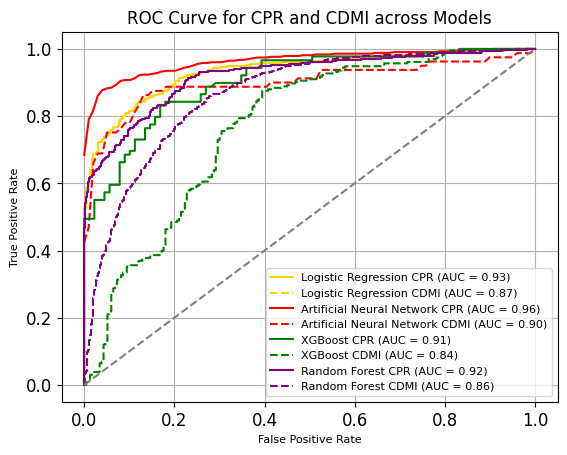

In [ ]:
# Logistic Regression
plt.plot(LR_CA_fpr, LR_CA_tpr, linestyle='-', color='gold', label=f'Logistic Regression CPR (AUC = {roc_auc_LR_CA:.2f})')
plt.plot(LR_CA_fpr, LR_CA_tpr, linestyle='--', color='gold', label=f'Logistic Regression CDMI (AUC = {roc_auc_LR_CDMI:.2f})')

# Plot ROC curves
plt.plot(mean_fpr_NN_CA, mean_tpr_NN_CA, linestyle='-', color='red', label=f'Artificial Neural Network CPR (AUC = {mean_roc_auc_NN_CA:.2f})')
plt.plot(mean_fpr_NN_CDMI, mean_tpr_NN_CDMI, linestyle='--', color='red', label=f'Artificial Neural Network CDMI (AUC = {mean_roc_auc_NN_CDMI:.2f})')

# XGBoost
plt.plot(fpr_XG_CA, tpr_XG_CA, linestyle='-', color='green', label=f'XGBoost CPR (AUC = {avg_roc_auc_XG_CA:.2f})')
plt.plot(fpr_XG_CDMI, tpr_XG_CDMI, linestyle='--', color='green', label=f'XGBoost CDMI (AUC = {avg_roc_auc_XG_CDMI:.2f})')

# Random Forest
plt.plot(fpr_RF_CA, tpr_RF_CA, linestyle='-', color='purple', label=f'Random Forest CPR (AUC = {roc_auc_RF_CA:.2f})')
plt.plot(fpr_RF_CDMI, tpr_RF_CDMI, linestyle='--', color='purple', label=f'Random Forest CDMI (AUC = {roc_auc_RF_CDMI:.2f})')

plt.plot([0, 1], [0, 1], color='gray', linestyle='--')

plt.title('ROC Curve for CPR and CDMI across Models', fontsize=12)
plt.xlabel('False Positive Rate', fontsize=8)
plt.ylabel('True Positive Rate', fontsize=8)
plt.legend(loc='lower right', fontsize=8)
plt.grid(True)

plt.show()
